
# Проект финальный по компьютерному зрению.
## Задача классификации изображений (фотографий) кожных образований на 3 заболевания: меланома, невус, себорейный кератоз


# 1. Импорт библиотек

In [1]:
import os      # Библиотека для работы с фаловой системой
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, accuracy_score, confusion_matrix, ConfusionMatrixDisplay
import cv2 as cv
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.transforms as transforms
from torch.utils.data import DataLoader, Dataset
from PIL import Image

import warnings
warnings.filterwarnings("ignore")

# 2. Загрузка датасетов и их обработка с приданием меток классов изображениям


In [3]:
# Загружаем датасет и проверяем структуру таблицы
train = pd.read_csv('/home/jupyter/datasphere/project/SkinProject/train_isic.csv')
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2000 entries, 0 to 1999
Data columns (total 3 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   image_id              2000 non-null   object 
 1   melanoma              2000 non-null   float64
 2   seborrheic_keratosis  2000 non-null   float64
dtypes: float64(2), object(1)
memory usage: 47.0+ KB


In [4]:
import os
#Создаем класс для трансформации таблицы, чтобы в столбец image_id добавить пути к картинкам, которым будут соответствовать метки классов
class TableTransformer:
    def __init__(self, base_path: str, file_extension: str = ".jpg"):
        self.base_path = base_path
        self.file_extension = file_extension
        
    def _validate_file_exists(self, file_path: str):
        """Проверка существования файла"""
        if not os.path.exists(file_path):
            raise FileNotFoundError(f"Image file not found: {file_path}")
        return file_path
    
    def _get_full_path(self, image_name: str):
        """Генерация полного пути с проверкой"""
        full_path = os.path.join(self.base_path, f"{image_name}{self.file_extension}")
        return self._validate_file_exists(full_path)
    
    def transform(self, df: pd.DataFrame) -> pd.DataFrame:
        """Основной метод трансформации таблицы"""
        # Создаем копию таблицы
        transformed_df = df.copy()
        
        # Создаем и преобразуем столбец nevus
        transformed_df['nevus'] = transformed_df['melanoma'] + transformed_df['seborrheic_keratosis']
        transformed_df['nevus'] = np.where(
            transformed_df['nevus'] == 1, 
            0, 
            1
        )
        
        # Создаем столбец diagnosis
        conditions = [
            (transformed_df['melanoma'] == 1),
            (transformed_df['seborrheic_keratosis'] == 1),
            (transformed_df['nevus'] == 1)
        ]
        choices = ['melanoma', 'seborrheic_keratosis', 'nevus']
        transformed_df['diagnosis'] = np.select(conditions, choices, default='unknown')
        
        # Удаляем исходные столбцы
        transformed_df = transformed_df.drop(
            columns=['melanoma', 'seborrheic_keratosis', 'nevus']
        )
        
        # Заменяем названия файлов на полные пути с проверкой
        transformed_df['image_id'] = transformed_df['image_id'].apply(self._get_full_path)
        
        return transformed_df

In [5]:
#Загрузим таблицу test
test = pd.read_csv('/home/jupyter/datasphere/project/SkinProject/test_isic.csv')
test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 600 entries, 0 to 599
Data columns (total 3 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   image_id              600 non-null    object 
 1   melanoma              600 non-null    float64
 2   seborrheic_keratosis  600 non-null    float64
dtypes: float64(2), object(1)
memory usage: 14.2+ KB


In [6]:
#Загрузим таблицу valid
valid = pd.read_csv('/home/jupyter/datasphere/project/SkinProject/valid_isic.csv')
valid.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 150 entries, 0 to 149
Data columns (total 3 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   image_id              150 non-null    object 
 1   melanoma              150 non-null    float64
 2   seborrheic_keratosis  150 non-null    float64
dtypes: float64(2), object(1)
memory usage: 3.6+ KB


In [7]:
# Создадим тренировочную итоговую трансформированную таблицу
train_transformer = TableTransformer(
    base_path="/home/jupyter/datasphere/project/SkinProject/Train"
    )
train_transformed = train_transformer.transform(train)
    
# Создадим тестовую итоговую трансформированную таблицу
test_transformer = TableTransformer(
    base_path="/home/jupyter/datasphere/project/SkinProject/Test" 
    )
test_transformed = test_transformer.transform(test)

# Создадим валидационную итоговую трансформированную таблицу
valid_transformer = TableTransformer(
    base_path="/home/jupyter/datasphere/project/SkinProject/Valid"
    )
valid_transformed = valid_transformer.transform(valid)


In [8]:
import os
#Функция для проверки количества файлов в директории
def count_files(directory):
    if not os.path.exists(directory):
        return "Директория не существует"
    if not os.path.isdir(directory):
        return "Это не директория"
    files = [item for item in os.listdir(directory) if os.path.isfile(os.path.join(directory, item))]
    return len(files)

In [9]:
# Проверим количество файлов папках с картинками для выяснения ошибки несоответствия количества файлов
path = input("Введите путь к директории: ")
print(f"Количество файлов: {count_files(path)}")

Введите путь к директории:  /home/jupyter/datasphere/project/SkinProject/Train


Количество файлов: 2000


In [10]:
#Выведем на проверку 5 строк размеченной таблицы со ссылками на картинки
train_transformed.head(5)

,image_id,diagnosis
0,/home/jupyter/datasphere/project/SkinProject/T...,nevus
1,/home/jupyter/datasphere/project/SkinProject/T...,nevus
2,/home/jupyter/datasphere/project/SkinProject/T...,melanoma
3,/home/jupyter/datasphere/project/SkinProject/T...,nevus
4,/home/jupyter/datasphere/project/SkinProject/T...,melanoma


### 3. Эксплоративный анализ данных для train


#### 3.1 Распределение классов

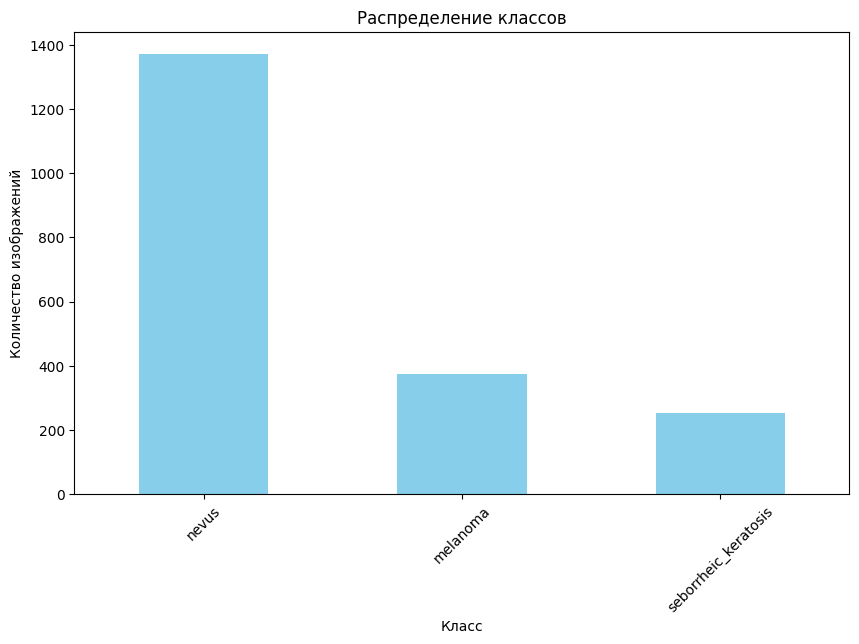

In [11]:

# 1. Распределение классов
plt.figure(figsize=(10, 6))
train_transformed['diagnosis'].value_counts().plot(kind='bar', color='skyblue')
plt.title('Распределение классов')
plt.xlabel('Класс')
plt.ylabel('Количество изображений')
plt.xticks(rotation=45)
plt.show()

Отмечается дисбаланс классов, что следует учитывать в дальнейшем анализе данных 

#### 3.2 Визуализация изображений по классам

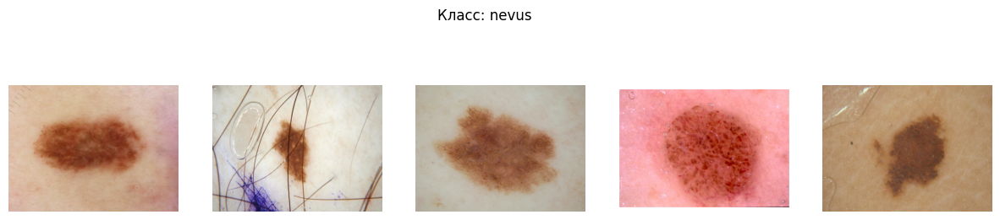

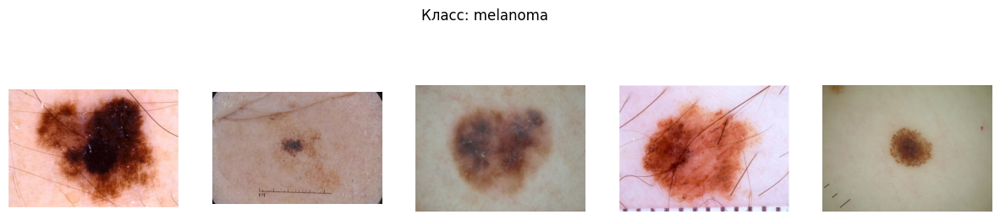

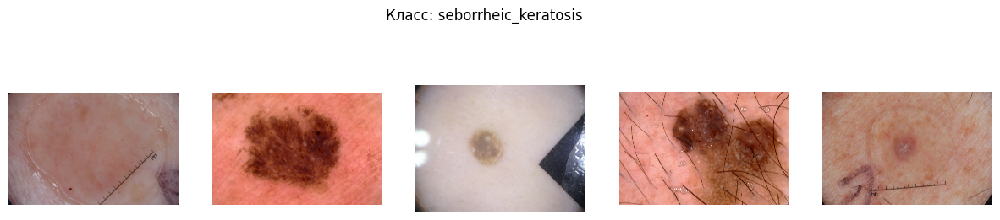

In [16]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import cv2
from PIL import Image
import os
# 2. Визуализация примеров изображений
#Создаем функцию для визуализации примеров изображений (необработанных)
def plot_samples(class_name, df, num_samples=5):
    class_samples = df[df['diagnosis'] == class_name]['image_id'].sample(num_samples)
    plt.figure(figsize=(15, 3))
    plt.suptitle(f'Класс: {class_name}', y=1.05)
    
    for i, path in enumerate(class_samples, 1):
        try:
            img = cv2.imread(path)
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            plt.subplot(1, num_samples, i)
            plt.imshow(img)
            plt.axis('off')
        except:
            print(f"Ошибка загрузки: {path}")
    plt.show()
#Проходимся циклом для визуализации изображений в каждом классе
for class_name in train_transformed['diagnosis'].unique():
    plot_samples(class_name, train_transformed)



#### 3.3 Анализ яркости, соотношения сторон картинок в общем датасете и по классам

In [12]:
# 3. Статистики изображений
#Создаем функцию, которая рассчитывает яркость изображения
def calculate_brightness(img):
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    return np.mean(gray)
#Создаем списки, где будем хранить параметры изображений и класс для описания статистик
stats = {
    'width': [],
    'height': [],
    'brightness': [],
    'class': []
}
#Проходим циклом по таблице, собирая статистики по каждому изображению (строка в таблице)
#Добавляем исключение на случай, если изображение криво обрабатывается
for idx, row in train_transformed.iterrows():
    try:
        img = Image.open(row['image_id'])
        img_np = np.array(img)
        
        # Размеры изображения
        width, height = img.size
        
        # Яркость
        brightness = calculate_brightness(img_np)
        
        # Сохраняем статистику
        stats['width'].append(width)
        stats['height'].append(height)
        stats['brightness'].append(brightness)
        stats['class'].append(row['diagnosis'])
    except:
        print(f"Ошибка обработки: {row['image_id']}")
#Собираем данные в таблицу с общей статистикой
stats_df = pd.DataFrame(stats)

# Общая статистика
print("\nОбщая статистика:")
print(f"Средняя яркость: {stats_df['brightness'].mean():.2f}")
print(f"Средний размер: {stats_df['width'].mean():.1f}x{stats_df['height'].mean():.1f}")
print(f"Вариативность размеров (std): {stats_df[['width', 'height']].std().values}")

# Статистика по классам
print("\nСтатистика по классам:")
for class_name in stats_df['class'].unique():
    class_stats = stats_df[stats_df['class'] == class_name]
    print(f"\nКласс {class_name}:")
    print(f"• Изображений: {len(class_stats)}")
    print(f"• Средняя яркость: {class_stats['brightness'].mean():.2f}")
    print(f"• Средний размер: {class_stats['width'].mean():.1f}x{class_stats['height'].mean():.1f}")
    print(f"• STD размеров: {class_stats[['width', 'height']].std().values}")


Общая статистика:
Средняя яркость: 158.43
Средний размер: 2734.3x1877.7
Вариативность размеров (std): [1682.31403531 1081.41983869]

Статистика по классам:

Класс nevus:
• Изображений: 1372
• Средняя яркость: 161.24
• Средний размер: 2545.9x1752.5
• STD размеров: [1665.99221273 1070.49315023]

Класс melanoma:
• Изображений: 374
• Средняя яркость: 152.47
• Средний размер: 2715.1x1876.9
• STD размеров: [1760.43733872 1133.44296589]

Класс seborrheic_keratosis:
• Изображений: 254
• Средняя яркость: 152.00
• Средний размер: 3780.2x2554.8
• STD размеров: [1208.64133838  768.77760136]


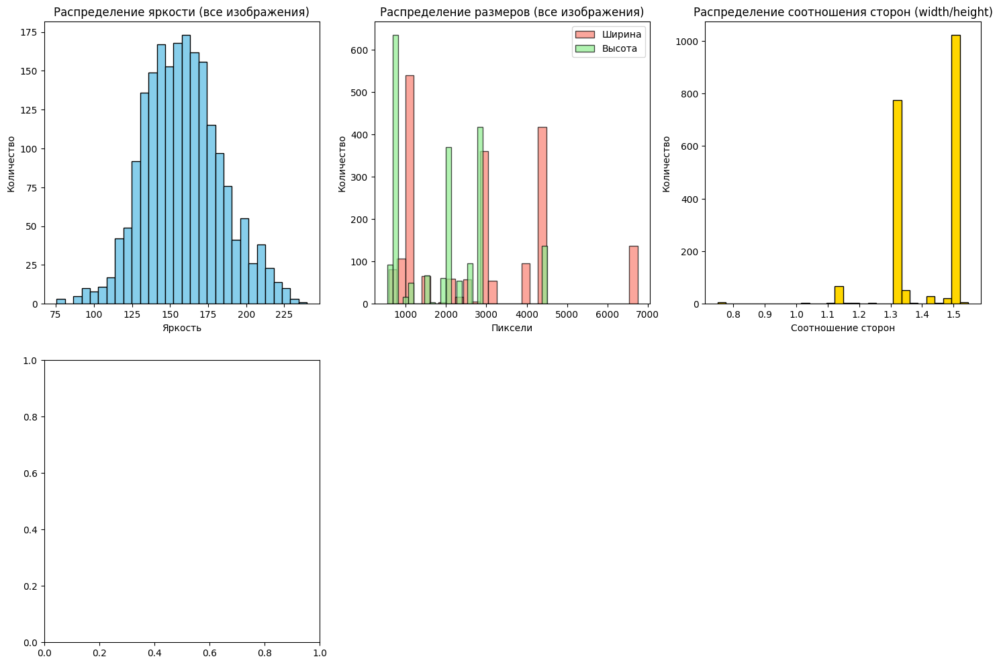

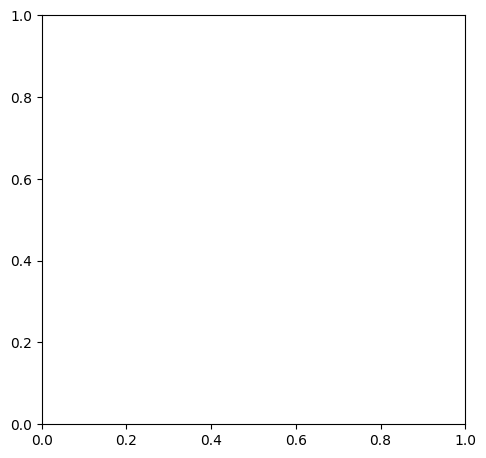

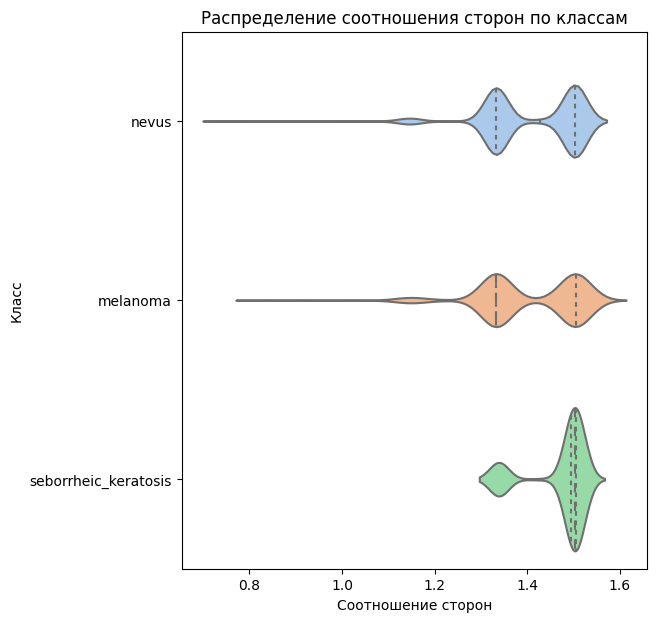

In [13]:
# Визуализация распределения статистик соотношения сторон и яркости изображений
plt.figure(figsize=(18, 12))

# Общие распределения
plt.subplot(2, 3, 1)
plt.hist(stats_df['brightness'], bins=30, color='skyblue', edgecolor='black')
plt.title('Распределение яркости (все изображения)')
plt.xlabel('Яркость')
plt.ylabel('Количество')

plt.subplot(2, 3, 2)
plt.hist(stats_df['width'], bins=30, color='salmon', edgecolor='black', alpha=0.7, label='Ширина')
plt.hist(stats_df['height'], bins=30, color='lightgreen', edgecolor='black', alpha=0.7, label='Высота')
plt.title('Распределение размеров (все изображения)')
plt.xlabel('Пиксели')
plt.ylabel('Количество')
plt.legend()

# Распределение соотношения сторон
plt.subplot(2, 3, 3)
stats_df['aspect_ratio'] = stats_df['width'] / stats_df['height']
plt.hist(stats_df['aspect_ratio'], bins=30, color='gold', edgecolor='black')
plt.title('Распределение соотношения сторон (width/height)')
plt.xlabel('Соотношение сторон')
plt.ylabel('Количество')

# Boxplot по классам для яркости
plt.subplot(2, 3, 4)
stats_df.boxplot(column='brightness', by='class', vert=False, patch_artist=True,
                 boxprops=dict(facecolor='lightblue'), figsize=(18,12))
plt.title('Распределение яркости по классам')
plt.suptitle('')
plt.xlabel('Яркость')
plt.ylabel('Класс')

# Boxplot по классам для размеров
plt.subplot(2, 3, 5)
stats_df['diagonal'] = np.sqrt(stats_df['width']**2 + stats_df['height']**2)
stats_df.boxplot(column='diagonal', by='class', vert=False, patch_artist=True,
                 boxprops=dict(facecolor='lightgreen'), figsize=(18,12))
plt.title('Распределение диагонали изображений по классам')
plt.suptitle('')
plt.xlabel('Диагональ (пиксели)')
plt.ylabel('Класс')

# Violin plot для соотношения сторон
plt.subplot(2, 3, 6)
import seaborn as sns
sns.violinplot(x='aspect_ratio', y='class', data=stats_df, 
               palette='pastel', inner='quartile')
plt.title('Распределение соотношения сторон по классам')
plt.xlabel('Соотношение сторон')
plt.ylabel('Класс')

plt.tight_layout()
plt.show()

По результатам анализа изображений видим, что соотношение сторон, в основном, составляет 1.3-1.6, в классе себорейного кератоза картинки наиболее несбалансированы по высоте и ширине.
Выясним, какие изображения имеют большие размеры

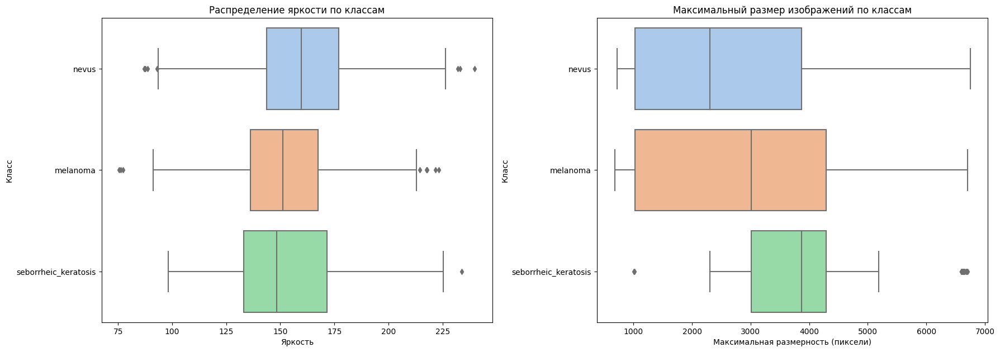


Всего изображений размером более 5000 пикселей: 138
Это составляет 6.90% от всего датасета

Распределение больших изображений по классам:
class
melanoma                27
nevus                   83
seborrheic_keratosis    28
dtype: int64


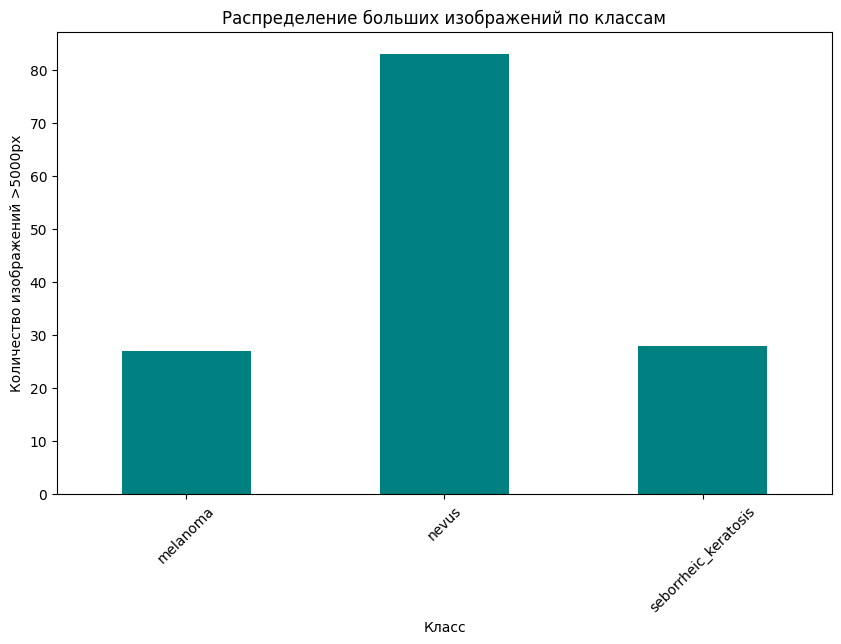

In [14]:
# 1. Исправленные боксплоты
plt.figure(figsize=(18, 12))

# Boxplot для яркости по классам
plt.subplot(2, 2, 1)
sns.boxplot(y='class', x='brightness', data=stats_df, palette='pastel')
plt.title('Распределение яркости по классам')
plt.xlabel('Яркость')
plt.ylabel('Класс')

# Boxplot для размеров по классам
plt.subplot(2, 2, 2)
stats_df['max_dimension'] = stats_df[['width', 'height']].max(axis=1)
sns.boxplot(y='class', x='max_dimension', data=stats_df, palette='pastel')
plt.title('Максимальный размер изображений по классам')
plt.xlabel('Максимальная размерность (пиксели)')
plt.ylabel('Класс')

plt.tight_layout()
plt.show()

# 2. Проверка изображений с размером более 5000 пикселей
# Добавим столбец с флагом больших изображений
stats_df['large_image'] = (stats_df['width'] > 5000) | (stats_df['height'] > 5000)

# Общая статистика
total_large = stats_df['large_image'].sum()
print(f"\nВсего изображений размером более 5000 пикселей: {total_large}")
print(f"Это составляет {total_large/len(stats_df)*100:.2f}% от всего датасета")

# Распределение по классам
if total_large > 0:
    class_distribution = stats_df[stats_df['large_image']].groupby('class').size()
    print("\nРаспределение больших изображений по классам:")
    print(class_distribution)
else:
    print("\nИзображений размером более 5000 пикселей не найдено")

# Дополнительная визуализация для больших изображений
if total_large > 0:
    plt.figure(figsize=(10, 6))
    class_distribution.plot(kind='bar', color='teal')
    plt.title('Распределение больших изображений по классам')
    plt.xlabel('Класс')
    plt.ylabel('Количество изображений >5000px')
    plt.xticks(rotation=45)
    plt.show()

#### 3.4 Удаление ненужных данных, визуализация данных после их удаления
Видим дисбаланс по количеству больших изображений и наличие выбросов особенно в классе себорейного кератоза. Максимально безболезненно для отсутствия больших потерь в данных уберем из данных ненужные картинки. 
Это будут:
- все изображения размерами более 6000 пикселей, выброс в классе себорейного кератоза, где изображение занимает 1000 пикселей.
- все изображения с якростью более 230 и менее 90 


Начинаем обработку изображений...
Обработка изображений завершена.

Результаты фильтрации:
Изначальное количество изображений: 2000
Осталось после фильтрации: 1851
Удалено записей: 149


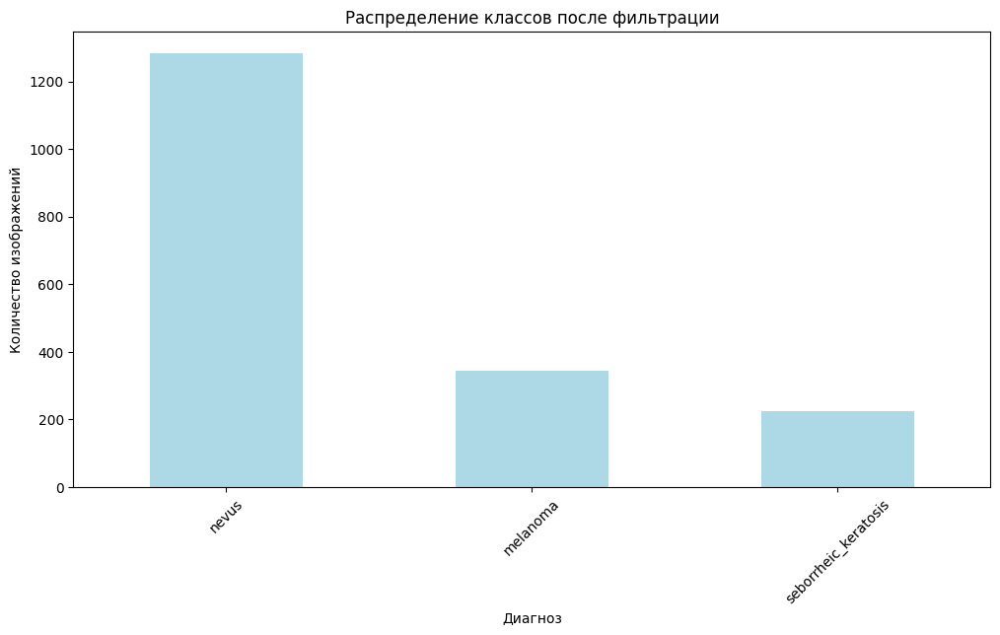


Отфильтрованные данные сохранены в файл: train_new.csv

Проверка максимальных размеров:
Максимальная ширина: 5184.0
Максимальная высота: 3456.0

Проверка диапазона яркости:
Минимальная яркость: 91.23
Максимальная яркость: 226.43


In [17]:
# Функция для получения характеристик изображения
train_new = train_transformed.copy()
def get_image_stats(row):
    try:
        img = Image.open(row['image_id'])
        width, height = img.size
        img_np = np.array(img)
        
        # Конвертация в grayscale для вычисления яркости
        if len(img_np.shape) == 3:
            gray = cv2.cvtColor(img_np, cv2.COLOR_RGB2GRAY)
        else:
            gray = img_np
            
        brightness = np.mean(gray)
        
        return pd.Series({
            'width': width,
            'height': height,
            'brightness': brightness
        })
    
    except Exception as e:
        print(f"Ошибка обработки {row['image_id']}: {str(e)}")
        return pd.Series({
            'width': np.nan,
            'height': np.nan,
            'brightness': np.nan
        })

# Добавляем характеристики изображений в исходную таблицу
print("Начинаем обработку изображений...")
train_new[['width', 'height', 'brightness']] = train_new.apply(get_image_stats, axis=1)
print("Обработка изображений завершена.")

# Фильтрация данных
initial_count = len(train_new)

# 1. Фильтр по размеру (<= 6000 пикселей)
train_new = train_new[(train_new['width'] <= 6000) & (train_new['height'] <= 6000)]

# 2. Удаление выброса в себорейном кератозе (1000 пикселей)
train_new = train_new[~(
    (train_new['diagnosis'] == 'seborrheic_keratosis') & 
    ((train_new['width'] < 1200) | (train_new['height'] < 1200))
)]

# 3. Фильтр по яркости (90 <= brightness <= 230)
train_new = train_new[(train_new['brightness'] >= 90) & (train_new['brightness'] <= 230)]

# Удаление строк с ошибками обработки
train_new = train_new.dropna(subset=['width', 'height', 'brightness'])

# Анализ результатов
final_count = len(train_new)
print(f"\nРезультаты фильтрации:")
print(f"Изначальное количество изображений: {initial_count}")
print(f"Осталось после фильтрации: {final_count}")
print(f"Удалено записей: {initial_count - final_count}")

# Визуализация нового распределения классов
plt.figure(figsize=(12, 6))
train_new['diagnosis'].value_counts().plot(kind='bar', color='lightblue')
plt.title('Распределение классов после фильтрации')
plt.xlabel('Диагноз')
plt.ylabel('Количество изображений')
plt.xticks(rotation=45)
plt.show()

# Сохранение новой таблицы
output_filename = 'train_new.csv'
train_new.to_csv(output_filename, index=False)
print(f"\nОтфильтрованные данные сохранены в файл: {output_filename}")

# Дополнительные проверки
print("\nПроверка максимальных размеров:")
print(f"Максимальная ширина: {train_new['width'].max()}")
print(f"Максимальная высота: {train_new['height'].max()}")

print("\nПроверка диапазона яркости:")
print(f"Минимальная яркость: {train_new['brightness'].min():.2f}")
print(f"Максимальная яркость: {train_new['brightness'].max():.2f}")

Переделаем статистики по новому датасету

In [16]:
# 3. Статистики изображений
# Создаем функцию, которая рассчитывает яркость изображения
def calculate_brightness(img):
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    return np.mean(gray)

# Создаем списки, где будем хранить параметры изображений и класс для описания статистик
stats1 = {
    'width': [],
    'height': [],
    'brightness': [],
    'class': []
}

# Проходим циклом по таблице, собирая статистики по каждому изображению (строка в таблице)
# Добавляем исключение на случай, если изображение криво обрабатывается
for idx, row in train_new.iterrows():
    try:
        img = Image.open(row['image_id'])  # Исправлено на заглавную букву
        img_np = np.array(img)
        
        # Размеры изображения
        width, height = img.size
        
        # Яркость
        brightness = calculate_brightness(img_np)
        
        # Сохраняем статистику
        stats1['width'].append(width)
        stats1['height'].append(height)
        stats1['brightness'].append(brightness)
        stats1['class'].append(row['diagnosis'])
    except Exception as e:
        print(f"Ошибка обработки {row['Image_id']}: {str(e)}")  # Добавлено отображение ошибки

# Собираем данные в таблицу с общей статистикой
stats1_df = pd.DataFrame(stats1)

# Общая статистика
print("\nОбщая статистика:")
print(f"Средняя яркость: {stats1_df['brightness'].mean():.2f}")
print(f"Средний размер: {stats1_df['width'].mean():.1f}x{stats1_df['height'].mean():.1f}")
print(f"Вариативность размеров (std): {stats1_df[['width', 'height']].std().values}")

# Статистика по классам
print("\nСтатистика по классам:")
for class_name in stats1_df['class'].unique():
    class_stats = stats1_df[stats1_df['class'] == class_name]
    print(f"\nКласс {class_name}:")
    print(f"• Изображений: {len(class_stats)}")
    print(f"• Средняя яркость: {class_stats['brightness'].mean():.2f}")
    print(f"• Средний размер: {class_stats['width'].mean():.1f}x{class_stats['height'].mean():.1f}")
    print(f"• STD размеров: {class_stats[['width', 'height']].std().values}")


Общая статистика:
Средняя яркость: 159.19
Средний размер: 2452.0x1694.0
Вариативность размеров (std): [1351.56822067  861.30248598]

Статистика по классам:

Класс nevus:
• Изображений: 1283
• Средняя яркость: 161.76
• Средний размер: 2284.2x1582.1
• STD размеров: [1341.45692901  854.23615425]

Класс melanoma:
• Изображений: 344
• Средняя яркость: 153.43
• Средний размер: 2421.4x1686.7
• STD размеров: [1426.32272109  913.85507728]

Класс seborrheic_keratosis:
• Изображений: 224
• Средняя яркость: 153.31
• Средний размер: 3460.0x2346.3
• STD размеров: [704.36028286 418.53032268]


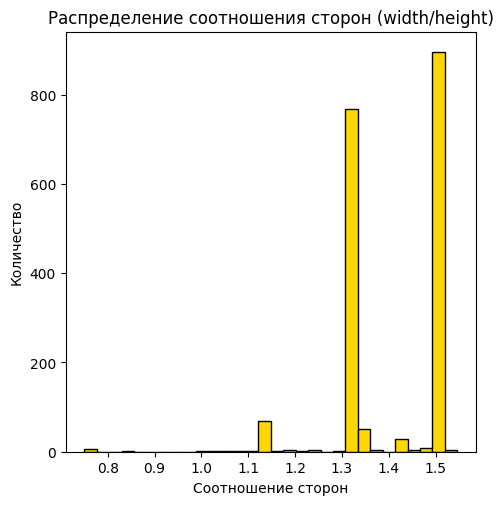

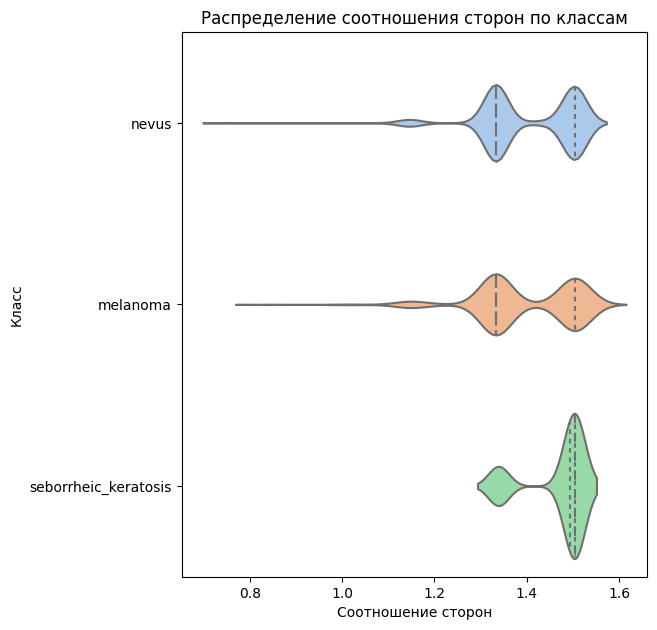

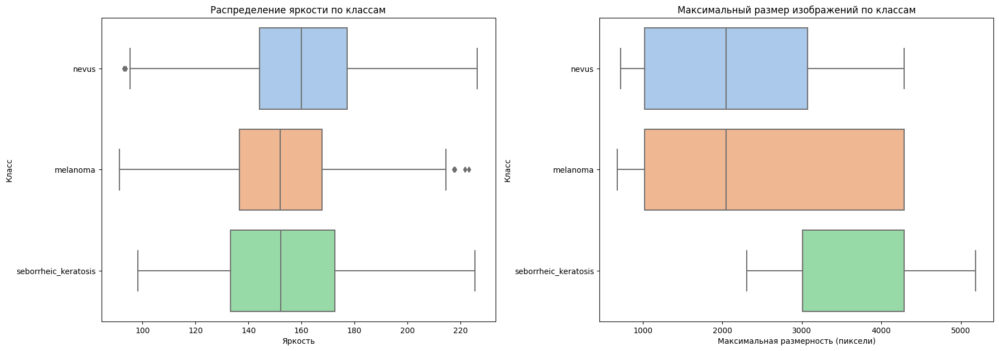


Всего изображений размером более 5000 пикселей: 1
Это составляет 0.05% от всего датасета

Распределение больших изображений по классам:
class
seborrheic_keratosis    1
dtype: int64


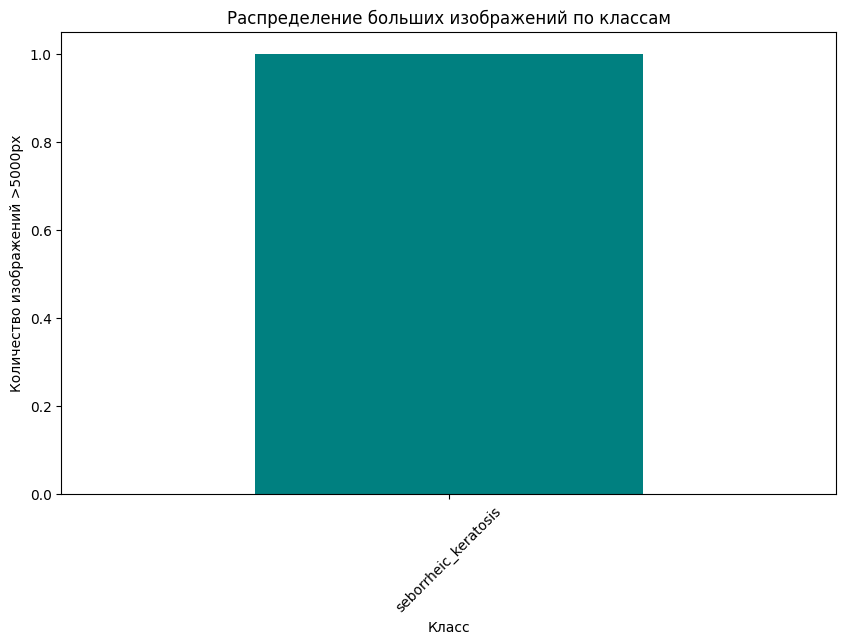

In [17]:
# Распределение соотношения сторон
plt.figure(figsize=(18, 12))

plt.subplot(2, 3, 3)
stats1_df['aspect_ratio'] = stats1_df['width'] / stats1_df['height']
plt.hist(stats1_df['aspect_ratio'], bins=30, color='gold', edgecolor='black')
plt.title('Распределение соотношения сторон (width/height)')
plt.xlabel('Соотношение сторон')
plt.ylabel('Количество')

# Violin plot для соотношения сторон
plt.figure(figsize=(18, 12))

plt.subplot(2, 3, 6)
import seaborn as sns
sns.violinplot(x='aspect_ratio', y='class', data=stats1_df, 
               palette='pastel', inner='quartile')
plt.title('Распределение соотношения сторон по классам')
plt.xlabel('Соотношение сторон')
plt.ylabel('Класс')

plt.tight_layout()
plt.show()

# 1. Боксплоты
plt.figure(figsize=(18, 12))

# Boxplot для яркости по классам
plt.subplot(2, 2, 1)
sns.boxplot(y='class', x='brightness', data=stats1_df, palette='pastel')
plt.title('Распределение яркости по классам')
plt.xlabel('Яркость')
plt.ylabel('Класс')

# Boxplot для размеров по классам
plt.subplot(2, 2, 2)
stats1_df['max_dimension'] = stats1_df[['width', 'height']].max(axis=1)
sns.boxplot(y='class', x='max_dimension', data=stats1_df, palette='pastel')
plt.title('Максимальный размер изображений по классам')
plt.xlabel('Максимальная размерность (пиксели)')
plt.ylabel('Класс')

plt.tight_layout()
plt.show()

# 2. Проверка изображений с размером более 5000 пикселей
# Добавим столбец с флагом больших изображений
stats1_df['large_image'] = (stats1_df['width'] > 5000) | (stats1_df['height'] > 5000)

# Общая статистика
total_large = stats1_df['large_image'].sum()
print(f"\nВсего изображений размером более 5000 пикселей: {total_large}")
print(f"Это составляет {total_large/len(stats1_df)*100:.2f}% от всего датасета")

# Распределение по классам
if total_large > 0:
    class_distribution = stats1_df[stats1_df['large_image']].groupby('class').size()
    print("\nРаспределение больших изображений по классам:")
    print(class_distribution)
else:
    print("\nИзображений размером более 5000 пикселей не найдено")

# Дополнительная визуализация для больших изображений
if total_large > 0:
    plt.figure(figsize=(10, 6))
    class_distribution.plot(kind='bar', color='teal')
    plt.title('Распределение больших изображений по классам')
    plt.xlabel('Класс')
    plt.ylabel('Количество изображений >5000px')
    plt.xticks(rotation=45)
    plt.show()

Соотношения улучшились, оставим данные, чтобы не потерять дорогие картинки из класса себорейного кератоза (малый класс)

#### 3.5 Приведение картинок к единому размеру, применение и визуализация аугментаций


На основе анализа статистики лучше задать следующие параметры:

Целевой размер: 512x512 пикселей
Обоснование:
Средние размеры: 2734x1877 (±1682x1081)
Себорейный кератоз имеет большие размеры (3780x2554)
512x512 сохранит достаточно деталей для мелких образований
Позволит использовать современные архитектуры (EfficientNet, ResNeXt)
Минимизирует артефакты сжатия

In [18]:
from torchvision import transforms
# Создаем базовый вариант трансформации изображений 
base_transform = transforms.Compose([
    transforms.Resize(512),  # Сохраняем пропорции
    transforms.CenterCrop(512),
    transforms.ToTensor()
])

In [19]:
# Средние значения нормализации для ImageNet (временные, пока не вычислим свои по даталоадерам)
imagenet_mean = [0.485, 0.456, 0.406]
imagenet_std = [0.229, 0.224, 0.225]

normalize_transform = transforms.Compose([
    base_transform,
    transforms.Normalize(mean=imagenet_mean, std=imagenet_std)
])

In [20]:
#Создадим базовый набор аугментаций изображений 
basic_aug = transforms.Compose([
    transforms.RandomResizedCrop(512, scale=(0.8, 1.0)),
    transforms.RandomHorizontalFlip(p=0.5),
    transforms.RandomVerticalFlip(p=0.5),
    transforms.RandomRotation(15),
    transforms.ColorJitter(
        brightness=0.1, 
        contrast=0.1, 
        saturation=0.1, 
        hue=0.02
    ),
    transforms.ToTensor(),
    transforms.Normalize(imagenet_mean, imagenet_std)
])


------------------------------
Визуализация для класса: nevus
------------------------------


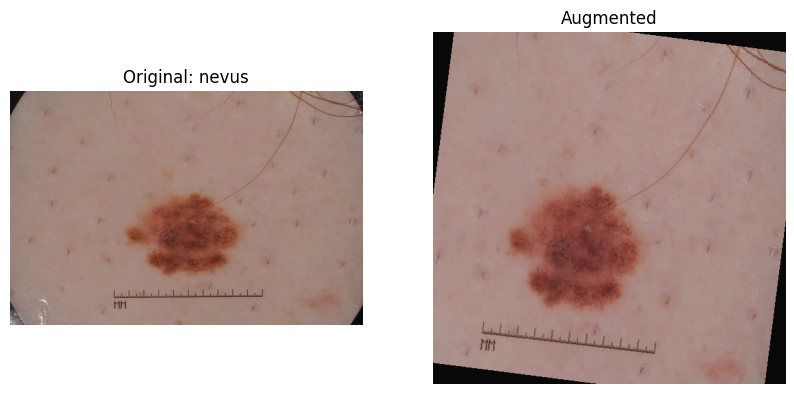

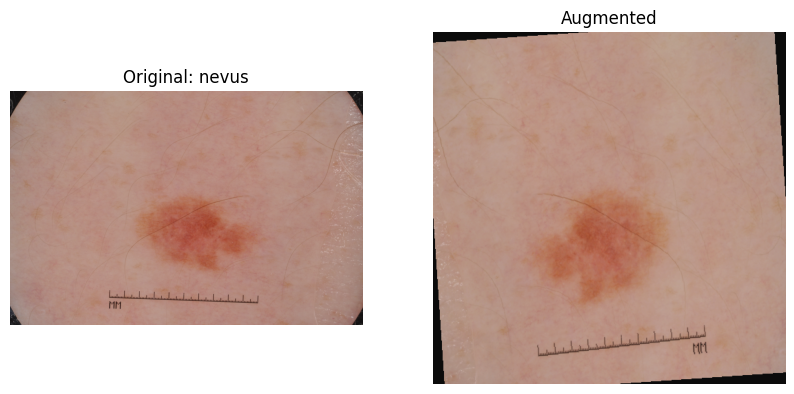

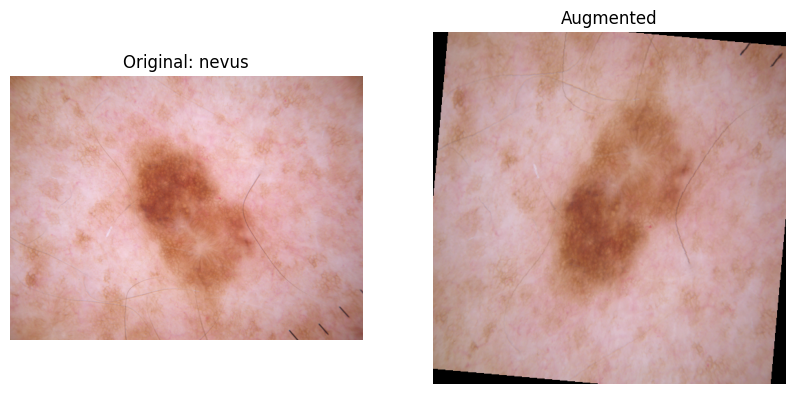

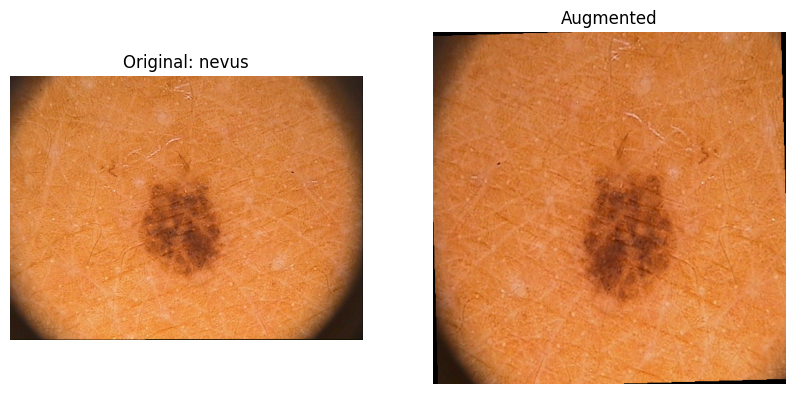

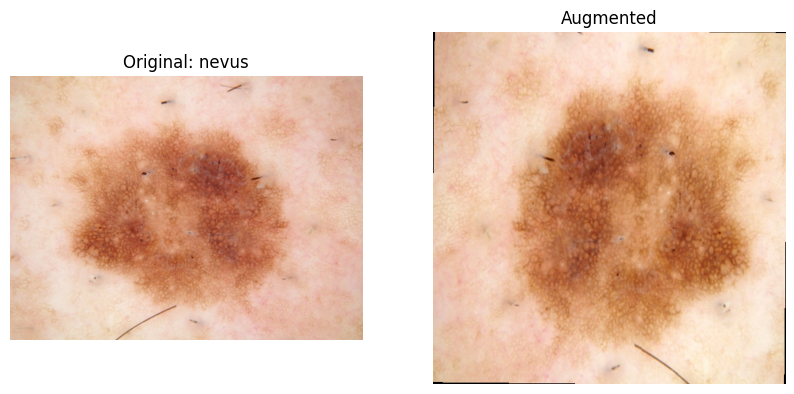


------------------------------
Визуализация для класса: melanoma
------------------------------


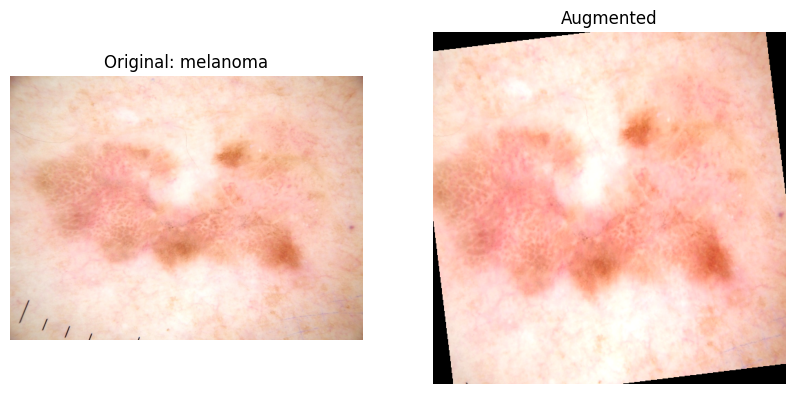

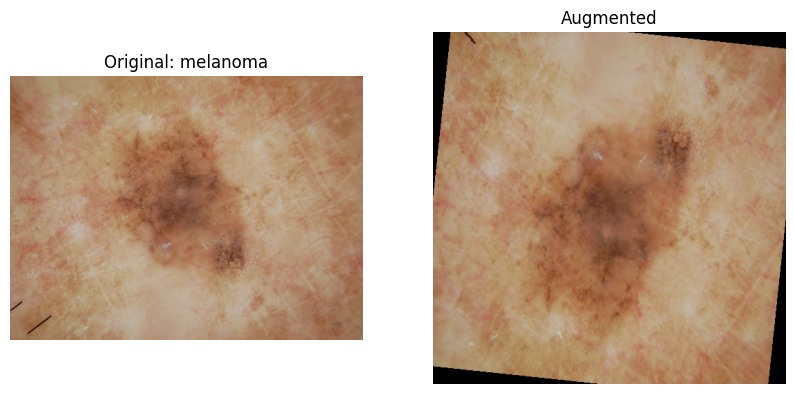

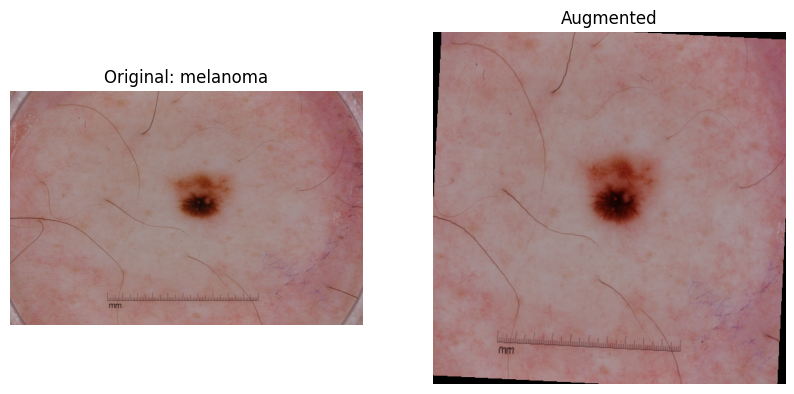

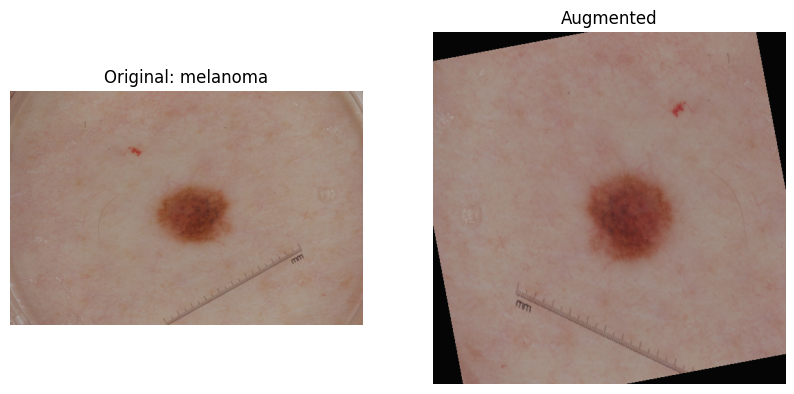

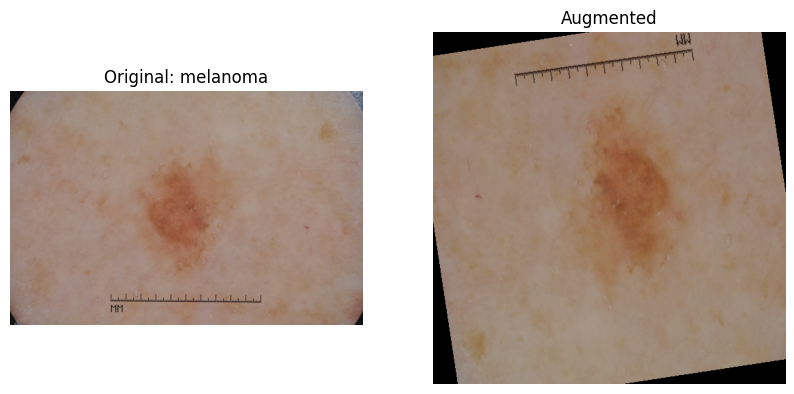


------------------------------
Визуализация для класса: seborrheic_keratosis
------------------------------


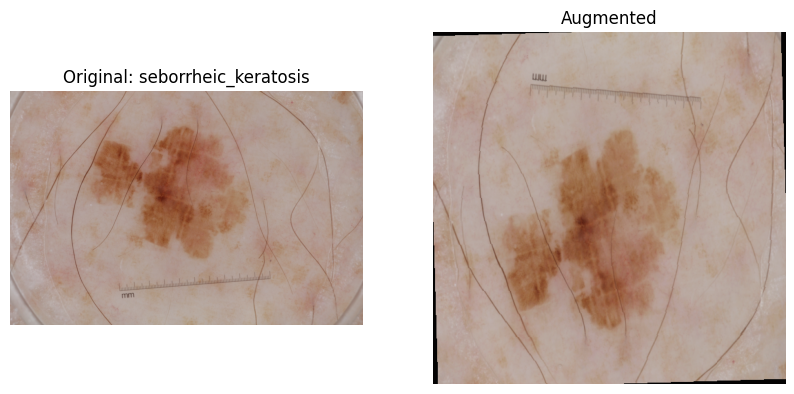

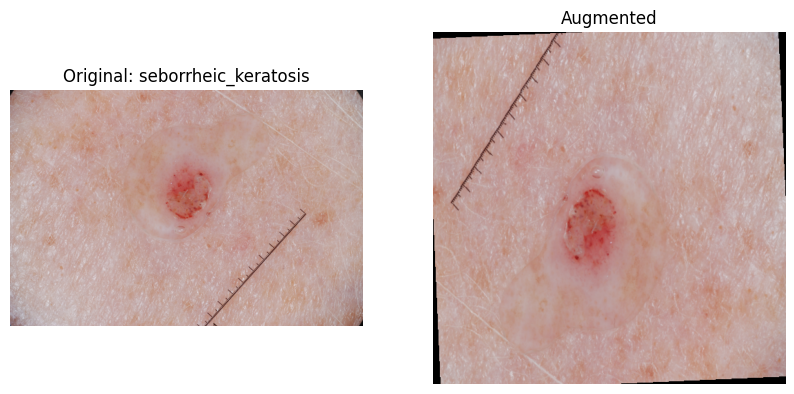

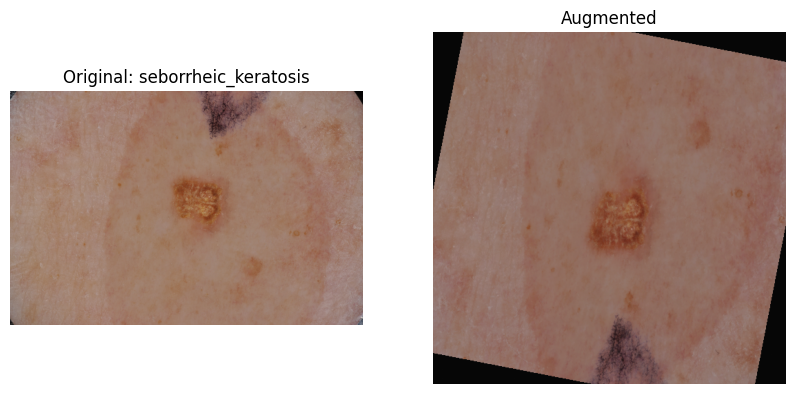

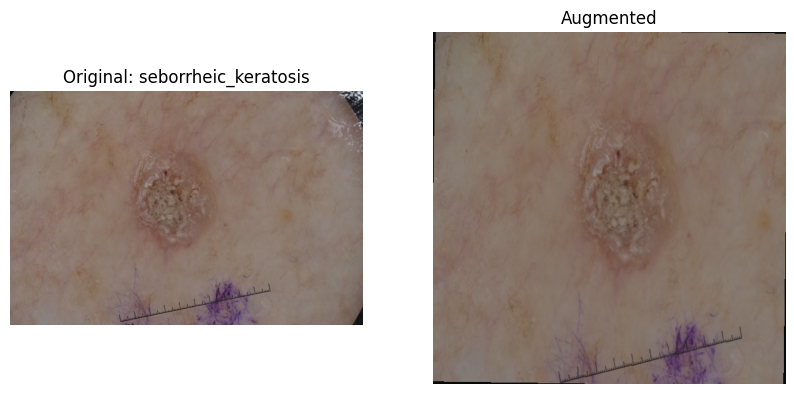

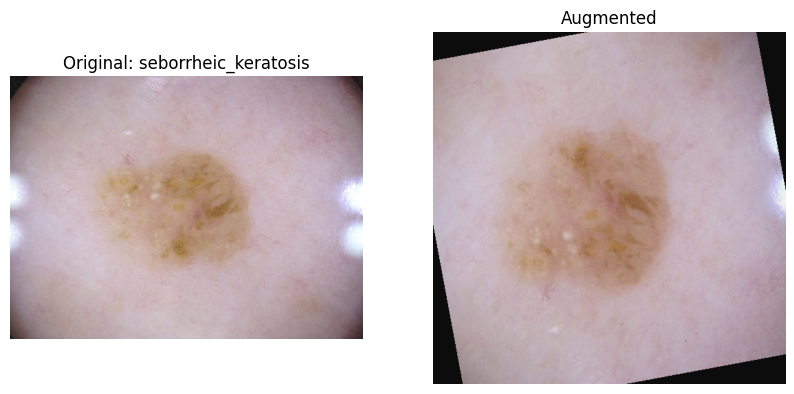

In [17]:
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
import pandas as pd
import torch

# Функция для отображения аугментаций
def visualize_augmentations(dataset, class_name, n_samples=5):
    class_samples = dataset[dataset['diagnosis'] == class_name].sample(n_samples, random_state=42)
    
    for _, row in class_samples.iterrows():
        try:
            # Загрузка оригинального изображения
            orig_image = Image.open(row['image_id'])
            
            # Применение аугментаций
            augmented_image = basic_aug(orig_image)
            
            # Обратная нормализация для визуализации
            if isinstance(augmented_image, torch.Tensor):
                unnormalized = augmented_image.clone().detach()
                for t, m, s in zip(unnormalized, 
                                 [0.485, 0.456, 0.406], 
                                 [0.229, 0.224, 0.225]):
                    t.mul_(s).add_(m)
                augmented_image = unnormalized.permute(1, 2, 0).numpy()
            
            # Визуализация
            plt.figure(figsize=(10, 5))
            
            plt.subplot(1, 2, 1)
            plt.imshow(orig_image)
            plt.title(f"Original: {class_name}")
            plt.axis('off')
            
            plt.subplot(1, 2, 2)
            plt.imshow(augmented_image)
            plt.title("Augmented")
            plt.axis('off')
            
            plt.show()
            
        except Exception as e:
            print(f"Ошибка обработки {row['image_id']}: {str(e)}")

# Применяем для каждого класса
for class_name in train_new['diagnosis'].unique():
    print(f"\n{'-'*30}\nВизуализация для класса: {class_name}\n{'-'*30}")
    visualize_augmentations(train_new, class_name)

Аугментации адекватны и не сильно меняют общую картинку, поэтому могут быть вполне применены для обучения нейросети

In [21]:
#Добавим в базовый набор аугментаций изображений random erasing (маскирование небольших участков)
from torchvision.transforms import functional as F
import math

# 1. Определим собственную функцию для аффинных преобразований с сохранением пропорций
class SmartAffine:
    def __init__(self, scale_range=(0.9, 1.1)):
        self.scale_range = scale_range
        
    def __call__(self, img):
        # Генерируем случайный масштаб
        scale = np.random.uniform(*self.scale_range)
        
        # Вычисляем новые размеры с сохранением пропорций
        w, h = img.size
        new_w = int(w * scale)
        new_h = int(h * scale)
        
        # Применяем аффинное преобразование
        return F.resize(img, (new_h, new_w), interpolation=Image.BILINEAR)

# 2. Исправленный пайплайн аугментаций
basic_aug = transforms.Compose([
    transforms.RandomResizedCrop(512, scale=(0.8, 1.0), ratio=(0.75, 1.33)),
    SmartAffine(scale_range=(0.9, 1.1)),
    transforms.RandomHorizontalFlip(p=0.5),
    transforms.RandomVerticalFlip(p=0.5),
    transforms.RandomRotation(15),
    transforms.ColorJitter(
        brightness=0.1,
        contrast=0.1,
        saturation=0.1,
        hue=0.02
    ),
    transforms.ToTensor(),
    transforms.RandomErasing(
        p=0.5,
        scale=(0.02, 0.1),
        ratio=(0.3, 3.3),
        value='random'
    ),
    transforms.Normalize(imagenet_mean, imagenet_std)
])



------------------------------
Визуализация для класса: nevus
------------------------------


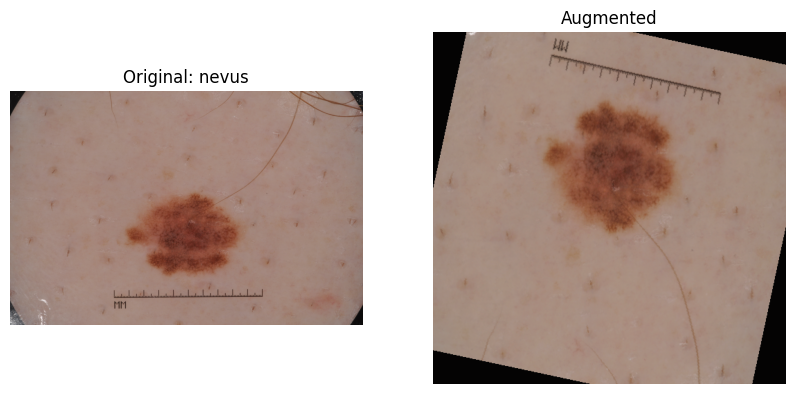

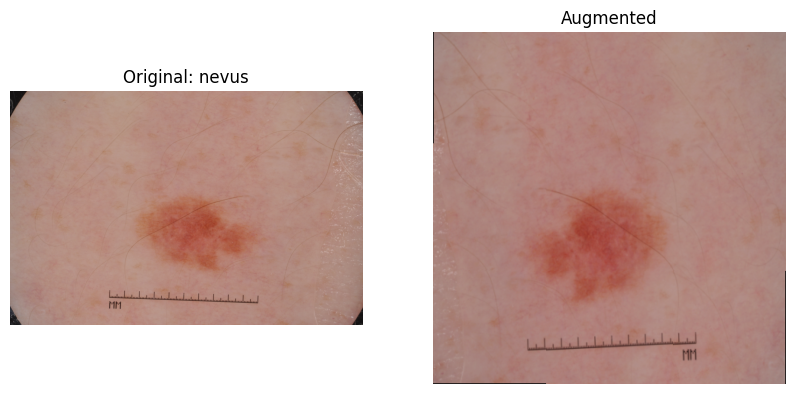

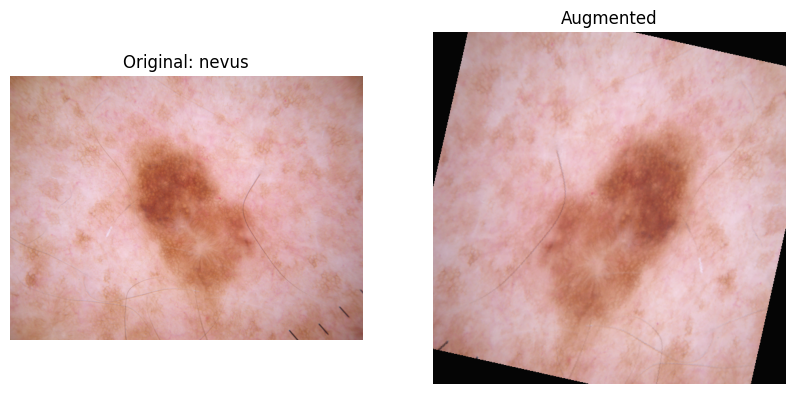

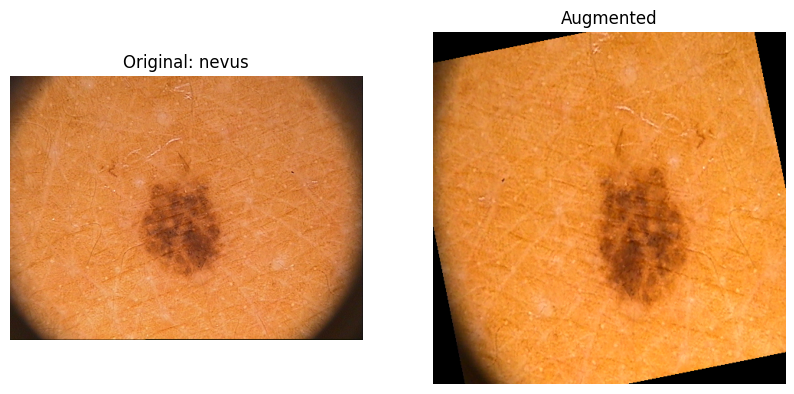

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


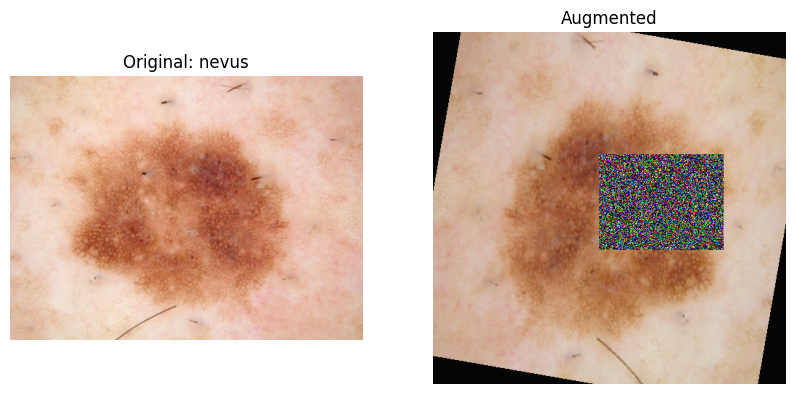


------------------------------
Визуализация для класса: melanoma
------------------------------


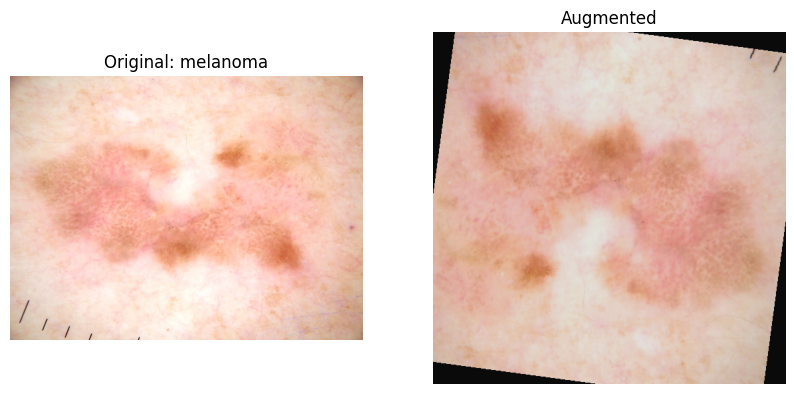

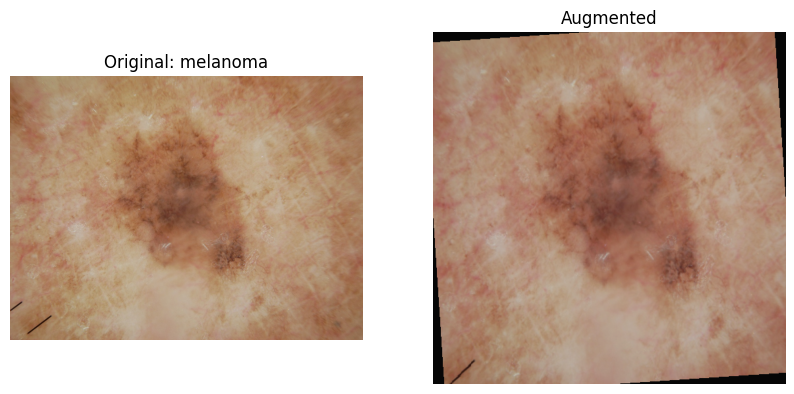

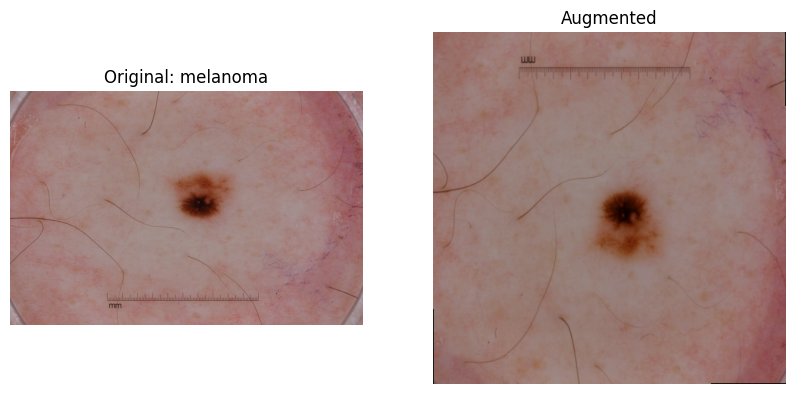

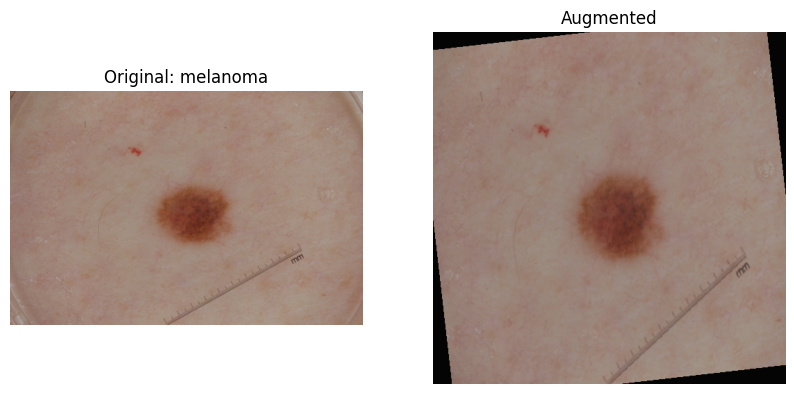

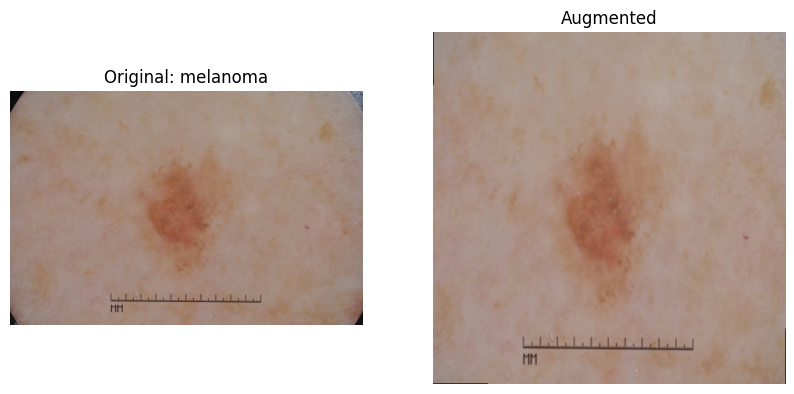


------------------------------
Визуализация для класса: seborrheic_keratosis
------------------------------


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


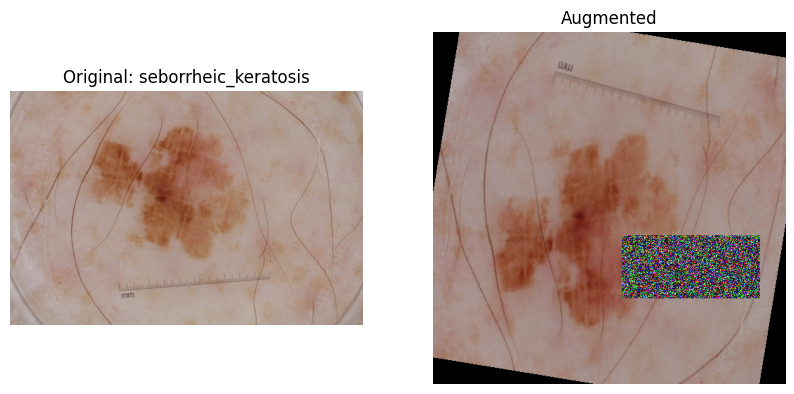

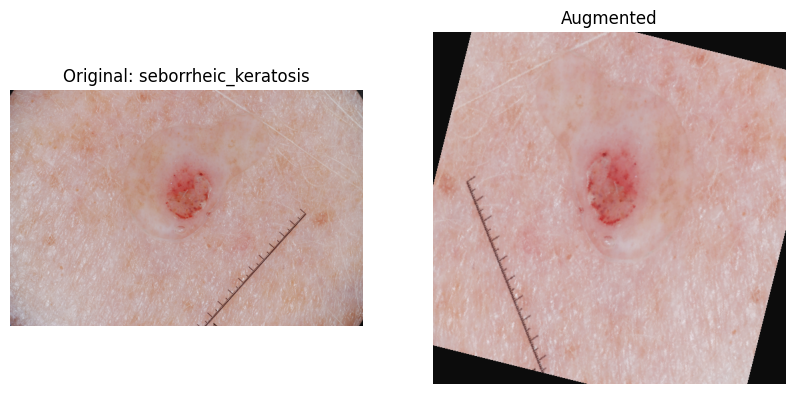

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


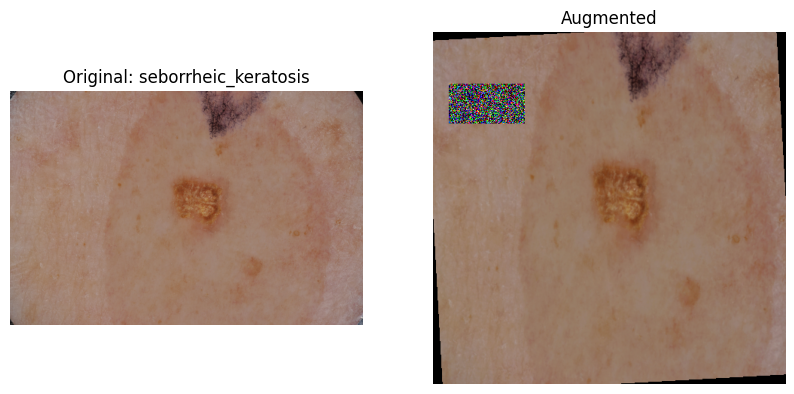

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


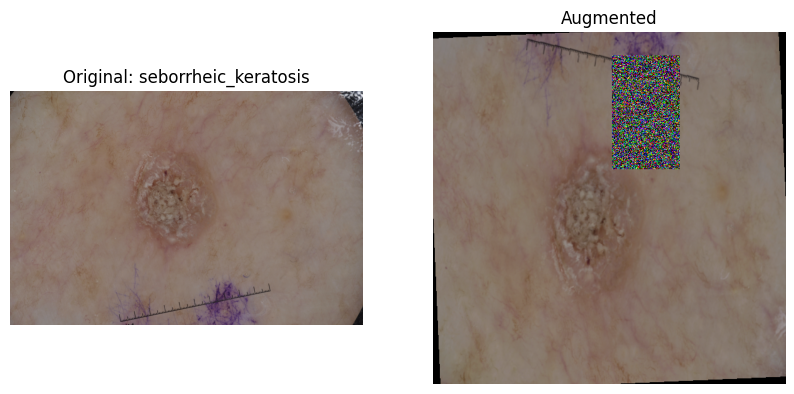

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


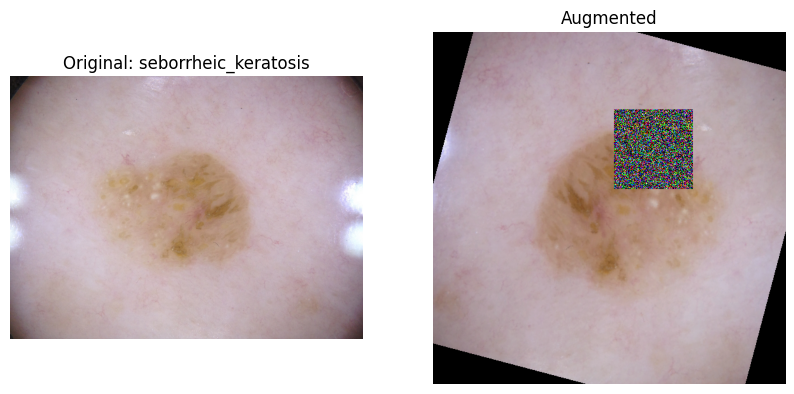

In [23]:
# Применяем снова для каждого класса
for class_name in train_new['diagnosis'].unique():
    print(f"\n{'-'*30}\nВизуализация для класса: {class_name}\n{'-'*30}")
    visualize_augmentations(train_new, class_name)

Успешно улучшили аугментации и не потеряли данные. Приступаем к дальнейшей работе.

In [22]:
import torch
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from PIL import Image
import pandas as pd
import numpy as np

# Параметры нормализации (сначала используем вычисленные ранее)
imagenet_mean = [0.485, 0.456, 0.406]
imagenet_std = [0.229, 0.224, 0.225]

# Определяем преобразования
#Преобразования для тренировочного датасета
train_transform = transforms.Compose([
    transforms.Resize(512),
    transforms.RandomResizedCrop(512, scale=(0.8, 1.0), ratio=(0.75, 1.33)),
    transforms.RandomHorizontalFlip(p=0.5),
    transforms.RandomVerticalFlip(p=0.5),
    transforms.RandomRotation(15),
    transforms.ColorJitter(
        brightness=0.1,
        contrast=0.1,
        saturation=0.1,
        hue=0.02
    ),
    transforms.ToTensor(),
    transforms.RandomErasing(
        p=0.5,
        scale=(0.02, 0.1),
        ratio=(0.3, 3.3),
        value='random'
    ),
    transforms.Normalize(imagenet_mean, imagenet_std)
])
#Преобразования для тестового и валидационного датасетов
test_valid_transform = transforms.Compose([
    transforms.Resize(512),
    transforms.CenterCrop(512),
    transforms.ToTensor(),
    transforms.Normalize(imagenet_mean, imagenet_std)
])

# Кастомный Dataset класс
class SkinLesionDataset(Dataset):
    def __init__(self, dataframe, transform=None):
        self.dataframe = dataframe
        self.transform = transform
        self.class_to_idx = {'nevus': 0, 'melanoma': 1, 'seborrheic_keratosis': 2}

    def __len__(self):
        return len(self.dataframe)

    def __getitem__(self, idx):
        row = self.dataframe.iloc[idx]
        image_path = row['image_id']
        label = self.class_to_idx[row['diagnosis']]
        
        try:
            image = Image.open(image_path).convert('RGB')
            
            if self.transform:
                image = self.transform(image)
                
            return image, label
        
        except Exception as e:
            print(f"Error loading {image_path}: {str(e)}")
            return None

# Создаем датасеты
train_dataset = SkinLesionDataset(
    dataframe=train_new,
    transform=train_transform
)

valid_dataset = SkinLesionDataset(
    dataframe=valid,
    transform=test_valid_transform
)

test_dataset = SkinLesionDataset(
    dataframe=test,
    transform=test_valid_transform
)

# Рекомендуемые параметры DataLoader
batch_size = 32  # Оптимально для 1850 изображений (≈58 batches per epoch)
num_workers = 4   # Для ускорения загрузки данных
pin_memory = True # Для ускорения передачи на GPU

# Функция для обработки None-значений
def collate_fn(batch):
    batch = [item for item in batch if item is not None]
    return torch.utils.data.dataloader.default_collate(batch)

# Создаем DataLoader'ы
train_loader = DataLoader(
    train_dataset,
    batch_size=batch_size,
    shuffle=True,
    num_workers=num_workers,
    pin_memory=pin_memory,
    collate_fn=collate_fn
)

valid_loader = DataLoader(
    valid_dataset,
    batch_size=batch_size,
    shuffle=False,
    num_workers=num_workers,
    pin_memory=pin_memory,
    collate_fn=collate_fn
)

test_loader = DataLoader(
    test_dataset,
    batch_size=batch_size,
    shuffle=False,
    num_workers=num_workers,
    pin_memory=pin_memory,
    collate_fn=collate_fn
)

# Проверка размерностей
sample_batch = next(iter(train_loader))
print(f"Размер батча: {sample_batch[0].shape}")
print(f"Тип данных: {type(sample_batch[0])}")
print(f"Диапазон значений: [{sample_batch[0].min():.3f}, {sample_batch[0].max():.3f}]")

Размер батча: torch.Size([32, 3, 512, 512])
Тип данных: <class 'torch.Tensor'>
Диапазон значений: [-24.517, 19.767]


In [23]:
#Добавляем собственные параметры нормализации - рассчитываем по функции:
def compute_mean_std(loader):
    mean = 0.
    std = 0.
    for images, _ in loader:
        batch_samples = images.size(0)
        images = images.view(batch_samples, images.size(1), -1)
        mean += images.mean(2).sum(0)
        std += images.std(2).sum(0)
    
    mean /= len(loader.dataset)
    std /= len(loader.dataset)
    return mean, std

In [24]:
mean, std = compute_mean_std(train_loader)

In [25]:
# Меняем пайплайн аугментаций на нашу нормализацию mean std
basic_aug = transforms.Compose([
    transforms.RandomResizedCrop(512, scale=(0.8, 1.0), ratio=(0.75, 1.33)),
    SmartAffine(scale_range=(0.9, 1.1)),
    transforms.RandomHorizontalFlip(p=0.5),
    transforms.RandomVerticalFlip(p=0.5),
    transforms.RandomRotation(15),
    transforms.ColorJitter(
        brightness=0.1,
        contrast=0.1,
        saturation=0.1,
        hue=0.02
    ),
    transforms.ToTensor(),
    transforms.RandomErasing(
        p=0.5,
        scale=(0.02, 0.1),
        ratio=(0.3, 3.3),
        value='random'
    ),
    transforms.Normalize(mean, std)
])

In [26]:
mean

tensor([0.7013, 0.3813, 0.4149])

In [27]:
std

tensor([1.1199, 1.0972, 1.0919])

In [28]:
#Пересоздаем функцию визуализации аугментаций после изменения среднего и отклонения 
# Функция для отображения аугментаций
def visualize_augmentations(dataset, class_name, n_samples=5):
    class_samples = dataset[dataset['diagnosis'] == class_name].sample(n_samples, random_state=42)
    
    for _, row in class_samples.iterrows():
        try:
            # Загрузка оригинального изображения
            orig_image = Image.open(row['image_id'])
            
            # Применение аугментаций
            augmented_image = basic_aug(orig_image)
            
            # Обратная нормализация для визуализации
            if isinstance(augmented_image, torch.Tensor):
                unnormalized = augmented_image.clone().detach()
                for t, m, s in zip(unnormalized, 
                                 [0.7013, 0.3813, 0.4149], 
                                 [1.1199, 1.0972, 1.0919]):
                    t.mul_(s).add_(m)
                augmented_image = unnormalized.permute(1, 2, 0).numpy()
            
            # Визуализация
            plt.figure(figsize=(10, 5))
            
            plt.subplot(1, 2, 1)
            plt.imshow(orig_image)
            plt.title(f"Original: {class_name}")
            plt.axis('off')
            
            plt.subplot(1, 2, 2)
            plt.imshow(augmented_image)
            plt.title("Augmented")
            plt.axis('off')
            
            plt.show()
            
        except Exception as e:
            print(f"Ошибка обработки {row['image_id']}: {str(e)}")



------------------------------
Визуализация для класса: nevus
------------------------------


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


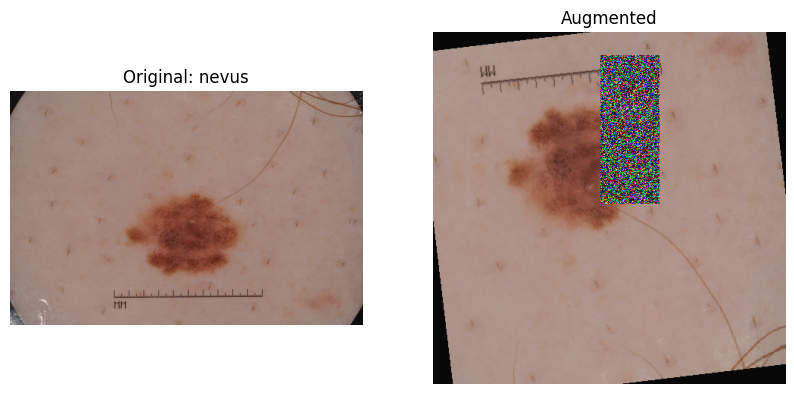

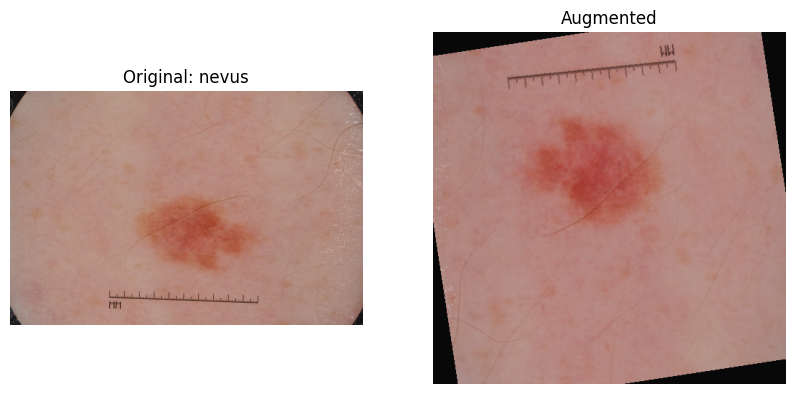

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


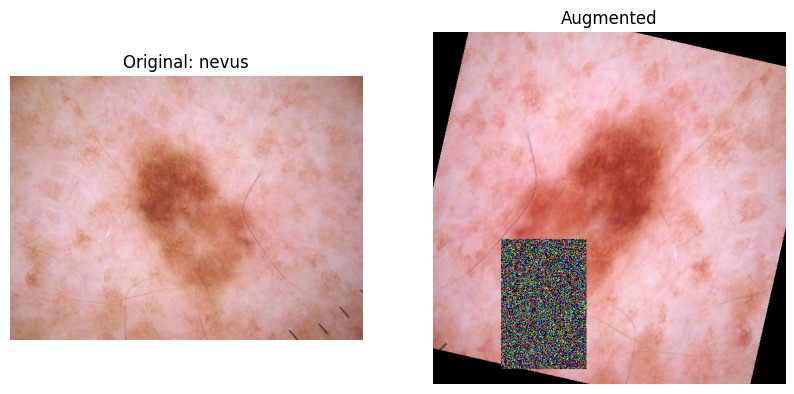

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


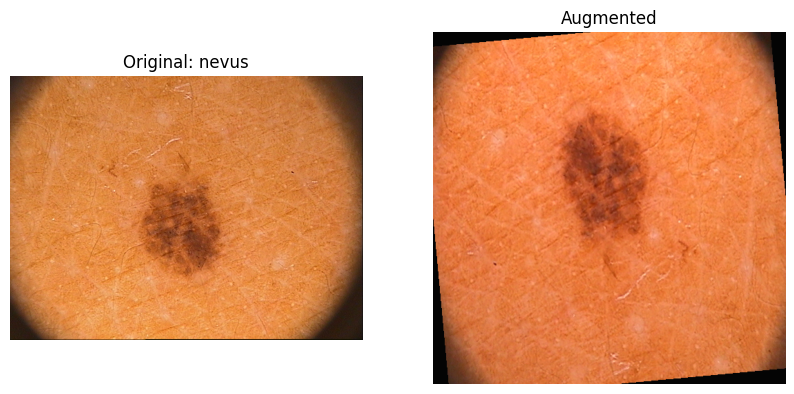

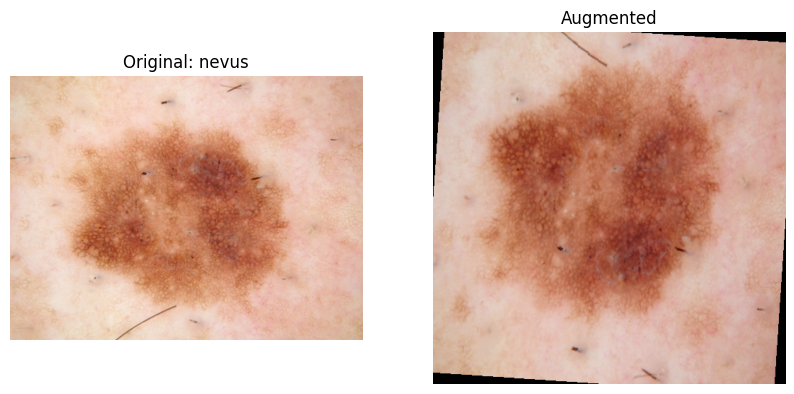

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



------------------------------
Визуализация для класса: melanoma
------------------------------


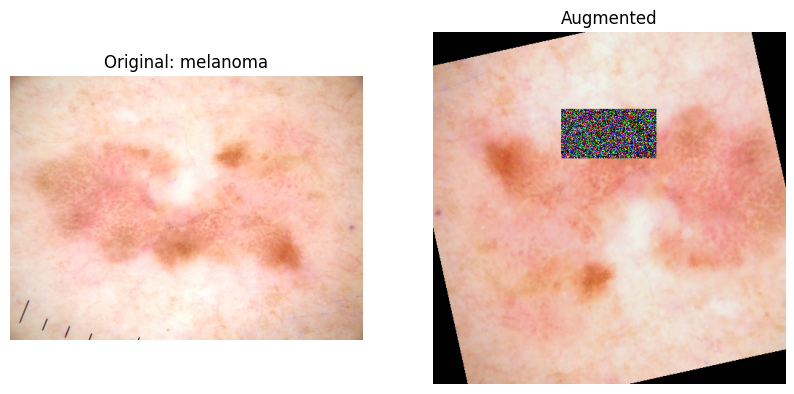

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


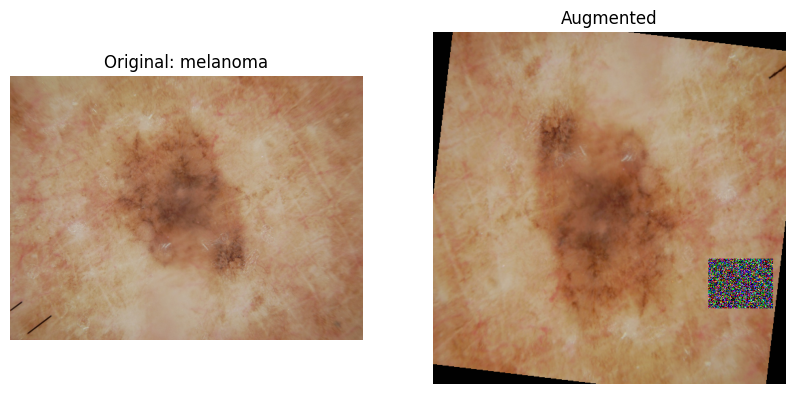

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


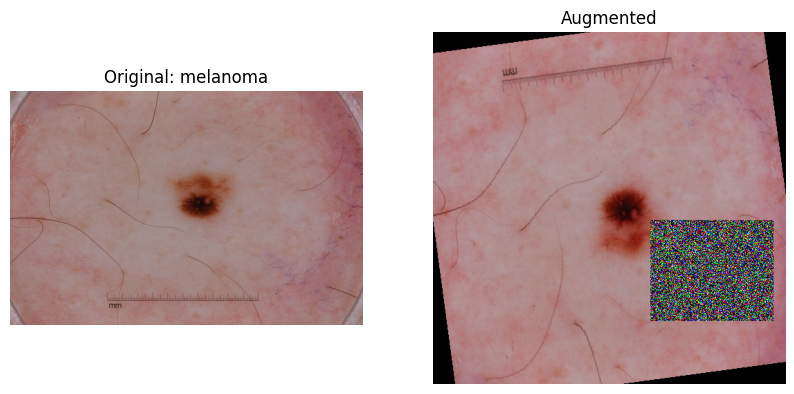

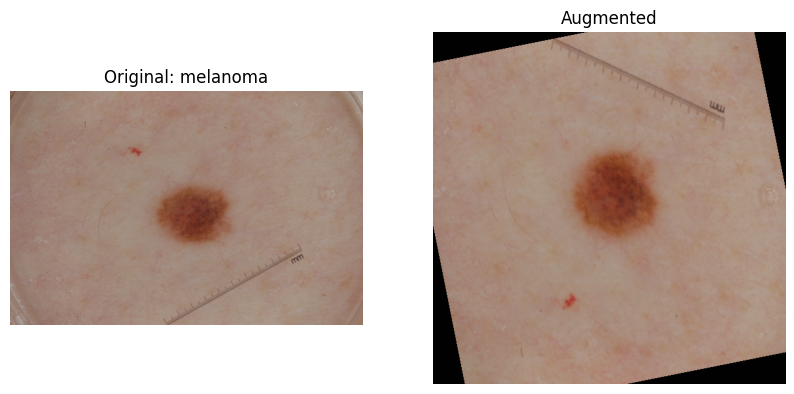

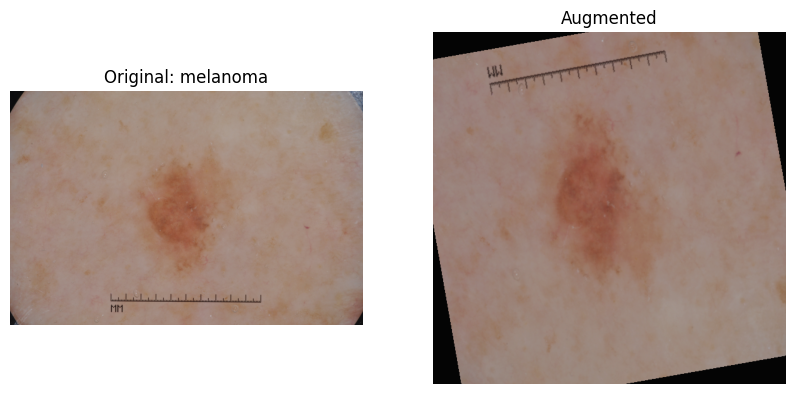


------------------------------
Визуализация для класса: seborrheic_keratosis
------------------------------


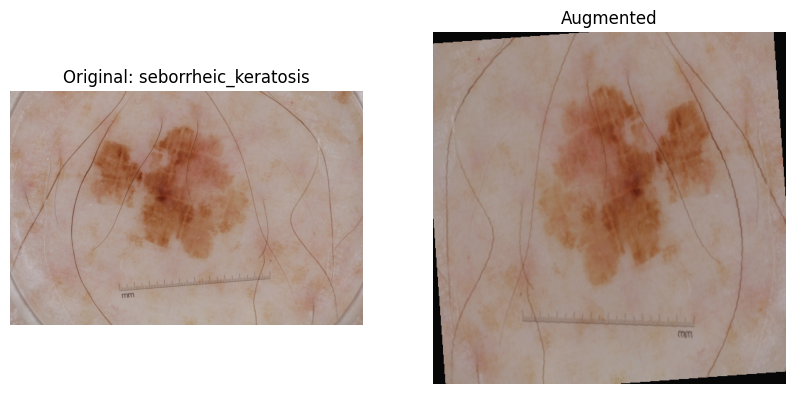

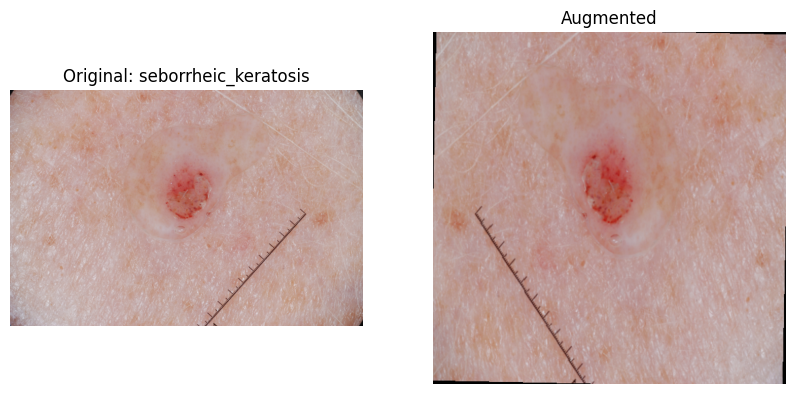

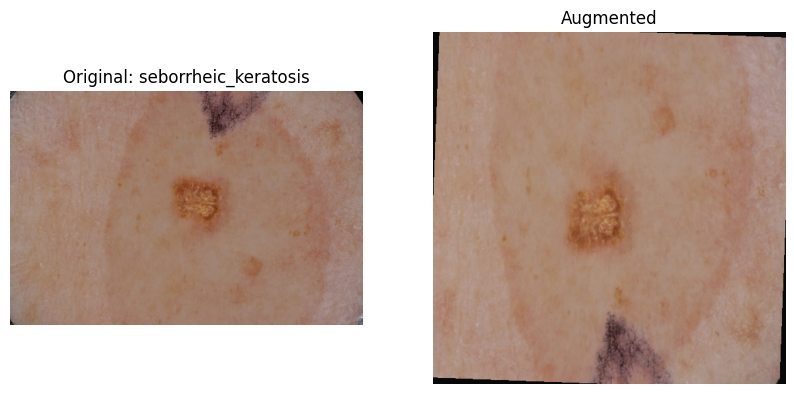

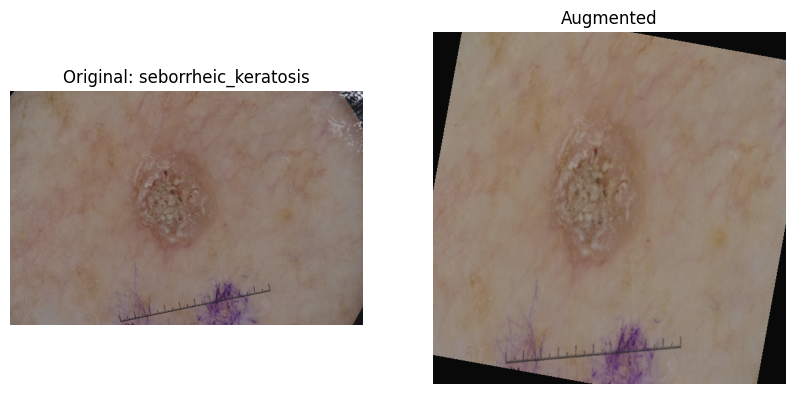

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


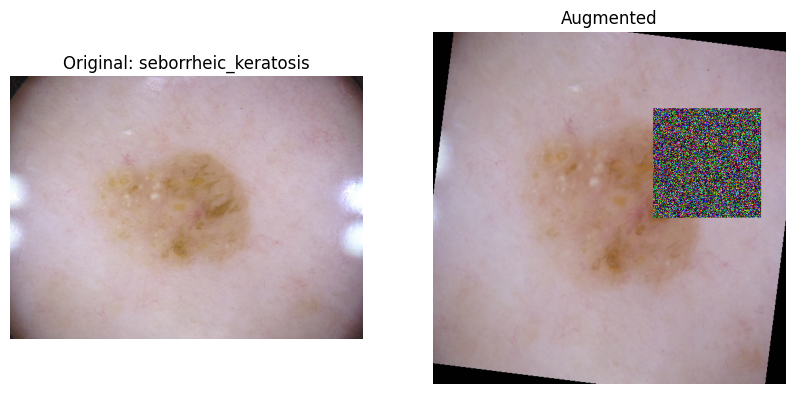

In [34]:
#Проверяем новые аугментации по классам
# Применяем снова для каждого класса
for class_name in train_new['diagnosis'].unique():
    print(f"\n{'-'*30}\nВизуализация для класса: {class_name}\n{'-'*30}")
    visualize_augmentations(train_new, class_name)

In [30]:
std

tensor([1.1199, 1.0972, 1.0919])

Проверка размеров:
Train batches: 58
Valid batches: 5
Test batches: 19

Train loader:


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


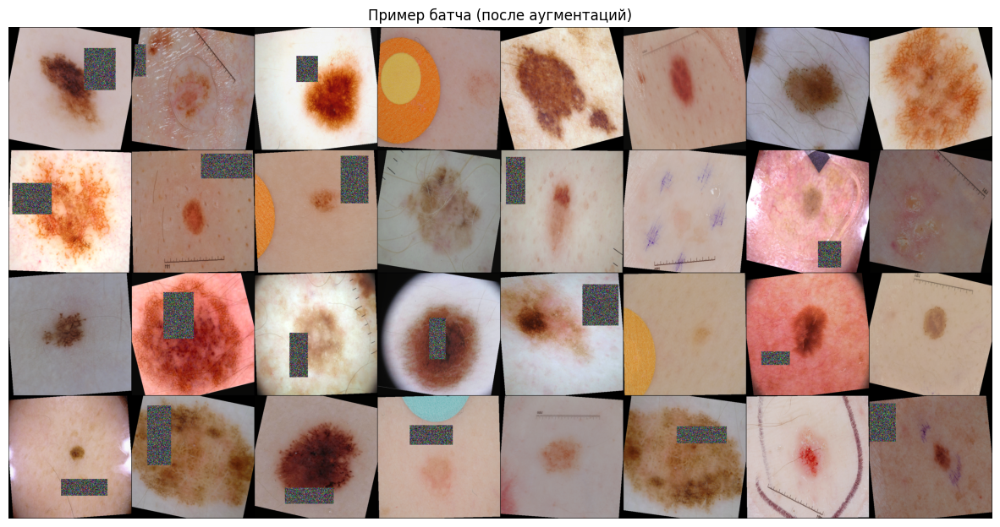


Valid loader:


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


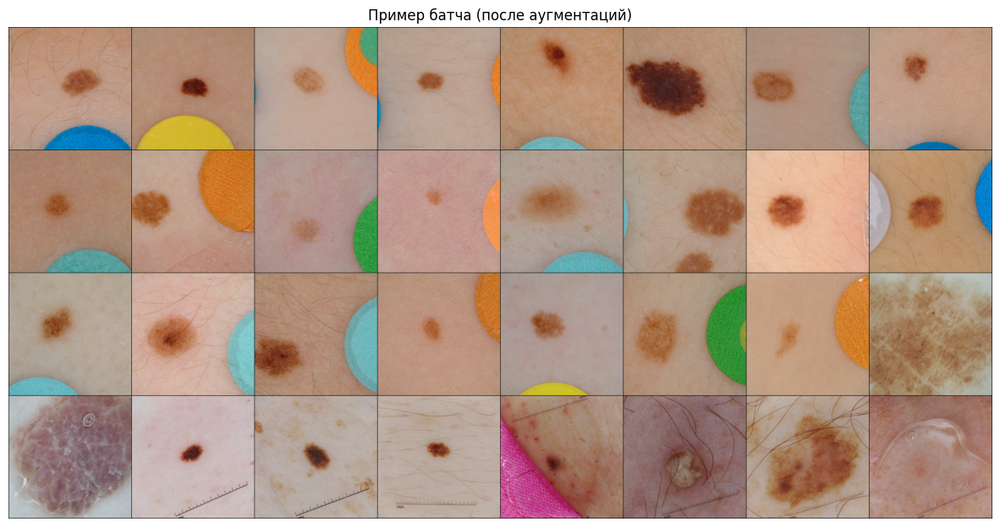


Test loader:


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


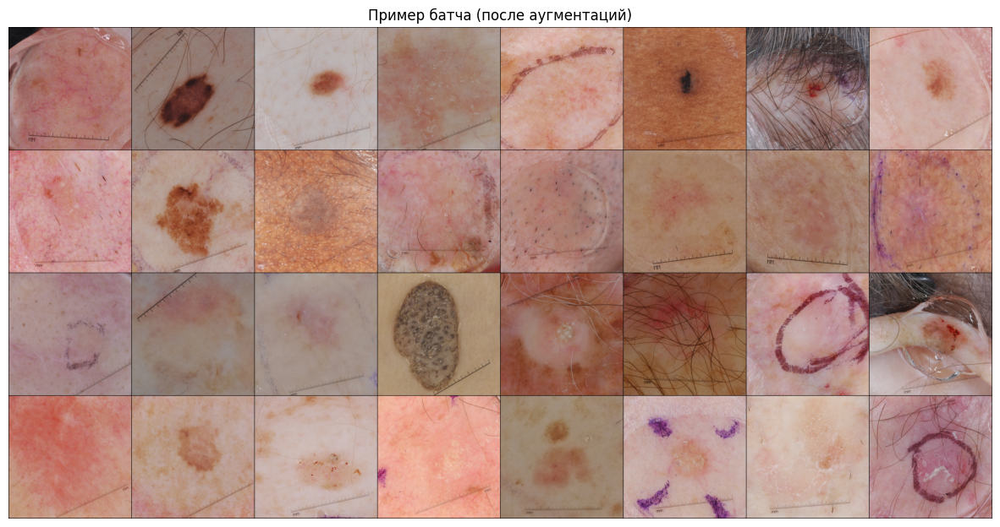

In [31]:
import torch
from torch.utils.data import Dataset, DataLoader, WeightedRandomSampler
from torchvision import transforms, utils
from PIL import Image
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
# Пересоздаем датасеты и лоадеры после доп расчетов, применяем WeightedRandomSampler для балансировки весов классов
# Новые параметры нормализации после расчетов
custom_mean = [0.7013, 0.3813, 0.4149]
custom_std = [1.1199, 1.0972, 1.0919]

# Преобразования для данных
train_transform = transforms.Compose([
    transforms.Resize(512),
    transforms.RandomResizedCrop(512, scale=(0.8, 1.0), ratio=(0.75, 1.33)),
    transforms.RandomHorizontalFlip(p=0.5),
    transforms.RandomVerticalFlip(p=0.5),
    transforms.RandomRotation(15),
    transforms.ColorJitter(
        brightness=0.1,
        contrast=0.1,
        saturation=0.1,
        hue=0.02
    ),
    transforms.ToTensor(),
    transforms.RandomErasing(
        p=0.5,
        scale=(0.02, 0.1),
        ratio=(0.3, 3.3),
        value='random'
    ),
    transforms.Normalize(custom_mean, custom_std)
])

test_valid_transform = transforms.Compose([
    transforms.Resize(512),
    transforms.CenterCrop(512),
    transforms.ToTensor(),
    transforms.Normalize(custom_mean, custom_std)
])

# Класс Dataset
class SkinLesionDataset(Dataset):
    def __init__(self, dataframe, transform=None):
        self.dataframe = dataframe.reset_index(drop=True)
        self.transform = transform
        self.class_to_idx = {'nevus': 0, 'melanoma': 1, 'seborrheic_keratosis': 2}
        self.class_counts = dataframe['diagnosis'].value_counts().sort_index()
        self.weights = 1. / self.class_counts.values
        self.samples_weights = [self.weights[self.class_to_idx[cls]] 
                              for cls in dataframe['diagnosis']]

    def __len__(self):
        return len(self.dataframe)

    def __getitem__(self, idx):
        row = self.dataframe.iloc[idx]
        image_path = row['image_id']
        label = self.class_to_idx[row['diagnosis']]
        
        try:
            image = Image.open(image_path).convert('RGB')
            if self.transform:
                image = self.transform(image)
            return image, label
        except Exception as e:
            print(f"Error loading {image_path}: {str(e)}")
            return None

# Инициализация датасетов
train_dataset = SkinLesionDataset(train_new, train_transform)
valid_dataset = SkinLesionDataset(valid_transformed, test_valid_transform)
test_dataset = SkinLesionDataset(test_transformed, test_valid_transform)

# Настройка WeightedRandomSampler
sampler = WeightedRandomSampler(
    weights=train_dataset.samples_weights,
    num_samples=len(train_dataset),
    replacement=True
)

# Параметры DataLoader
batch_size = 32
num_workers = 4
pin_memory = True

def collate_fn(batch):
    batch = [item for item in batch if item is not None]
    return torch.utils.data.dataloader.default_collate(batch)

# Создание всех DataLoader'ов
train_loader = DataLoader(
    train_dataset,
    batch_size=batch_size,
    sampler=sampler,
    num_workers=num_workers,
    pin_memory=pin_memory,
    collate_fn=collate_fn
)

valid_loader = DataLoader(
    valid_dataset,
    batch_size=batch_size,
    shuffle=False,
    num_workers=num_workers,
    pin_memory=pin_memory,
    collate_fn=collate_fn
)

test_loader = DataLoader(  # Добавлен test_loader
    test_dataset,
    batch_size=batch_size,
    shuffle=False,
    num_workers=num_workers,
    pin_memory=pin_memory,
    collate_fn=collate_fn
)

# Функция визуализации
def show_batch(batch, mean=custom_mean, std=custom_std):
    images, labels = batch
    
    # Обратная нормализация
    inverse_normalize = transforms.Normalize(
        mean=[-m/s for m, s in zip(mean, std)],
        std=[1/s for s in std]
    )
    
    images = inverse_normalize(images)
    
    plt.figure(figsize=(15, 10))
    grid = utils.make_grid(images, nrow=8, padding=2)
    plt.imshow(grid.permute(1, 2, 0))
    plt.title("Пример батча (после аугментаций)")
    plt.axis('off')
    plt.show()

# Проверка всех лоадеров
print("Проверка размеров:")
print(f"Train batches: {len(train_loader)}")
print(f"Valid batches: {len(valid_loader)}")
print(f"Test batches: {len(test_loader)}")

# Визуализация примеров из каждого лоадера
print("\nTrain loader:")
show_batch(next(iter(train_loader)))

print("\nValid loader:")
show_batch(next(iter(valid_loader)))

print("\nTest loader:")
show_batch(next(iter(test_loader)))

# 4. Построение CNN по архитектуре ResNet
### 4.1 Построение блоков модели, обучение

In [44]:
# Собираем архитектуру ResNET
import torch.nn as nn

class ResNetBlock(nn.Module):
    expansion = 1  # Для BasicBlock
    
    def __init__(self, in_channels, out_channels, stride=1, downsample=None):
        super(ResNetBlock, self).__init__()
        self.conv1 = nn.Conv2d(in_channels, out_channels, kernel_size=3, stride=stride, padding=1, bias=False)
        self.bn1 = nn.BatchNorm2d(out_channels)
        self.relu = nn.ReLU(inplace=True)
        self.conv2 = nn.Conv2d(out_channels, out_channels, kernel_size=3, stride=1, padding=1, bias=False)
        self.bn2 = nn.BatchNorm2d(out_channels)
        self.downsample = downsample
        self.stride = stride

    def forward(self, x):
        identity = x

        out = self.conv1(x)
        out = self.bn1(out)
        out = self.relu(out)

        out = self.conv2(out)
        out = self.bn2(out)

        if self.downsample is not None:
            identity = self.downsample(x)

        out += identity
        out = self.relu(out)

        return out

class ResNet(nn.Module):
    def __init__(self, block, layers, num_classes=3, input_channels=3):
        super(ResNet, self).__init__()
        self.inplanes = 64
        self.conv1 = nn.Sequential(
            nn.Conv2d(input_channels, 64, kernel_size=7, stride=2, padding=3, bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True)
        )
        self.maxpool = nn.MaxPool2d(kernel_size=3, stride=2, padding=1)
        self.layer0 = self._make_layer(block, 64, layers[0], stride=1)
        self.layer1 = self._make_layer(block, 128, layers[1], stride=2)
        self.layer2 = self._make_layer(block, 256, layers[2], stride=2)
        self.layer3 = self._make_layer(block, 512, layers[3], stride=2)
        self.avgpool = nn.AdaptiveAvgPool2d((1, 1))  # Автоматическая адаптация размера
        self.fc = nn.Linear(512 * block.expansion, num_classes)

    def _make_layer(self, block, planes, blocks, stride=1):
        downsample = None
        if stride != 1 or self.inplanes != planes * block.expansion:
            downsample = nn.Sequential(
                nn.Conv2d(self.inplanes, planes * block.expansion, kernel_size=1, stride=stride, bias=False),
                nn.BatchNorm2d(planes * block.expansion),
            )

        layers = []
        layers.append(block(self.inplanes, planes, stride, downsample))
        self.inplanes = planes * block.expansion
        for _ in range(1, blocks):
            layers.append(block(self.inplanes, planes))

        return nn.Sequential(*layers)

    def forward(self, x):
        x = self.conv1(x)    # [16, 64, 256, 256]
        x = self.maxpool(x)  # [16, 64, 128, 128]
        
        x = self.layer0(x)   # [16, 64, 128, 128]
        x = self.layer1(x)   # [16, 128, 64, 64]
        x = self.layer2(x)   # [16, 256, 32, 32]
        x = self.layer3(x)   # [16, 512, 16, 16]
        
        x = self.avgpool(x)  # [16, 512, 1, 1]
        x = x.view(x.size(0), -1)  # [16, 512]
        x = self.fc(x)       # [16, 3]
        
        return x

       

In [45]:
# Инициализация модели с размером батча 16
model = ResNet(ResNetBlock, [2, 2, 2, 2])  # ResNet-18 like architecture

criterion = nn.CrossEntropyLoss()

optimizer = optim.Adam(model.parameters(), lr=0.001)

In [46]:
# Списки для хренения метрик для каждой эпохи
train_losses = []
test_losses = []
train_accuracies = []
test_accuracies = []

In [47]:
finalpath1 = '/home/jupyter/datasphere/project/SkinProject'

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model.to(device)


EPOCHS = 15
best_test_accuracy = 0.0 # для хранения лучшей метрики по валидационной выборке

for epoch in range(EPOCHS):
  # Обучение и получение метрик
    model.train()
    train_loss = 0.0
    train_acc = 0.0

    for batch_idx, (inputs, labels) in enumerate(train_loader):
        # Загружаем данные в выбранное устройство
        inputs = inputs.to(device)
        labels = labels.to(device)

        # Прямое распространение и вычисление метрик
        outputs = model(inputs)
        loss = criterion(outputs, labels)
        train_loss += loss.item()

        # Обновляем градиенты и совершаем обратное распространение ошибки
        optimizer.zero_grad()
        loss.backward()

        # Обновляем веса модели
        optimizer.step()

        predicted_class = torch.argmax(torch.softmax(outputs, dim=1), dim=1)
        train_acc += (predicted_class == labels).sum().item()/len(outputs)

    train_acc = train_acc / len(train_loader)
    train_loss = train_loss / len(train_loader)

    train_losses.append(train_loss)
    train_accuracies.append(train_acc)

    # Получение метрик на тестовом датасете
    model.eval()
    test_loss = 0.0
    test_acc = 0.0

    with torch.inference_mode():
        for batch_idx, (inputs, labels) in enumerate(test_loader):
            # Загружаем данные в выбранное устройство
            inputs = inputs.to(device)
            labels = labels.to(device)

            # Прямое распространение и вычисление метрик
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            test_loss += loss.item()


            predicted_class = torch.argmax(torch.softmax(outputs, dim=1), dim=1)
            test_acc += (predicted_class == labels).sum().item()/len(outputs)

    test_acc = test_acc / len(test_loader)
    test_loss = test_loss / len(test_loader)
    test_losses.append(test_loss)
    test_accuracies.append(test_acc)

    print(f'Epoch [{epoch+1}/{EPOCHS}], '
          f'Train Loss: {train_loss:.4f}, Train Acc: {train_acc:.2%}, '
          f'Test Loss: {test_loss:.4f}, Val Acc: {test_acc:.2%}')


    # Сохраняем лучшую модель
    if test_acc > best_test_accuracy:
        best_test_accuracy = test_acc
        torch.save(model.state_dict(), 'best_model_skin.pth')
        torch.save(model.state_dict(), finalpath1+'/MY_best_model_skin.pth')

Epoch [1/15], Train Loss: 0.6604, Train Acc: 73.11%, Test Loss: 1.0119, Val Acc: 65.95%
Epoch [2/15], Train Loss: 0.6138, Train Acc: 75.37%, Test Loss: 0.8807, Val Acc: 65.95%
Epoch [3/15], Train Loss: 0.6044, Train Acc: 75.13%, Test Loss: 1.0156, Val Acc: 66.56%
Epoch [4/15], Train Loss: 0.6019, Train Acc: 76.25%, Test Loss: 0.9152, Val Acc: 60.75%
Epoch [5/15], Train Loss: 0.6082, Train Acc: 75.59%, Test Loss: 0.9362, Val Acc: 65.95%
Epoch [6/15], Train Loss: 0.5855, Train Acc: 76.46%, Test Loss: 0.9864, Val Acc: 63.05%
Epoch [7/15], Train Loss: 0.6225, Train Acc: 74.00%, Test Loss: 0.9491, Val Acc: 66.06%
Epoch [8/15], Train Loss: 0.5852, Train Acc: 73.82%, Test Loss: 0.9704, Val Acc: 64.86%
Epoch [10/15], Train Loss: 0.6250, Train Acc: 74.97%, Test Loss: 0.9074, Val Acc: 68.48%
Epoch [11/15], Train Loss: 0.6105, Train Acc: 74.73%, Test Loss: 0.8842, Val Acc: 66.67%
Epoch [12/15], Train Loss: 0.5701, Train Acc: 76.64%, Test Loss: 0.9999, Val Acc: 65.84%
Epoch [13/15], Train Loss: 0.

### 4.2 Визуализация процесса обучения (потери, точность)

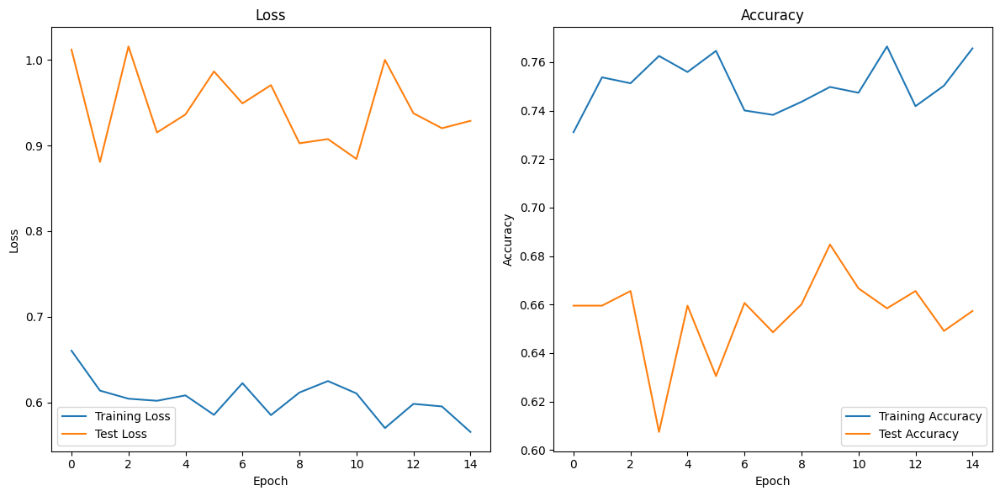

In [49]:
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.plot(train_losses, label='Training Loss')
plt.plot(test_losses, label='Test Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.title('Loss')

plt.subplot(1, 2, 2)
plt.plot(train_accuracies, label='Training Accuracy')
plt.plot(test_accuracies, label='Test Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.title('Accuracy')

plt.tight_layout()
plt.show()

Видим не очень хорошую сходимость модели на тестовых данных, точность на тестовой модели не превышает 68,48%.

In [51]:
model.eval()
predictions = np.array([])
with torch.inference_mode():
  for batch_idx, (inputs, labels) in enumerate(valid_loader):
    # Загружаем данные в выбранное устройство
    inputs = inputs.to(device)
    labels = labels.to(device)

    # Прямое распространение и вычисление метрик
    outputs = model(inputs)

    # Если учите на GPU (T4) то используйте строку ниже
    predicted_class = torch.argmax(torch.softmax(outputs.cpu(), dim=1), dim=1).numpy()

    # Если учите на CPU то используйте строку ниже
    #predicted_class = torch.argmax(torch.softmax(outputs, dim=1), dim=1).numpy()
    predictions = np.append(predictions, predicted_class)
predictions = predictions.astype(int).tolist()

In [53]:
from sklearn.metrics import classification_report, roc_auc_score
import numpy as np
import torch

# Функция для получения предсказаний
def get_predictions(model, loader, device):
    model.eval()
    all_preds = []
    all_probs = []
    all_labels = []
    
    with torch.no_grad():
        for inputs, labels in loader:
            inputs = inputs.to(device)
            outputs = model(inputs)
            
            probs = torch.softmax(outputs, dim=1)
            _, preds = torch.max(outputs, 1)
            
            all_probs.extend(probs.cpu().numpy())
            all_preds.extend(preds.cpu().numpy())
            all_labels.extend(labels.numpy())
    
    return all_labels, all_preds, all_probs

# Получаем предсказания для валидационного набора
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
y_true, y_pred, y_probs = get_predictions(model, valid_loader, device)

# Сопоставление индексов и имен классов
class_names = list(valid_dataset.class_to_idx.keys())
target_names = [class_names[i] for i in sorted(valid_dataset.class_to_idx.values())]

# Classification report
report = classification_report(y_true, y_pred, target_names=target_names, output_dict=True)

# Вывод метрик по классам
print("Classification Report:")
print(f"{'Class':<20} {'Precision':<10} {'Recall':<10} {'F1-Score':<10} {'Support':<10}")
print("-" * 60)
for cls in target_names:
    print(f"{cls:<20} {report[cls]['precision']:<10.4f} {report[cls]['recall']:<10.4f} "
          f"{report[cls]['f1-score']:<10.4f} {report[cls]['support']:<10}")

# Метрики macro average
print("\nMacro Average Metrics:")
print(f"Precision: {report['macro avg']['precision']:.4f}")
print(f"Recall: {report['macro avg']['recall']:.4f}")
print(f"F1-Score: {report['macro avg']['f1-score']:.4f}")
print(f"Support: {report['macro avg']['support']}")

# ROC AUC Score (One-vs-Rest)
y_true_onehot = np.eye(len(target_names))[y_true]
roc_auc = roc_auc_score(y_true_onehot, y_probs, multi_class="ovr")

print(f"\nROC AUC Score (One-vs-Rest): {roc_auc:.4f}")

Classification Report:
Class                Precision  Recall     F1-Score   Support   
------------------------------------------------------------
nevus                0.5794     0.9359     0.7157     78        
melanoma             0.0000     0.0000     0.0000     30        
seborrheic_keratosis 0.6250     0.3571     0.4545     42        

Macro Average Metrics:
Precision: 0.4015
Recall: 0.4310
F1-Score: 0.3901
Support: 150

ROC AUC Score (One-vs-Rest): 0.7506


Метрики, мягко говоря, не очень - меланома вообще не распознается

# 4. Построение CNN по архитектуре DenseNet201 с использованием подготовленной модели кожных заболеваний 
Использовать будем модель DenseNet201, которую используют для классификации кожных заболеваний с хорошими метриками (публикация сравниваемых разных архиктектур прилагается).
Публикация на paperswithcode сравнительная по предобученным архитектурам моделей для классификаций кожных заболеваний - статья Saswat Panda, Abhishek Sunil Tiwari, Manas Ranjan Prusty (2021); Comparative study on different Deep Learning models <br>for Skin Lesion Classification using transfer learning approach; International Journal of Scientific and Research Publications <br>(IJSRP) 11(1) (ISSN: 2250-3153), DOI: http://dx.doi.org/10.29322/IJSRP.11.01.2021.p10923
### 4.1 Построение блоков модели, обучение, оценка модели (метрики)

In [29]:
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import models, transforms
from tqdm import tqdm
import matplotlib.pyplot as plt
import numpy as np
from sklearn.metrics import classification_report, roc_auc_score

# 1. Инициализация модели DenseNet201
class DenseNet201(nn.Module):
    def __init__(self, num_classes=3):
        super(DenseNet201, self).__init__()
        self.model = models.densenet201(pretrained=True)
        
        # Замена классификатора
        num_ftrs = self.model.classifier.in_features
        self.model.classifier = nn.Sequential(
            nn.Linear(num_ftrs, 512),
            nn.ReLU(),
            nn.Dropout(0.5),
            nn.Linear(512, num_classes)
        )
        
    def forward(self, x):
        return self.model(x)

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = DenseNet201(num_classes=3).to(device)

# 2. Стратегия постепенного размораживания
def freeze_layers(model, num_blocks=4):
    # Замораживаем все слои
    for param in model.parameters():
        param.requires_grad = False
    
    # Постепенно размораживаем блоки
    if num_blocks >= 4:
        for param in model.model.features.denseblock4.parameters():
            param.requires_grad = True
    if num_blocks >= 3:
        for param in model.model.features.denseblock3.parameters():
            param.requires_grad = True
    if num_blocks >= 2:
        for param in model.model.features.denseblock2.parameters():
            param.requires_grad = True
    if num_blocks >= 1:
        for param in model.model.features.denseblock1.parameters():
            param.requires_grad = True
            
    # Всегда размораживаем классификатор
    for param in model.model.classifier.parameters():
        param.requires_grad = True

# 3. Конфигурация обучения
class_weights = torch.tensor([1.0, 3.0, 2.0]).to(device)  # Веса для классов
criterion = nn.CrossEntropyLoss(weight=class_weights)
optimizer = optim.AdamW(model.parameters(), lr=1e-4, weight_decay=1e-4)
scheduler = optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=10)

# 4. Функции обучения и валидации
def train_epoch(model, loader, optimizer, criterion, epoch, unfreeze_epochs=None):
    model.train()
    if unfreeze_epochs:
        freeze_layers(model, num_blocks=unfreeze_epochs.get(epoch, 1))
        
    total_loss = 0.0
    correct = 0
    progress_bar = tqdm(loader, desc=f'Epoch {epoch+1} [Train]')
    
    for inputs, labels in progress_bar:
        inputs, labels = inputs.to(device), labels.to(device)
        
        optimizer.zero_grad()
        outputs = model(inputs)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        
        total_loss += loss.item()
        _, preds = torch.max(outputs, 1)
        correct += torch.sum(preds == labels.data)
        
        progress_bar.set_postfix({
            'loss': f'{loss.item():.4f}',
            'lr': f'{optimizer.param_groups[0]["lr"]:.2e}'
        })
    
    return total_loss / len(loader), correct.double() / len(loader.dataset)

def validate(model, loader, criterion):
    model.eval()
    total_loss = 0.0
    correct = 0
    progress_bar = tqdm(loader, desc='Validation')
    
    with torch.no_grad():
        for inputs, labels in progress_bar:
            inputs, labels = inputs.to(device), labels.to(device)
            
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            
            total_loss += loss.item()
            _, preds = torch.max(outputs, 1)
            correct += torch.sum(preds == labels.data)
            
            progress_bar.set_postfix({'val_loss': f'{loss.item():.4f}'})
    
    return total_loss / len(loader), correct.double() / len(loader.dataset)

# 5. Полный цикл обучения с прогрессивным размораживанием
history = {'train_loss': [], 'test_loss': [], 'train_acc': [], 'test_acc': []}  # Изменено val -> test
best_acc = 0.0

# Расписание размораживания: {epoch: num_blocks}
unfreeze_schedule = {
    5: 3,   # После 5 эпох размораживаем denseblock3
    10: 2,  # После 10 эпох размораживаем denseblock2
    15: 1   # После 15 эпох размораживаем denseblock1
}

for epoch in range(20):
    train_loss, train_acc = train_epoch(
        model, train_loader, optimizer, criterion, 
        epoch, unfreeze_schedule if epoch > 5 else None
    )
    # Валидация на test_loader вместо valid_loader
    test_loss, test_acc = validate(model, test_loader, criterion)  # Изменено
    scheduler.step()
    
    # Сохраняем историю
    history['train_loss'].append(train_loss)
    history['test_loss'].append(test_loss)  # Изменено
    history['train_acc'].append(train_acc.cpu())
    history['test_acc'].append(test_acc.cpu())  # Изменено
    
    # Сохраняем лучшую модель
    if test_acc > best_acc:  # Изменено
        best_acc = test_acc
        torch.save(model.state_dict(), 'best_densenet.pth')
    
    print(f'Epoch {epoch+1:02d}')
    print(f'Train Loss: {train_loss:.4f} Acc: {train_acc:.4f}')
    print(f'Test Loss: {test_loss:.4f} Acc: {test_acc:.4f}\n')  # Изменено

# 6. Визуализация процесса обучения
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.plot(history['train_loss'], label='Train Loss')
plt.plot(history['test_loss'], label='Test Loss')  # Изменено
plt.title('Loss Evolution')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(history['train_acc'], label='Train Accuracy')
plt.plot(history['test_acc'], label='Test Accuracy')  # Изменено
plt.title('Accuracy Evolution')
plt.legend()
plt.show()

# 7. Оценка лучшей модели на валидационном наборе (бывшем test)
model.load_state_dict(torch.load('best_densenet.pth'))
valid_loss, valid_acc = validate(model, valid_loader, criterion)  # Изменено
print(f'\nValidation Loss: {valid_loss:.4f} | Validation Acc: {valid_acc:.4f}')  # Изменено

# 8. Подробные метрики классификации на валидационном наборе
y_true, y_pred, y_probs = get_predictions(model, valid_loader)  # Изменено

# Classification report
class_names = list(valid_dataset.class_to_idx.keys())  # Изменено
report = classification_report(y_true, y_pred, target_names=class_names, output_dict=True)

print("\nDetailed Classification Report (Validation Set):")  # Изменено
print(f"{'Class':<20} {'Precision':<10} {'Recall':<10} {'F1-Score':<10} {'Support':<10}")
print("-" * 60)
for cls in class_names:
    print(f"{cls:<20} {report[cls]['precision']:<10.4f} {report[cls]['recall']:<10.4f} "
          f"{report[cls]['f1-score']:<10.4f} {report[cls]['support']:<10}")

# ROC AUC для валидационного набора
y_true_onehot = np.eye(len(class_names))[y_true]
roc_auc = roc_auc_score(y_true_onehot, y_probs, multi_class="ovr")
print(f"\nROC AUC Score (Validation): {roc_auc:.4f}")  # Изменено

# 9. Визуализация ошибок на валидационном наборе
wrong_samples = []
for i, (true, pred) in enumerate(zip(y_true, y_pred)):
    if true != pred:
        wrong_samples.append((i, true, pred))

print(f"\nTotal errors (Validation): {len(wrong_samples)}/{len(y_true)} ({len(wrong_samples)/len(y_true):.2%})") 

Downloading: "https://download.pytorch.org/models/densenet201-c1103571.pth" to /tmp/xdg_cache/torch/hub/checkpoints/densenet201-c1103571.pth
100%|██████████| 77.4M/77.4M [00:01<00:00, 51.1MB/s]
Epoch 1 [Train]:   0%|          | 0/58 [00:08<?, ?it/s]


OutOfMemoryError: CUDA out of memory. Tried to allocate 58.00 MiB (GPU 0; 31.74 GiB total capacity; 31.33 GiB already allocated; 16.38 MiB free; 31.35 GiB reserved in total by PyTorch) If reserved memory is >> allocated memory try setting max_split_size_mb to avoid fragmentation.  See documentation for Memory Management and PYTORCH_CUDA_ALLOC_CONF

Для модели с постепенным размораживанием не хватает памяти! Оптимизируем модель. Уменьшаем размер батча до 8, используем полностью предтренированную модель DenseNet201, изменили ряд аугментаций (упростили). 
Тренировка и валидация модели на train и test, оценка метрик на valid. 

Validation: 100%|██████████| 75/75 [05:39<00:00,  4.53s/it, val_loss=0.7618]


Epoch 1/15
Train Loss: 1.0518 Acc: 0.5208
Test Val Loss: 0.9745 Acc: 0.6550



Validation: 100%|██████████| 75/75 [01:55<00:00,  1.54s/it, val_loss=0.7173]


Epoch 2/15
Train Loss: 1.0082 Acc: 0.6683
Test Val Loss: 0.9593 Acc: 0.6567



Validation: 100%|██████████| 75/75 [01:54<00:00,  1.53s/it, val_loss=0.7510]


Epoch 3/15
Train Loss: 0.9985 Acc: 0.6699
Test Val Loss: 0.9533 Acc: 0.6533



Validation: 100%|██████████| 75/75 [01:56<00:00,  1.55s/it, val_loss=0.7379]


Epoch 4/15
Train Loss: 0.9807 Acc: 0.6688
Test Val Loss: 0.9438 Acc: 0.6533



Validation: 100%|██████████| 75/75 [01:56<00:00,  1.55s/it, val_loss=0.7687]


Epoch 5/15
Train Loss: 0.9729 Acc: 0.6802
Test Val Loss: 0.9395 Acc: 0.6383



Validation: 100%|██████████| 75/75 [01:57<00:00,  1.57s/it, val_loss=0.7396]


Epoch 6/15
Train Loss: 0.9472 Acc: 0.6710
Test Val Loss: 0.9134 Acc: 0.6500



Validation: 100%|██████████| 75/75 [01:57<00:00,  1.57s/it, val_loss=0.7918]


Epoch 7/15
Train Loss: 0.9255 Acc: 0.6807
Test Val Loss: 0.8977 Acc: 0.6567



Validation: 100%|██████████| 75/75 [01:56<00:00,  1.55s/it, val_loss=0.7822]


Epoch 8/15
Train Loss: 0.9067 Acc: 0.6656
Test Val Loss: 0.8631 Acc: 0.6583



Validation: 100%|██████████| 75/75 [01:57<00:00,  1.56s/it, val_loss=0.8171]


Epoch 9/15
Train Loss: 0.8769 Acc: 0.6861
Test Val Loss: 0.8526 Acc: 0.6850



Validation: 100%|██████████| 75/75 [01:55<00:00,  1.55s/it, val_loss=0.9802]


Epoch 10/15
Train Loss: 0.8567 Acc: 0.6904
Test Val Loss: 0.8975 Acc: 0.6067



Validation: 100%|██████████| 75/75 [01:57<00:00,  1.57s/it, val_loss=0.8425]


Epoch 11/15
Train Loss: 0.8345 Acc: 0.6807
Test Val Loss: 0.8321 Acc: 0.6817



Validation: 100%|██████████| 75/75 [01:56<00:00,  1.55s/it, val_loss=0.8824]


Epoch 12/15
Train Loss: 0.8268 Acc: 0.6861
Test Val Loss: 0.8069 Acc: 0.6767



Validation: 100%|██████████| 75/75 [01:57<00:00,  1.56s/it, val_loss=0.8253]


Epoch 13/15
Train Loss: 0.8130 Acc: 0.6888
Test Val Loss: 0.7902 Acc: 0.6983



Validation: 100%|██████████| 75/75 [01:56<00:00,  1.56s/it, val_loss=0.8408]


Epoch 14/15
Train Loss: 0.7816 Acc: 0.6872
Test Val Loss: 0.7456 Acc: 0.6917



Validation: 100%|██████████| 75/75 [01:57<00:00,  1.57s/it, val_loss=0.7806]

Epoch 15/15
Train Loss: 0.7552 Acc: 0.6996
Test Val Loss: 0.7696 Acc: 0.6933



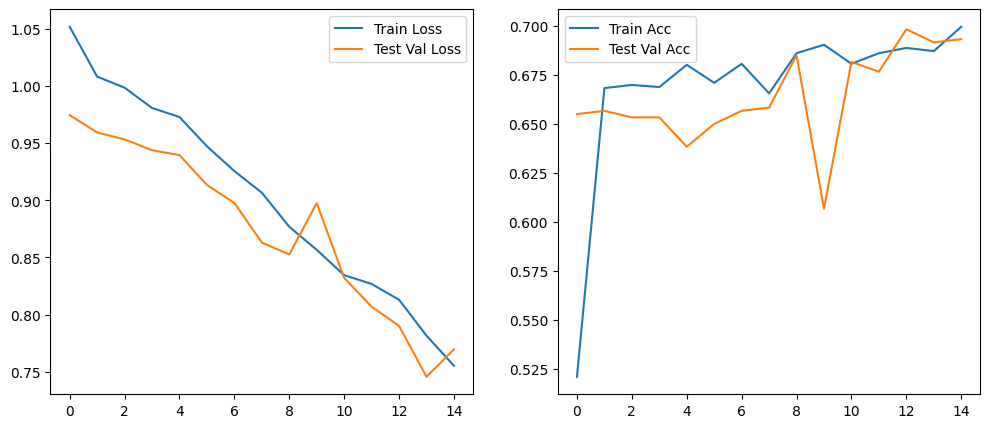

Validation: 100%|██████████| 19/19 [00:33<00:00,  1.75s/it, val_loss=0.8059]

Final Validation Loss: 0.7622 | Validation Acc: 0.7400



Final Validation Classification Report:
                      precision    recall  f1-score   support

               nevus       0.77      0.82      0.80        78
            melanoma       0.75      0.40      0.52        30
seborrheic_keratosis       0.69      0.83      0.75        42

            accuracy                           0.74       150
           macro avg       0.74      0.68      0.69       150
        weighted avg       0.74      0.74      0.73       150

Validation ROC AUC: 0.8414


In [34]:
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import models, transforms
from tqdm import tqdm
import matplotlib.pyplot as plt
import numpy as np
from sklearn.metrics import classification_report, roc_auc_score

# 1. Настройки для экономии памяти
torch.backends.cudnn.benchmark = True
torch.cuda.empty_cache()

# 2. Определение преобразований
train_transform = transforms.Compose([
    transforms.Resize(256),
    transforms.RandomResizedCrop(224),
    transforms.RandomHorizontalFlip(),
    transforms.RandomVerticalFlip(),
    transforms.RandomRotation(15),
    transforms.ColorJitter(brightness=0.1, contrast=0.1, saturation=0.1),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

test_transform = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

# 3. Класс Dataset
class SkinLesionDataset(Dataset):
    def __init__(self, dataframe, transform=None):
        self.dataframe = dataframe
        self.transform = transform
        self.class_to_idx = {'nevus': 0, 'melanoma': 1, 'seborrheic_keratosis': 2}

    def __len__(self):
        return len(self.dataframe)

    def __getitem__(self, idx):
        row = self.dataframe.iloc[idx]
        image_path = row['image_id']
        label = self.class_to_idx[row['diagnosis']]
        
        try:
            image = Image.open(image_path).convert('RGB')
            if self.transform:
                image = self.transform(image)
            return image, label
        except Exception as e:
            print(f"Error loading {image_path}: {str(e)}")
            return None

# 4. Инициализация модели
class DenseNet121(nn.Module):
    def __init__(self, num_classes=3):
        super(DenseNet121, self).__init__()
        self.base_model = models.densenet121(pretrained=True)
        
        # Замораживаем первые слои
        for param in self.base_model.features.parameters():
            param.requires_grad = False
            
        # Замена классификатора
        num_ftrs = self.base_model.classifier.in_features
        self.base_model.classifier = nn.Sequential(
            nn.Linear(num_ftrs, 256),
            nn.ReLU(),
            nn.Dropout(0.4),
            nn.Linear(256, num_classes)
        )

    def forward(self, x):
        return self.base_model(x)

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = DenseNet121(num_classes=3).to(device)

# 5. Конфигурация обучения
batch_size = 8
accumulation_steps = 4
class_weights = torch.tensor([1.0, 3.0, 2.0]).to(device)
criterion = nn.CrossEntropyLoss(weight=class_weights)
optimizer = optim.AdamW(model.parameters(), lr=2e-5, weight_decay=1e-4)
scaler = torch.cuda.amp.GradScaler()

# 6. Функции обучения
def train_epoch(model, loader, optimizer, criterion):
    model.train()
    total_loss = 0.0
    correct = 0
    progress_bar = tqdm(loader, desc='Training')
    
    for i, (inputs, labels) in enumerate(progress_bar):
        inputs = inputs.to(device, non_blocking=True)
        labels = labels.to(device, non_blocking=True)
        
        with torch.cuda.amp.autocast():
            outputs = model(inputs)
            loss = criterion(outputs, labels) / accumulation_steps
        
        scaler.scale(loss).backward()
        
        if (i+1) % accumulation_steps == 0 or (i+1 == len(loader)):
            scaler.step(optimizer)
            scaler.update()
            optimizer.zero_grad()
            torch.cuda.empty_cache()
        
        total_loss += loss.item() * accumulation_steps
        _, preds = torch.max(outputs, 1)
        correct += (preds == labels).sum().item()
        
        progress_bar.set_postfix({'loss': f'{loss.item()*accumulation_steps:.4f}'})
    
    return total_loss / len(loader), correct / len(loader.dataset)

def validate(model, loader, criterion):
    model.eval()
    total_loss = 0.0
    correct = 0
    progress_bar = tqdm(loader, desc='Validation')
    
    with torch.no_grad():
        for inputs, labels in progress_bar:
            inputs = inputs.to(device, non_blocking=True)
            labels = labels.to(device, non_blocking=True)
            
            with torch.cuda.amp.autocast():
                outputs = model(inputs)
                loss = criterion(outputs, labels)
            
            total_loss += loss.item()
            _, preds = torch.max(outputs, 1)
            correct += (preds == labels).sum().item()
            
            progress_bar.set_postfix({'val_loss': f'{loss.item():.4f}'})
    
    return total_loss / len(loader), correct / len(loader.dataset)

# 7. Инициализация DataLoader'ов (ИЗМЕНЕНО МЕСТАМИ)
train_dataset = SkinLesionDataset(train_new, train_transform)
test_dataset = SkinLesionDataset(test_transformed, test_transform)  # Теперь test используется для валидации
valid_dataset = SkinLesionDataset(valid_transformed, test_transform)  # valid используется для финального теста

train_loader = DataLoader(
    train_dataset,
    batch_size=batch_size,
    shuffle=True,
    num_workers=2,
    pin_memory=True,
    collate_fn=collate_fn
)

test_loader = DataLoader(  # Используется для валидации во время обучения
    test_dataset,
    batch_size=batch_size,
    shuffle=False,
    num_workers=2,
    pin_memory=True,
    collate_fn=collate_fn
)

valid_loader = DataLoader(  # Используется для финального тестирования
    valid_dataset,
    batch_size=batch_size,
    shuffle=False,
    num_workers=2,
    pin_memory=True,
    collate_fn=collate_fn
)

# 8. Цикл обучения (ИЗМЕНЕНО)
num_epochs = 15
best_acc = 0.0
history = {'train_loss': [], 'test_loss': [], 'train_acc': [], 'test_acc': []}

for epoch in range(num_epochs):
    # Постепенное размораживание слоев
    if epoch == 5:
        for param in model.base_model.features.denseblock4.parameters():
            param.requires_grad = True
    if epoch == 10:
        for param in model.base_model.features.denseblock3.parameters():
            param.requires_grad = True
    
    train_loss, train_acc = train_epoch(model, train_loader, optimizer, criterion)
    test_loss, test_acc = validate(model, test_loader, criterion)  # Валидация на test_loader
    
    history['train_loss'].append(train_loss)
    history['test_loss'].append(test_loss)
    history['train_acc'].append(train_acc)
    history['test_acc'].append(test_acc)
    
    if test_acc > best_acc:
        best_acc = test_acc
        torch.save(model.state_dict(), 'best_model.pth')
    
    print(f'Epoch {epoch+1}/{num_epochs}')
    print(f'Train Loss: {train_loss:.4f} Acc: {train_acc:.4f}')
    print(f'Test Val Loss: {test_loss:.4f} Acc: {test_acc:.4f}\n')

# 9. Визуализация (ИЗМЕНЕНО)
plt.figure(figsize=(12,5))
plt.subplot(1,2,1)
plt.plot(history['train_loss'], label='Train Loss')
plt.plot(history['test_loss'], label='Test Val Loss')
plt.legend()

plt.subplot(1,2,2)
plt.plot(history['train_acc'], label='Train Acc')
plt.plot(history['test_acc'], label='Test Val Acc')
plt.legend()
plt.show()

# 10. Финальное тестирование на valid_loader (ИЗМЕНЕНО)
model.load_state_dict(torch.load('best_model.pth'))
valid_loss, valid_acc = validate(model, valid_loader, criterion)
print(f'Final Validation Loss: {valid_loss:.4f} | Validation Acc: {valid_acc:.4f}')

# 11. Метрики для valid_loader (ИЗМЕНЕНО)
def get_metrics(model, loader):
    model.eval()
    all_preds = []
    all_probs = []
    all_labels = []
    
    with torch.no_grad():
        for inputs, labels in loader:
            inputs = inputs.to(device)
            
            with torch.cuda.amp.autocast():
                outputs = model(inputs)
            
            probs = torch.softmax(outputs, dim=1)
            _, preds = torch.max(outputs, 1)
            
            all_probs.extend(probs.cpu().numpy())
            all_preds.extend(preds.cpu().numpy())
            all_labels.extend(labels.numpy())
    
    return all_labels, all_preds, all_probs

y_true, y_pred, y_probs = get_metrics(model, valid_loader)
print("\nFinal Validation Classification Report:")
print(classification_report(y_true, y_pred, target_names=list(valid_dataset.class_to_idx.keys())))
print(f'Validation ROC AUC: {roc_auc_score(np.eye(3)[y_true], y_probs, multi_class="ovr"):.4f}')

После применения претренированной нейросети на базе denseNet 201 для кожных образований сходимость в разы улучшилась, точность модели повысилась, метрики улучшились. СОхраняется проблема с диагностикой класса меланомы - вероятнее всего, из-за сходства с невусом. 


### 4.2 Визуализация изображений из валидационного датасета (предсказания/реальные метки)

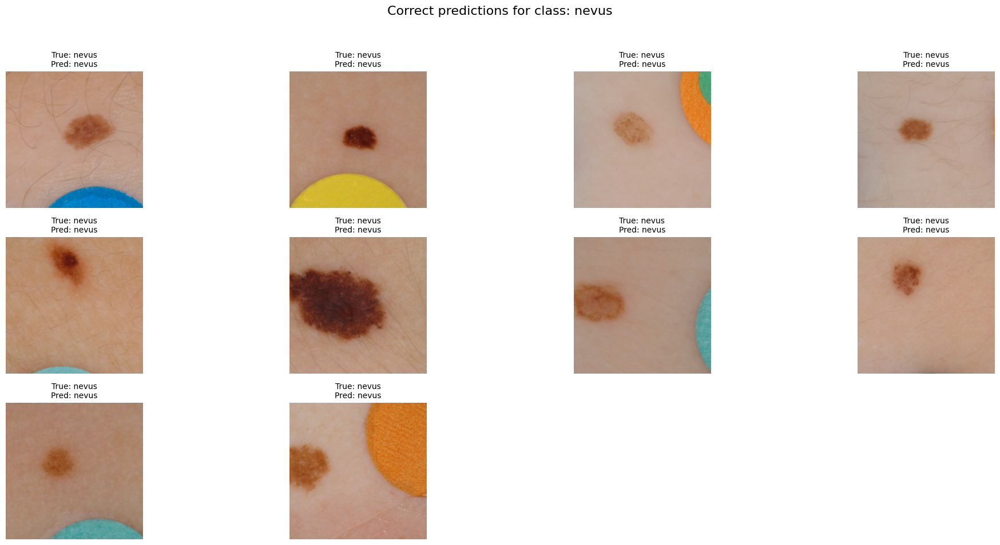

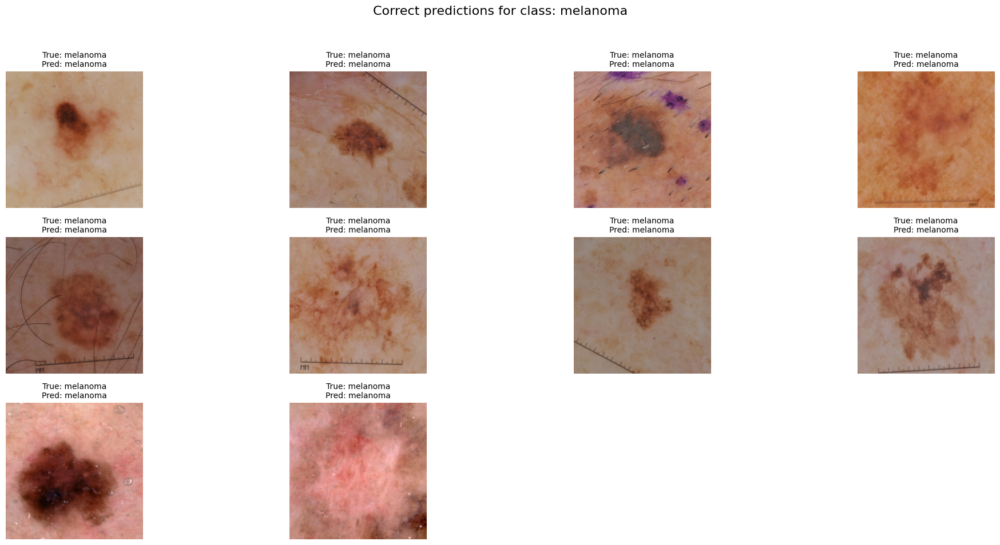

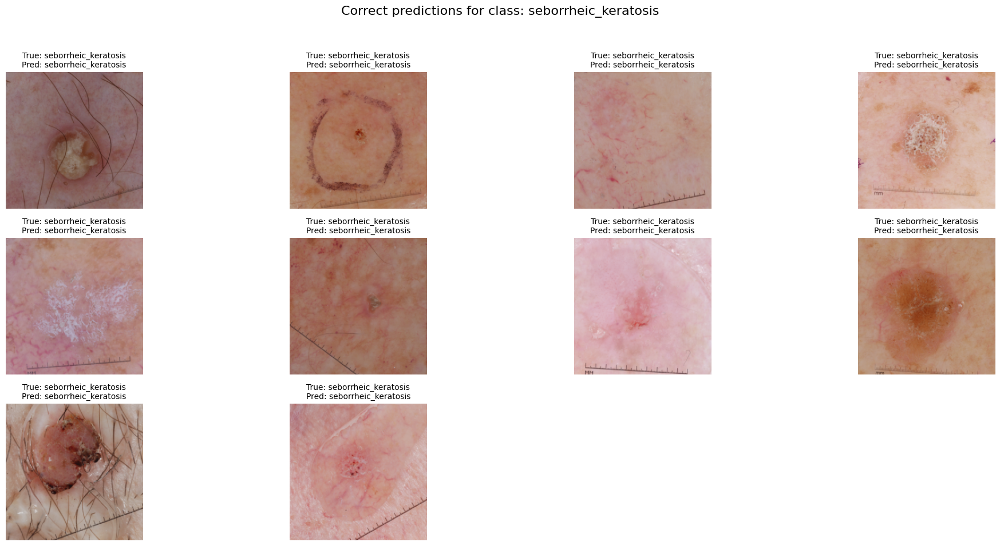

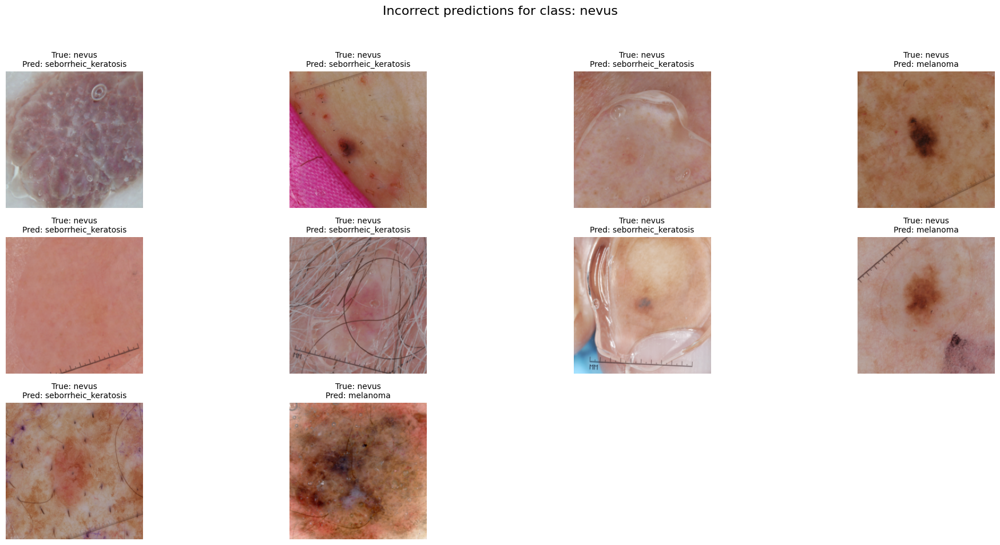

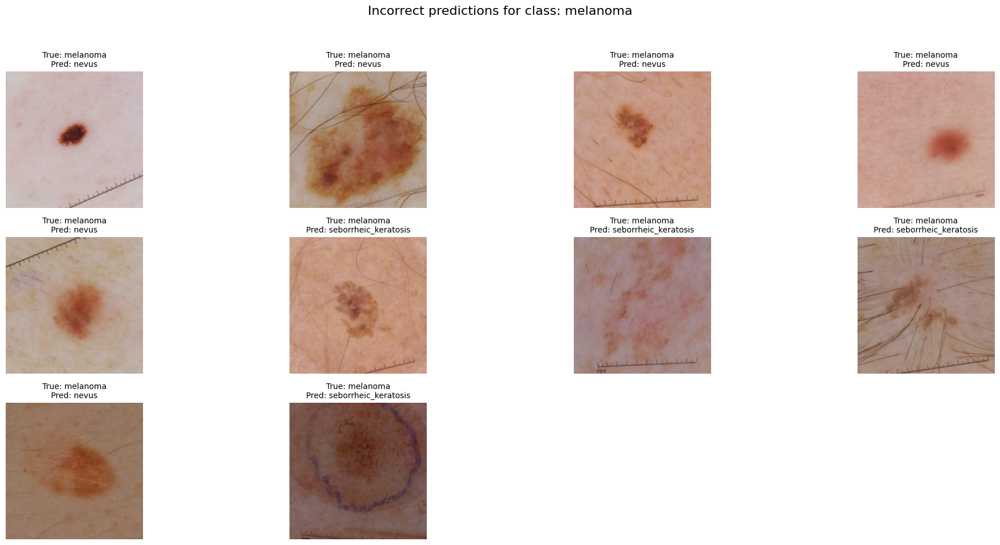

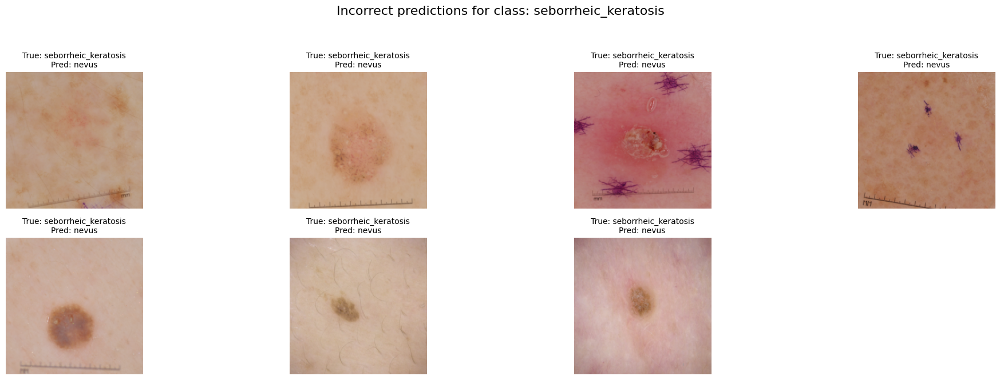

In [35]:
import matplotlib.pyplot as plt
import numpy as np

# Загрузка лучшей модели
model.load_state_dict(torch.load('best_model.pth'))
model.eval()

# Получение предсказаний для валидационного датасета
y_true, y_pred, y_probs = get_metrics(model, valid_loader)

# Словарь для хранения примеров ошибок по классам
class_examples = {cls: {'correct': [], 'incorrect': []} for cls in valid_dataset.class_to_idx.keys()}

# Собираем примеры
for i in range(len(valid_dataset)):
    true_cls = list(valid_dataset.class_to_idx.keys())[y_true[i]]
    pred_cls = list(valid_dataset.class_to_idx.keys())[y_pred[i]]
    
    if true_cls == pred_cls:
        if len(class_examples[true_cls]['correct']) < 10:
            class_examples[true_cls]['correct'].append(i)
    else:
        if len(class_examples[true_cls]['incorrect']) < 10:
            class_examples[true_cls]['incorrect'].append(i)

# Функция для отображения изображений
def plot_examples(example_indices, title):
    plt.figure(figsize=(20, 15))
    plt.suptitle(title, fontsize=16, y=1.02)
    
    for idx, example_idx in enumerate(example_indices):
        image, label = valid_dataset[example_idx]
        true_cls = list(valid_dataset.class_to_idx.keys())[label]
        
        with torch.no_grad():
            output = model(image.unsqueeze(0).to(device))
            pred = torch.argmax(output).item()
            pred_cls = list(valid_dataset.class_to_idx.keys())[pred]
        
        # Денормализация изображения
        image = image.numpy().transpose((1, 2, 0))
        mean = np.array([0.485, 0.456, 0.406])
        std = np.array([0.229, 0.224, 0.225])
        image = std * image + mean
        image = np.clip(image, 0, 1)
        
        plt.subplot(5, 4, idx+1)
        plt.imshow(image)
        plt.title(f"True: {true_cls}\nPred: {pred_cls}", fontsize=10)
        plt.axis('off')
    
    plt.tight_layout()
    plt.show()

# Визуализация корректных предсказаний
for cls in class_examples:
    examples = class_examples[cls]['correct'][:10]
    if examples:
        plot_examples(examples, f'Correct predictions for class: {cls}')
    else:
        print(f"No correct examples for class {cls}")

# Визуализация ошибок
for cls in class_examples:
    examples = class_examples[cls]['incorrect'][:10]
    if examples:
        plot_examples(examples, f'Incorrect predictions for class: {cls}')
    else:
        print(f"No incorrect examples for class {cls}")

Меланома имеет вариабельную картину и сложно отличима от других заболеваний, что объясняет низкие значения precision/recall и f1-score в классе меланомы отдельно.

# 5. Оптимизация порога вероятности для улучшения метрик класса меланомы 

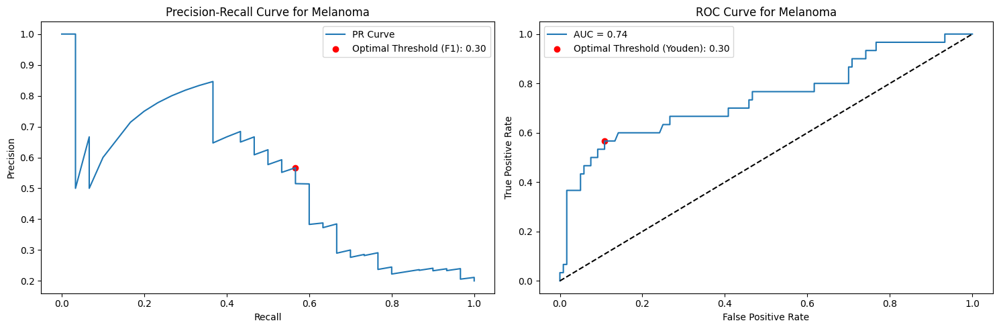


Default 0.5 Threshold (0.50) Metrics:
                      precision    recall  f1-score   support

               nevus       0.77      0.82      0.80        78
            melanoma       0.75      0.40      0.52        30
seborrheic_keratosis       0.69      0.83      0.75        42

            accuracy                           0.74       150
           macro avg       0.74      0.68      0.69       150
        weighted avg       0.74      0.74      0.73       150

ROC AUC: 0.8414

Optimal F1 Threshold (0.30) Metrics:
                      precision    recall  f1-score   support

               nevus       0.80      0.72      0.76        78
            melanoma       0.57      0.57      0.57        30
seborrheic_keratosis       0.70      0.83      0.76        42

            accuracy                           0.72       150
           macro avg       0.69      0.71      0.69       150
        weighted avg       0.73      0.72      0.72       150

ROC AUC: 0.8414

Optimal Youden T

In [36]:
import matplotlib.pyplot as plt
from sklearn.metrics import precision_recall_curve, roc_curve, auc

# 1. Получение предсказаний и вероятностей
y_true, y_pred, y_probs = get_metrics(model, valid_loader)
y_probs = np.array(y_probs)
melanoma_idx = list(valid_dataset.class_to_idx.values()).index(1)

# 2. Выделяем данные только для класса melanoma
y_true_melanoma = (np.array(y_true) == melanoma_idx).astype(int)
y_probs_melanoma = y_probs[:, melanoma_idx]

# 3. Поиск оптимального порога для melanoma
precision, recall, thresholds_pr = precision_recall_curve(y_true_melanoma, y_probs_melanoma)
f1_scores = 2 * (precision * recall) / (precision + recall + 1e-9)
optimal_idx_pr = np.argmax(f1_scores)
optimal_threshold_pr = thresholds_pr[optimal_idx_pr]

# 4. Поиск порога по критерию Youden's J
fpr, tpr, thresholds_roc = roc_curve(y_true_melanoma, y_probs_melanoma)
youden_j = tpr - fpr
optimal_idx_roc = np.argmax(youden_j)
optimal_threshold_roc = thresholds_roc[optimal_idx_roc]

# 5. Визуализация
plt.figure(figsize=(15, 5))

# Precision-Recall кривая
plt.subplot(1, 2, 1)
plt.plot(recall, precision, label='PR Curve')
plt.scatter(recall[optimal_idx_pr], precision[optimal_idx_pr], c='red', 
            label=f'Optimal Threshold (F1): {optimal_threshold_pr:.2f}')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curve for Melanoma')
plt.legend()

# ROC-кривая
plt.subplot(1, 2, 2)
plt.plot(fpr, tpr, label=f'AUC = {auc(fpr, tpr):.2f}')
plt.scatter(fpr[optimal_idx_roc], tpr[optimal_idx_roc], c='red',
           label=f'Optimal Threshold (Youden): {optimal_threshold_roc:.2f}')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve for Melanoma')
plt.legend()

plt.tight_layout()
plt.show()

# 6. Функция для применения порога
def predict_with_threshold(probs, threshold, main_class_idx):
    preds = []
    for prob in probs:
        if prob[main_class_idx] >= threshold:
            preds.append(main_class_idx)
        else:
            preds.append(np.argmax(prob))
    return preds

# 7. Сравнение метрик с разными порогами
thresholds_to_test = [
    ('Default 0.5', 0.5),
    ('Optimal F1', optimal_threshold_pr),
    ('Optimal Youden', optimal_threshold_roc)
]

for name, threshold in thresholds_to_test:
    adjusted_preds = predict_with_threshold(y_probs, threshold, melanoma_idx)
    
    print(f'\n{name} Threshold ({threshold:.2f}) Metrics:')
    print(classification_report(y_true, adjusted_preds, 
                               target_names=valid_dataset.class_to_idx.keys()))
    
    # ROC AUC для мультикласса
    print(f"ROC AUC: {roc_auc_score(np.eye(3)[y_true], y_probs, multi_class='ovr'):.4f}")

Оптимальный порог вероятности для меланомы в данном случае будет 0.3 для достижения максимальной f1-score в 0,57
Конечно же возрастет количество FP. Для получения recall 0,8 и выше нужно сделать порог 0,25 и меньше. Тогда все случаи меланомы будут по результатам работы нейросети ЗАПОДОЗРЕНЫ, чтобы доктор выполнил дерматоскопию и определил дальнейшие параметры.

In [37]:
# ВЫбираем оптимальный порог Youden
best_threshold = optimal_threshold_roc

# Применяем порог к valid set
y_true_test, _, y_probs_test = get_metrics(model, valid_loader)
adjusted_test_preds = predict_with_threshold(y_probs_test, best_threshold, melanoma_idx)

print("\nOptimized Metrics on Test Set:")
print(classification_report(y_true_test, adjusted_test_preds,
                           target_names=valid_dataset.class_to_idx.keys()))


Optimized Metrics on Test Set:
                      precision    recall  f1-score   support

               nevus       0.80      0.72      0.76        78
            melanoma       0.57      0.57      0.57        30
seborrheic_keratosis       0.70      0.83      0.76        42

            accuracy                           0.72       150
           macro avg       0.69      0.71      0.69       150
        weighted avg       0.73      0.72      0.72       150



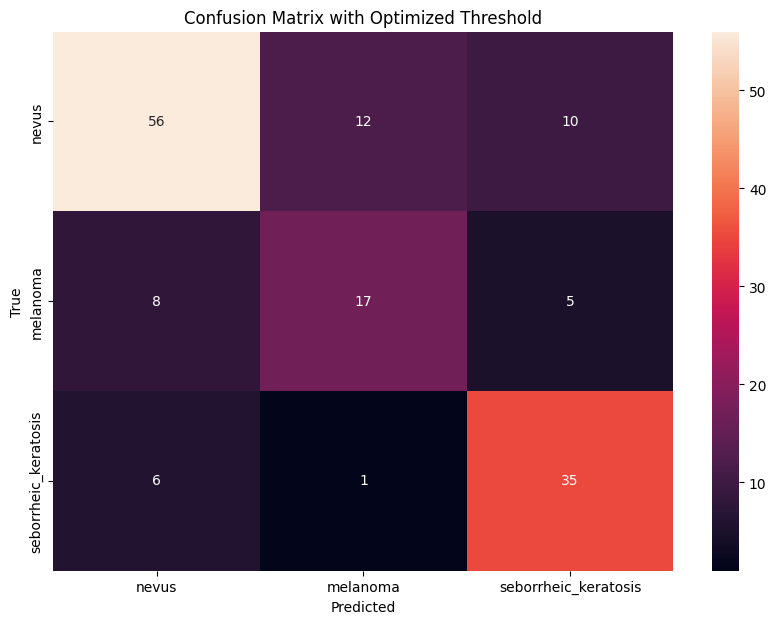

In [38]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

cm = confusion_matrix(y_true, adjusted_preds)
plt.figure(figsize=(10,7))
sns.heatmap(cm, annot=True, fmt='d', 
           xticklabels=valid_dataset.class_to_idx.keys(),
           yticklabels=valid_dataset.class_to_idx.keys())
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix with Optimized Threshold')
plt.show()

# 6. Выводы
### Таким образом:
#### - модель на основе претренированной DenseNet201 для классификации кожных изображений улучшает точность модели по сравнению с ResNet
#### - существует выраженная схожесть внешнего вида меланомы с другими классами. Для повышения recall (снижения вероятности ПРОПУСКА диагноза злокачественного новообразования) необходимо применить подбор порога вероятности диагностики меланомы. Это незначительно снижает метрики модели, зато повышает вероятность диагностики меланомы и, возможно, спасения жизни пациента. 

# 7. Постпроцессинг

In [11]:
train_metadata = pd.read_csv('train_metadata.csv')
train_metadata.head(5)

FileNotFoundError: [Errno 2] No such file or directory: 'train_metadata.csv'

In [12]:
#Загрузим таблицу train
train = pd.read_csv('/home/jupyter/datasphere/project/SkinProject/train_isic.csv')
test.info()
#Загрузим таблицу test
test = pd.read_csv('/home/jupyter/datasphere/project/SkinProject/test_isic.csv')
test.info()
#Загрузим таблицу valid
valid = pd.read_csv('/home/jupyter/datasphere/project/SkinProject/valid_isic.csv')
valid.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 600 entries, 0 to 599
Data columns (total 3 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   image_id              600 non-null    object 
 1   melanoma              600 non-null    float64
 2   seborrheic_keratosis  600 non-null    float64
dtypes: float64(2), object(1)
memory usage: 14.2+ KB
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 600 entries, 0 to 599
Data columns (total 3 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   image_id              600 non-null    object 
 1   melanoma              600 non-null    float64
 2   seborrheic_keratosis  600 non-null    float64
dtypes: float64(2), object(1)
memory usage: 14.2+ KB
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 150 entries, 0 to 149
Data columns (total 3 columns):
 #   Column                Non-Null Count  Dtype  
---  ------          

Пересоберем класс так трансформер таблиц так, чтобы он собирал метаданные из сопроводительных JSON-файлов, которые содержат данные дерматоскопии

In [13]:
import json
import pandas as pd
import os

class EnhancedTableTransformer:
    def __init__(self, base_path: str, img_extension: str = ".jpg", json_suffix: str = "_features.json"):
        self.base_path = base_path
        self.img_extension = img_extension
        self.json_suffix = json_suffix
        
    def _get_json_path(self, image_name: str):
        """Генерация пути к JSON-файлу"""
        return os.path.join(self.base_path, f"{image_name}{self.json_suffix}")
    
    def _load_json_features(self, image_name: str):
        """Загрузка данных из JSON-файла"""
        json_path = self._get_json_path(image_name)
        try:
            with open(json_path, 'r') as f:
                data = json.load(f)
            return data
        except (FileNotFoundError, json.JSONDecodeError) as e:
            print(f"Error loading JSON for {image_name}: {str(e)}")
            return {}

    def transform(self, df: pd.DataFrame) -> pd.DataFrame:
        """Основной метод трансформации с добавлением JSON-данных"""
        # Копируем и преобразуем исходную таблицу
        transformed_df = df.copy()
        
        # Добавляем пути к изображениям
        transformed_df['image_path'] = transformed_df['image_id'].apply(
            lambda x: os.path.join(self.base_path, f"{x}{self.img_extension}")
        )
        
        # Добавляем данные из JSON
        json_data = []
        for idx, row in transformed_df.iterrows():
            features = self._load_json_features(row['image_id'])
            json_data.append(features)
            
        # Создаем DataFrame из JSON-данных
        features_df = pd.json_normalize(json_data)
        
        # Объединяем с основным DataFrame
        transformed_df = pd.concat([transformed_df, features_df], axis=1)
        
        # Преобразуем диагнозы
        transformed_df['diagnosis'] = transformed_df[['melanoma', 'seborrheic_keratosis']].apply(
            lambda x: 'melanoma' if x[0] == 1 else 'seborrheic_keratosis' if x[1] == 1 else 'nevus',
            axis=1
        )
        
        return transformed_df.drop(
            columns=['melanoma', 'seborrheic_keratosis']
        )


In [15]:
# Трансформируем таблицы
transformer = EnhancedTableTransformer(
    base_path="/path/to/data",
    img_extension=".jpg",
    json_suffix="_features.json"
)
# Создадим тренировочную итоговую трансформированную таблицу
train_transformer = EnhancedTableTransformer(
    base_path="/home/jupyter/datasphere/project/SkinProject/Train"
    )
train_transformed1 = train_transformer.transform(train)
    
# Создадим тестовую итоговую трансформированную таблицу
test_transformer = EnhancedTableTransformer(
    base_path="/home/jupyter/datasphere/project/SkinProject/Test" 
    )
test_transformed1 = test_transformer.transform(test)

# Создадим валидационную итоговую трансформированную таблицу
valid_transformer = EnhancedTableTransformer(
    base_path="/home/jupyter/datasphere/project/SkinProject/Valid"
    )
valid_transformed1 = valid_transformer.transform(valid)


In [16]:
train_transformed1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2000 entries, 0 to 1999
Data columns (total 7 columns):
 #   Column            Non-Null Count  Dtype 
---  ------            --------------  ----- 
 0   image_id          2000 non-null   object
 1   image_path        2000 non-null   object
 2   pigment_network   2000 non-null   object
 3   negative_network  2000 non-null   object
 4   milia_like_cyst   2000 non-null   object
 5   streaks           2000 non-null   object
 6   diagnosis         2000 non-null   object
dtypes: object(7)
memory usage: 109.5+ KB


In [17]:
train_transformed1.head(5)

,image_id,image_path,pigment_network,negative_network,milia_like_cyst,streaks,diagnosis
0,ISIC_0000000,/home/jupyter/datasphere/project/SkinProject/T...,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",nevus
1,ISIC_0000001,/home/jupyter/datasphere/project/SkinProject/T...,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",nevus
2,ISIC_0000002,/home/jupyter/datasphere/project/SkinProject/T...,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",melanoma
3,ISIC_0000003,/home/jupyter/datasphere/project/SkinProject/T...,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",nevus
4,ISIC_0000004,/home/jupyter/datasphere/project/SkinProject/T...,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",melanoma


Оптимизируем таблицы для последующей их загрузки в общую нейросеть для визуальной обработки признаков плюс анализа дерматоскопических свойств изображений

In [19]:
import pandas as pd
import os

# Указываем базовый путь для сохранения
base_path = "/home/jupyter/datasphere/project/SkinProject"

# Создаем директорию, если она не существует
os.makedirs(base_path, exist_ok=True)

# Сохраняем таблицы в CSV
datasets = {
    'train': train_transformed1,
    'test': test_transformed1,
    'valid': valid_transformed1
}

for name, df in datasets.items():
    try:
        file_path = os.path.join(base_path, f"{name}_transformed1.csv")
        df.to_csv(file_path, index=False, encoding='utf-8')
        print(f"Таблица {name}_transformed1 успешно сохранена в:\n{file_path}")
        print(f"Размер таблицы: {df.shape}\nПервые 3 строки:")
        print(df.head(3), "\n" + "-"*50 + "\n")
        
    except Exception as e:
        print(f"Ошибка при сохранении {name}_transformed1:")
        print(str(e))
        print("\n" + "="*50 + "\n")

print("Сохранение всех таблиц завершено!")

Таблица train_transformed1 успешно сохранена в:
/home/jupyter/datasphere/project/SkinProject/train_transformed1.csv
Размер таблицы: (2000, 7)
Первые 3 строки:
       image_id  ... diagnosis
0  ISIC_0000000  ...     nevus
1  ISIC_0000001  ...     nevus
2  ISIC_0000002  ...  melanoma

[3 rows x 7 columns] 
--------------------------------------------------

Таблица test_transformed1 успешно сохранена в:
/home/jupyter/datasphere/project/SkinProject/test_transformed1.csv
Размер таблицы: (600, 7)
Первые 3 строки:
       image_id  ...             diagnosis
0  ISIC_0012086  ...  seborrheic_keratosis
1  ISIC_0012092  ...                 nevus
2  ISIC_0012095  ...                 nevus

[3 rows x 7 columns] 
--------------------------------------------------

Таблица valid_transformed1 успешно сохранена в:
/home/jupyter/datasphere/project/SkinProject/valid_transformed1.csv
Размер таблицы: (150, 7)
Первые 3 строки:
       image_id  ... diagnosis
0  ISIC_0001769  ...     nevus
1  ISIC_0001852  ..

In [23]:
import pandas as pd
import numpy as np
from ast import literal_eval

def optimize_table(df):
    # Преобразование строковых представлений списков в настоящие списки
    list_columns = ['pigment_network', 'negative_network', 
                   'milia_like_cyst', 'streaks']
    
    for col in list_columns:
        df[col] = df[col].apply(literal_eval)

    # Анализ структуры признаков
    def analyze_feature(feature_list):
        unique = np.unique(feature_list)
        return {
            'length': len(feature_list),
            'nonzero_count': np.count_nonzero(feature_list),
            'mean': np.mean(feature_list),
            'unique_values': unique
        }

    # Оптимизация признаков
    def process_feature_columns(df):
        features_config = {}
        
        for col in list_columns:
            # Пример: создаем 2 новых признака вместо исходного списка
            df[f'{col}_count'] = df[col].apply(lambda x: sum(x))
            df[f'{col}_present'] = df[col].apply(lambda x: int(any(x)))
            
            # Сохраняем метаданные для документации
            sample = df[col].iloc[0]
            features_config[col] = analyze_feature(sample)
            
            # Удаляем исходный столбец
            df = df.drop(columns=[col])
        
        print("Feature configuration:")
        print(pd.DataFrame(features_config).T)
        return df

    # Преобразование признаков
    df = process_feature_columns(df)

    # Оптимизация путей
    df['image_id'] = df['image_id'].apply(lambda x: x.split('.')[0])
    
    # Кодирование диагноза
    diagnosis_map = {'nevus': 0, 'melanoma': 1, 'seborrheic_keratosis': 2}
    df['diagnosis'] = df['diagnosis'].map(diagnosis_map).astype('int8')
    
    # Оптимизация типов данных
    int_cols = df.select_dtypes(include=['int64']).columns
    df[int_cols] = df[int_cols].astype('int8')
    
    float_cols = df.select_dtypes(include=['float64']).columns
    df[float_cols] = df[float_cols].astype('float32')
    
    return df

# Обработка всех таблиц
for name in ['train', 'test', 'valid']:
    df = pd.read_csv(base_path+f'/{name}_transformed1.csv')
    df = optimize_table(df)
    
    # Сохранение оптимизированной таблицы
    df.to_csv(f'{name}_optimized.csv', index=False)
    print(f"Processed {name} dataset. New shape: {df.shape}")
    print(df.head())

Feature configuration:
                 length nonzero_count      mean unique_values
pigment_network     996           201  0.201807        [0, 1]
negative_network    996             0       0.0           [0]
milia_like_cyst     996             0       0.0           [0]
streaks             996            64  0.064257        [0, 1]
Processed train dataset. New shape: (2000, 11)
       image_id  ... streaks_present
0  ISIC_0000000  ...               1
1  ISIC_0000001  ...               1
2  ISIC_0000002  ...               0
3  ISIC_0000003  ...               0
4  ISIC_0000004  ...               0

[5 rows x 11 columns]
Feature configuration:
                 length nonzero_count mean unique_values
pigment_network    1009             0  0.0           [0]
negative_network   1009             0  0.0           [0]
milia_like_cyst    1009             0  0.0           [0]
streaks            1009             0  0.0           [0]
Processed test dataset. New shape: (600, 11)
       image_id  ... s

In [2]:
import pandas as pd
import os

# Путь к директории с данными
base_path = "/home/jupyter/datasphere/project"

# Список наборов данных
datasets = ['train', 'test', 'valid']

# Загрузка данных в переменные
train_new, test_new, valid_new = (pd.read_csv(os.path.join(base_path, f"{name}_optimized.csv")) 
                                  for name in datasets)

# Проверка загрузки
def check_dataset(df, name):
    print(f"{name}_new:")
    print(f"Размер: {df.shape}")
    print("Первые 3 строки:")
    display(df.head(3))
    print("\n" + "="*50 + "\n")

check_dataset(train_new, 'train')
check_dataset(test_new, 'test')
check_dataset(valid_new, 'valid')

train_new:
Размер: (2000, 11)
Первые 3 строки:


,image_id,image_path,diagnosis,pigment_network_count,pigment_network_present,negative_network_count,negative_network_present,milia_like_cyst_count,milia_like_cyst_present,streaks_count,streaks_present
0,ISIC_0000000,/home/jupyter/datasphere/project/SkinProject/T...,0,-55,1,0,0,0,0,64,1
1,ISIC_0000001,/home/jupyter/datasphere/project/SkinProject/T...,0,14,1,0,0,0,0,17,1
2,ISIC_0000002,/home/jupyter/datasphere/project/SkinProject/T...,1,0,0,0,0,62,1,0,0




test_new:
Размер: (600, 11)
Первые 3 строки:


,image_id,image_path,diagnosis,pigment_network_count,pigment_network_present,negative_network_count,negative_network_present,milia_like_cyst_count,milia_like_cyst_present,streaks_count,streaks_present
0,ISIC_0012086,/home/jupyter/datasphere/project/SkinProject/T...,2,0,0,0,0,0,0,0,0
1,ISIC_0012092,/home/jupyter/datasphere/project/SkinProject/T...,0,9,1,9,1,1,1,0,0
2,ISIC_0012095,/home/jupyter/datasphere/project/SkinProject/T...,0,5,1,0,0,0,0,0,0




valid_new:
Размер: (150, 11)
Первые 3 строки:


,image_id,image_path,diagnosis,pigment_network_count,pigment_network_present,negative_network_count,negative_network_present,milia_like_cyst_count,milia_like_cyst_present,streaks_count,streaks_present
0,ISIC_0001769,/home/jupyter/datasphere/project/SkinProject/V...,0,33,1,0,0,0,0,0,0
1,ISIC_0001852,/home/jupyter/datasphere/project/SkinProject/V...,0,0,0,0,0,0,0,0,0
2,ISIC_0001871,/home/jupyter/datasphere/project/SkinProject/V...,0,0,0,0,0,1,1,0,0


В директории создан файл early_stopping.py для сохранения наилучшей модели.

In [30]:
def check_diagnosis_column(df, df_name):
    print(f"\n{'='*50}\nChecking dataset: {df_name}\n{'='*50}")
    
    # Проверка наличия столбца
    if 'diagnosis' not in df.columns:
        print(f"❌ ERROR: Column 'diagnosis' missing in {df_name}")
        return
    
    # Проверка пропущенных значений
    null_count = df['diagnosis'].isnull().sum()
    if null_count > 0:
        print(f"❌ ERROR: Found {null_count} NaN values in 'diagnosis' column")
    else:
        print("✅ No missing values in 'diagnosis' column")
    
    # Проверка допустимых значений
    unique_values = df['diagnosis'].unique()
    
    # Случай 1: Строковые метки
    if df['diagnosis'].dtype == object:
        valid_str_labels = {'nevus', 'melanoma', 'seborrheic_keratosis'}
        unexpected = [v for v in unique_values if v not in valid_str_labels]
        
        if unexpected:
            print(f"❌ ERROR: Found unexpected string values: {unexpected}")
        else:
            print(f"✅ All string values are valid: {unique_values}")

    # Случай 2: Числовые метки
    elif df['diagnosis'].dtype in [np.int64, np.float64]:
        valid_numeric_labels = {0, 1, 2}
        unexpected = [v for v in unique_values if v not in valid_numeric_labels]
        
        if unexpected:
            print(f"❌ ERROR: Found unexpected numeric values: {unexpected}")
        else:
            print(f"✅ All numeric values are valid: {unique_values}")

    # Неожиданный тип данных
    else:
        print(f"❌ ERROR: Unexpected dtype {df['diagnosis'].dtype} for 'diagnosis' column")

# Проверяем все датасеты
for df, name in zip([train_new, test_new, valid_new], ['train_new', 'test_new', 'valid_new']):
    check_diagnosis_column(df, name)
    print("\n")


Checking dataset: train_new
✅ No missing values in 'diagnosis' column
✅ All numeric values are valid: [0 1 2]



Checking dataset: test_new
✅ No missing values in 'diagnosis' column
✅ All numeric values are valid: [2 0 1]



Checking dataset: valid_new
✅ No missing values in 'diagnosis' column
✅ All numeric values are valid: [0 1 2]




Downloading: "https://download.pytorch.org/models/densenet121-a639ec97.pth" to /tmp/xdg_cache/torch/hub/checkpoints/densenet121-a639ec97.pth
100%|██████████| 30.8M/30.8M [00:00<00:00, 39.6MB/s]
Validating: 100%|██████████| 38/38 [06:05<00:00,  9.61s/it]

Validation loss decreased (inf --> 0.623803). Saving model...



Epoch 1 Results:
Train Loss: 0.7565 | Acc: 0.6950
Test Loss: 0.6238 | Acc: 0.7200
--------------------------------------------------


Validating: 100%|██████████| 38/38 [06:02<00:00,  9.54s/it]


EarlyStopping counter: 1 out of 5

Epoch 2 Results:
Train Loss: 0.6264 | Acc: 0.7425
Test Loss: 0.6455 | Acc: 0.7167
--------------------------------------------------


Validating: 100%|██████████| 38/38 [01:12<00:00,  1.91s/it]


Validation loss decreased (0.623803 --> 0.579127). Saving model...

Epoch 3 Results:
Train Loss: 0.6088 | Acc: 0.7490
Test Loss: 0.5791 | Acc: 0.7500
--------------------------------------------------


Validating: 100%|██████████| 38/38 [06:04<00:00,  9.58s/it]


EarlyStopping counter: 1 out of 5

Epoch 4 Results:
Train Loss: 0.5808 | Acc: 0.7650
Test Loss: 0.9300 | Acc: 0.5933
--------------------------------------------------


Validating: 100%|██████████| 38/38 [01:14<00:00,  1.97s/it]


EarlyStopping counter: 2 out of 5

Epoch 5 Results:
Train Loss: 0.5472 | Acc: 0.7815
Test Loss: 0.6410 | Acc: 0.7450
--------------------------------------------------


Validating: 100%|██████████| 38/38 [06:04<00:00,  9.60s/it]


EarlyStopping counter: 3 out of 5

Epoch 6 Results:
Train Loss: 0.5090 | Acc: 0.7915
Test Loss: 0.6192 | Acc: 0.7517
--------------------------------------------------


Validating: 100%|██████████| 38/38 [01:15<00:00,  1.98s/it]


Validation loss decreased (0.579127 --> 0.540225). Saving model...

Epoch 7 Results:
Train Loss: 0.5010 | Acc: 0.7900
Test Loss: 0.5402 | Acc: 0.7783
--------------------------------------------------


Validating: 100%|██████████| 38/38 [06:04<00:00,  9.60s/it]


EarlyStopping counter: 1 out of 5

Epoch 8 Results:
Train Loss: 0.4852 | Acc: 0.8040
Test Loss: 0.5639 | Acc: 0.7700
--------------------------------------------------


Validating: 100%|██████████| 38/38 [01:14<00:00,  1.97s/it]


EarlyStopping counter: 2 out of 5

Epoch 9 Results:
Train Loss: 0.4619 | Acc: 0.8150
Test Loss: 0.5946 | Acc: 0.7600
--------------------------------------------------


Validating: 100%|██████████| 38/38 [06:02<00:00,  9.53s/it]


Validation loss decreased (0.540225 --> 0.518074). Saving model...

Epoch 10 Results:
Train Loss: 0.4445 | Acc: 0.8105
Test Loss: 0.5181 | Acc: 0.7850
--------------------------------------------------


Validating: 100%|██████████| 38/38 [01:15<00:00,  1.98s/it]


EarlyStopping counter: 1 out of 5

Epoch 11 Results:
Train Loss: 0.4250 | Acc: 0.8275
Test Loss: 0.5730 | Acc: 0.7783
--------------------------------------------------


Validating: 100%|██████████| 38/38 [06:04<00:00,  9.60s/it]


EarlyStopping counter: 2 out of 5

Epoch 12 Results:
Train Loss: 0.3967 | Acc: 0.8390
Test Loss: 0.5637 | Acc: 0.7867
--------------------------------------------------


Validating: 100%|██████████| 38/38 [01:15<00:00,  1.98s/it]


EarlyStopping counter: 3 out of 5

Epoch 13 Results:
Train Loss: 0.4291 | Acc: 0.8320
Test Loss: 0.5539 | Acc: 0.7750
--------------------------------------------------


Validating: 100%|██████████| 38/38 [06:04<00:00,  9.60s/it]


EarlyStopping counter: 4 out of 5

Epoch 14 Results:
Train Loss: 0.4021 | Acc: 0.8390
Test Loss: 0.5246 | Acc: 0.7967
--------------------------------------------------


Validating: 100%|██████████| 38/38 [01:14<00:00,  1.96s/it]


Validation loss decreased (0.518074 --> 0.483281). Saving model...

Epoch 15 Results:
Train Loss: 0.3585 | Acc: 0.8540
Test Loss: 0.4833 | Acc: 0.8317
--------------------------------------------------


Validating: 100%|██████████| 38/38 [06:05<00:00,  9.61s/it]


EarlyStopping counter: 1 out of 5

Epoch 16 Results:
Train Loss: 0.3170 | Acc: 0.8810
Test Loss: 0.5052 | Acc: 0.8350
--------------------------------------------------


Validating: 100%|██████████| 38/38 [01:15<00:00,  1.98s/it]


EarlyStopping counter: 2 out of 5

Epoch 17 Results:
Train Loss: 0.3281 | Acc: 0.8680
Test Loss: 0.4990 | Acc: 0.8233
--------------------------------------------------


Validating: 100%|██████████| 38/38 [06:01<00:00,  9.50s/it]


EarlyStopping counter: 3 out of 5

Epoch 18 Results:
Train Loss: 0.2968 | Acc: 0.8860
Test Loss: 0.4959 | Acc: 0.8300
--------------------------------------------------


Validating: 100%|██████████| 38/38 [01:14<00:00,  1.97s/it]


EarlyStopping counter: 4 out of 5

Epoch 19 Results:
Train Loss: 0.2921 | Acc: 0.8870
Test Loss: 0.5079 | Acc: 0.8250
--------------------------------------------------


Validating: 100%|██████████| 38/38 [06:04<00:00,  9.60s/it]

EarlyStopping counter: 5 out of 5
Early stopping triggered


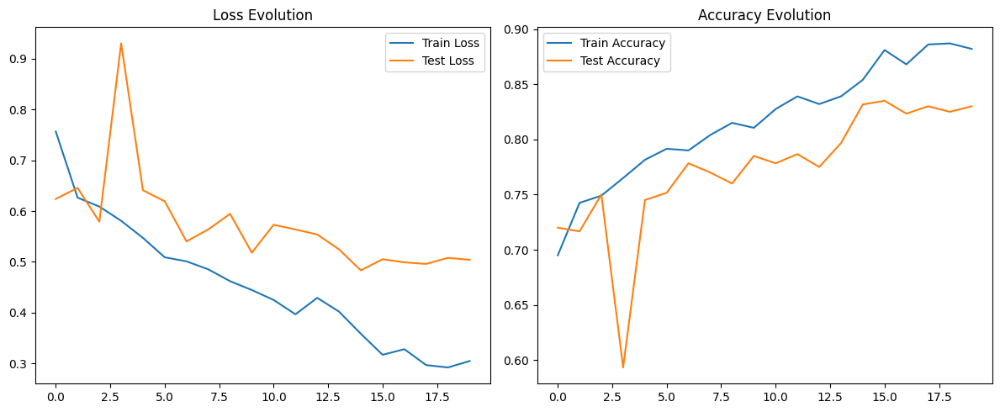


Full model saved to: /home/jupyter/datasphere/project/full_model.pt

Classification Report:
              precision    recall  f1-score   support

           0       0.79      0.94      0.86        78
           1       0.65      0.37      0.47        30
           2       0.93      0.90      0.92        42

    accuracy                           0.81       150
   macro avg       0.79      0.74      0.75       150
weighted avg       0.80      0.81      0.80       150


ROC AUC Scores:
Macro Average: 0.9392
Micro Average: 0.9552


In [ ]:
#Вставляем класс из нашего файла, чтобы работала ранняя остановка
from early_stopping import EarlyStopping
#Создаем полный пайплайн работы комбинированной нейросети DenseNet201 с обработкой новых табличных данных
import torch
import torch.nn as nn
from torchvision import models, transforms
from torch.utils.data import Dataset, DataLoader
from torch.optim.lr_scheduler import ReduceLROnPlateau
import pandas as pd
import numpy as np
import cv2
from PIL import Image
from tqdm import tqdm
import matplotlib.pyplot as plt
from sklearn.metrics import classification_report, roc_auc_score
from early_stopping import EarlyStopping  # Убедитесь, что установлен пакет pytorchtools

# Конфигурация
BASE_PATH = "/home/jupyter/datasphere/project/SkinProject"
BATCH_SIZE = 16
NUM_EPOCHS = 20
NUM_IMAGE_FEATURES = 1024  # Для DenseNet121
NUM_TABULAR_FEATURES = len(train_new.columns) - 2  # Исключаем image_id и diagnosis

# Аугментации
train_transform = transforms.Compose([
    transforms.Resize(256),
    transforms.RandomResizedCrop(224),
    transforms.RandomHorizontalFlip(),
    transforms.RandomVerticalFlip(),
    transforms.RandomRotation(15),
    transforms.ColorJitter(brightness=0.1, contrast=0.1, saturation=0.1),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

test_transform = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

# Кастомный датасет
# В классе HybridDataset отметим получение пути к изображению
# ... (предыдущий код без изменений)

class HybridDataset(Dataset):
    def __init__(self, df, base_path, transform=None):
        self.df = df
        self.base_path = base_path
        self.transform = transform
        
        # Исключаем все нечисловые колонки
        self.tabular_features = df.select_dtypes(include=['number']).columns.tolist()
        
        # Проверяем, закодирован ли diagnosis числовыми значениями
        if df['diagnosis'].dtype == np.int64 or df['diagnosis'].dtype == np.float64:
            self.class_map = None  # Метки уже числовые
        else:
            self.class_map = {'nevus': 0, 'melanoma': 1, 'seborrheic_keratosis': 2}

    def __len__(self):
        return len(self.df)

    def __getitem__(self, idx):
        row = self.df.iloc[idx]
        img_path = os.path.join(self.base_path, f"{row['image_id']}.jpg")
        
        img = Image.open(img_path).convert('RGB')
        if self.transform:
            img = self.transform(img)
            
        tab_data = row[self.tabular_features].astype(np.float32).values
        tab_tensor = torch.FloatTensor(tab_data)
        
        # Получаем метку в зависимости от её типа
        if self.class_map is not None:
            label = torch.tensor(self.class_map[row['diagnosis']])
        else:
            label = torch.tensor(row['diagnosis'], dtype=torch.long)
        
        return (img, tab_tensor), label

# При создании датасетов передаем базовый путь
def create_loaders():
    #пути к изображениям
    base_data_path_train = "/home/jupyter/datasphere/project/SkinProject/Train"  
    base_data_path_test = "/home/jupyter/datasphere/project/SkinProject/Test"
    base_data_path_valid = "/home/jupyter/datasphere/project/SkinProject/Valid"
    #датасеты по путям (папкам)
    train_dataset = HybridDataset(train_new, base_path=base_data_path_train, transform=train_transform)
    test_dataset = HybridDataset(test_new, base_path=base_data_path_test, transform=test_transform)
    valid_dataset = HybridDataset(valid_new, base_path=base_data_path_valid, transform=test_transform)

    loaders = {
        'train': DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=4),
        'test': DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=False, num_workers=4),
        'valid': DataLoader(valid_dataset, batch_size=BATCH_SIZE, shuffle=False, num_workers=4)
    }
    return loaders

# Инициализация модели
class HybridDenseNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.cnn = models.densenet121(pretrained=True)
        self.cnn.classifier = nn.Linear(self.cnn.classifier.in_features, NUM_IMAGE_FEATURES)
        
        self.tabular_fc = nn.Sequential(
            nn.Linear(NUM_TABULAR_FEATURES, 64),
            nn.ReLU(),
            nn.Dropout(0.3)
        )
        
        self.final_classifier = nn.Sequential(
            nn.Linear(NUM_IMAGE_FEATURES + 64, 256),
            nn.ReLU(),
            nn.Dropout(0.4),
            nn.Linear(256, 3)
        )

    def forward(self, img, tab):
        img_features = self.cnn(img)
        tab_features = self.tabular_fc(tab)
        combined = torch.cat([img_features, tab_features], dim=1)
        return self.final_classifier(combined)

# Функции обучения
def train_model(model, loaders):
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    model = model.to(device)
    
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.AdamW(model.parameters(), lr=1e-4)
    scheduler = ReduceLROnPlateau(optimizer, 'min', patience=3)
    early_stopping = EarlyStopping(patience=5, verbose=True)
    
    history = {'train_loss': [], 'test_loss': [], 'train_acc': [], 'test_acc': []}
    
    for epoch in range(NUM_EPOCHS):
        # Фаза обучения
        model.train()
        train_loss = 0.0
        correct = 0
        total = 0
        
        for (images, tabs), labels in tqdm(loaders['train'], desc=f'Epoch {epoch+1}/{NUM_EPOCHS} - Train'):
            images, tabs, labels = images.to(device), tabs.to(device), labels.to(device)
            
            optimizer.zero_grad()
            outputs = model(images, tabs)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()
            
            train_loss += loss.item()
            _, predicted = outputs.max(1)
            total += labels.size(0)
            correct += predicted.eq(labels).sum().item()
        
        train_acc = correct / total
        train_loss = train_loss / len(loaders['train'])
        
        # Фаза валидации
        test_loss, test_acc = validate(model, loaders['test'], criterion, device)
        
        # Обновление истории
        history['train_loss'].append(train_loss)
        history['test_loss'].append(test_loss)
        history['train_acc'].append(train_acc)
        history['test_acc'].append(test_acc)
        
        # Планировщик и ранняя остановка
        scheduler.step(test_loss)
        early_stopping(test_loss, model)
        
        if early_stopping.early_stop:
            print("Early stopping triggered")
            break
            
        # Вывод метрик
        print(f'\nEpoch {epoch+1} Results:')
        print(f'Train Loss: {train_loss:.4f} | Acc: {train_acc:.4f}')
        print(f'Test Loss: {test_loss:.4f} | Acc: {test_acc:.4f}')
        print('-' * 50)
    
    return history

def validate(model, loader, criterion, device):
    model.eval()
    test_loss = 0.0
    correct = 0
    total = 0
    
    with torch.no_grad():
        for (images, tabs), labels in tqdm(loader, desc='Validating'):
            images, tabs, labels = images.to(device), tabs.to(device), labels.to(device)
            
            outputs = model(images, tabs)
            loss = criterion(outputs, labels)
            
            test_loss += loss.item()
            _, predicted = outputs.max(1)
            total += labels.size(0)
            correct += predicted.eq(labels).sum().item()
    
    return test_loss / len(loader), correct / total

# Визуализация обучения
def plot_training(history):
    plt.figure(figsize=(12, 5))
    
    plt.subplot(1, 2, 1)
    plt.plot(history['train_loss'], label='Train Loss')
    plt.plot(history['test_loss'], label='Test Loss')
    plt.title('Loss Evolution')
    plt.legend()
    
    plt.subplot(1, 2, 2)
    plt.plot(history['train_acc'], label='Train Accuracy')
    plt.plot(history['test_acc'], label='Test Accuracy')
    plt.title('Accuracy Evolution')
    plt.legend()
    
    plt.tight_layout()
    plt.show()

def get_metrics(model, loader, device):
    model.eval()
    all_labels = []
    all_preds = []
    all_probs = []
    
    with torch.no_grad():
        for (images, tabs), labels in loader:
            images = images.to(device)
            tabs = tabs.to(device)
            
            outputs = model(images, tabs)
            probs = torch.softmax(outputs, dim=1)
            _, preds = torch.max(outputs, 1)
            
            all_labels.extend(labels.cpu().numpy())
            all_preds.extend(preds.cpu().numpy())
            all_probs.extend(probs.cpu().numpy())
    
    return all_labels, all_preds, np.array(all_probs)

# основной блок
if __name__ == "__main__":
    loaders = create_loaders()
    model = HybridDenseNet()
    history = train_model(model, loaders)
    plot_training(history)
    
    # Оценка на валидационном наборе
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    model.load_state_dict(torch.load('checkpoint.pt'))
    
    # Сохраняем полную модель
    model_save_path = '/home/jupyter/datasphere/project/full_model.pt'
    torch.save(model, model_save_path)
    print(f"\nFull model saved to: {model_save_path}")
    
    # Получаем метрики
    y_true, y_pred, y_probs = get_metrics(model, loaders['valid'], device)
    
    # Для совместимости с class_map из датасета
    class_names = list(loaders['valid'].dataset.class_map.keys()) if loaders['valid'].dataset.class_map else ['0', '1', '2']
    
    print("\nClassification Report:")
    print(classification_report(y_true, y_pred, target_names=class_names))
    
    print("\nROC AUC Scores:")
    try:
        # Для multi-class
        print(f"Macro Average: {roc_auc_score(y_true, y_probs, multi_class='ovr', average='macro'):.4f}")
        print(f"Micro Average: {roc_auc_score(y_true, y_probs, multi_class='ovr', average='micro'):.4f}")
    except Exception as e:
        print(f"Error calculating ROC AUC: {str(e)}")

Получили хорошие метрики (лучше, чем предыдущие модели), но все равно остается проблема с выявлением меланомы. Так как меланома является клинически очень значимым заболеванием, которое может првиести к метастазам и увеличивает общий риск смерти для пациента, такая патология не должна быт ьпропущена. Нам нужно подобрать такой порог, чтобы повысить распознаваемость моделью меланомы. 

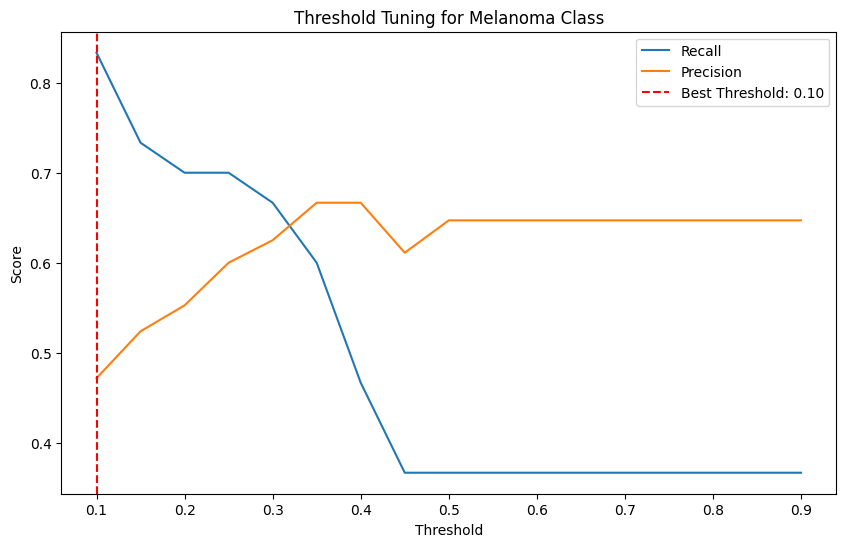

Optimal threshold for melanoma: 0.10

Class: nevus (0)
Accuracy: 57/78 (73.1%)



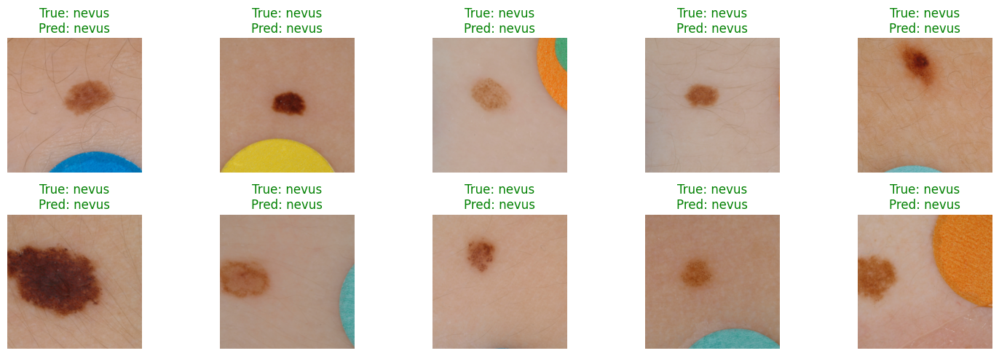


Class: melanoma (1)
Accuracy: 25/30 (83.3%)



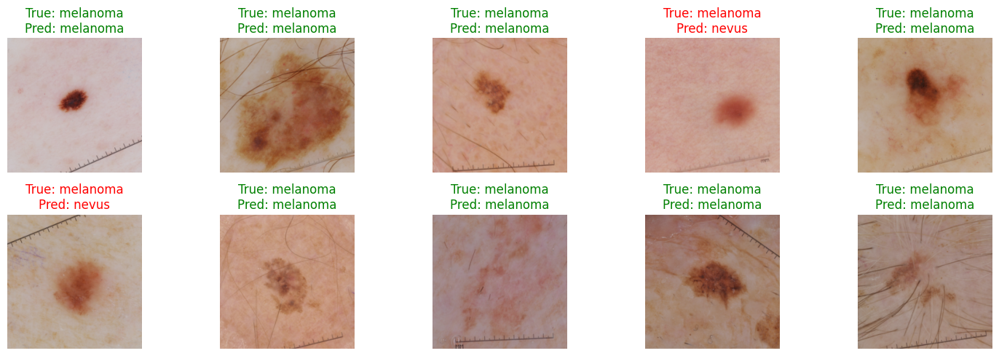


Class: seborrheic_keratosis (2)
Accuracy: 33/42 (78.6%)



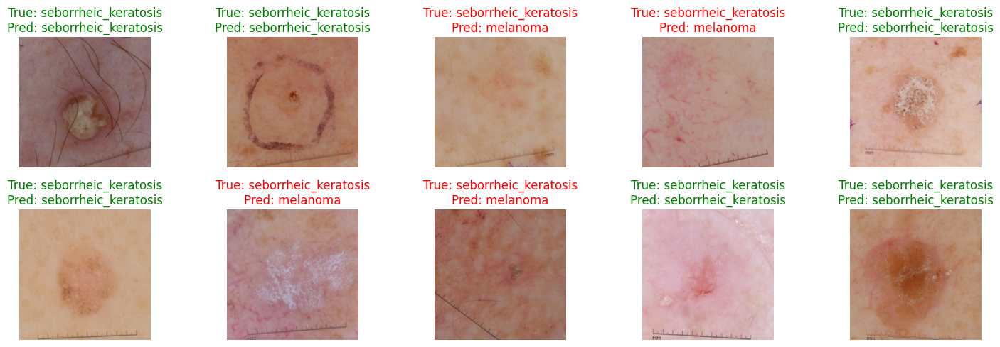

Model saved to /home/jupyter/datasphere/project/skin_cancer_model.pth with threshold 0.10


In [4]:
import matplotlib.pyplot as plt
import os
from PIL import Image
import numpy as np

# 1. Подбор оптимального порога для класса 1 (melanoma)
def find_optimal_threshold(y_true, y_probs, target_class=1):
    thresholds = np.linspace(0.1, 0.9, 17)
    best_recall = 0
    best_threshold = 0.5
    recalls = []
    precisions = []
    
    for thresh in thresholds:
        adjusted_preds = []
        for prob in y_probs:
            if prob[target_class] > thresh:
                adjusted_preds.append(target_class)
            else:
                adjusted_preds.append(np.argmax(prob))
                
        report = classification_report(y_true, adjusted_preds, output_dict=True)
        recall = report[str(target_class)]['recall']
        precision = report[str(target_class)]['precision']
        recalls.append(recall)
        precisions.append(precision)
        
        if recall > best_recall:
            best_recall = recall
            best_threshold = thresh

    # Визуализация
    plt.figure(figsize=(10, 6))
    plt.plot(thresholds, recalls, label='Recall')
    plt.plot(thresholds, precisions, label='Precision')
    plt.xlabel('Threshold')
    plt.ylabel('Score')
    plt.title('Threshold Tuning for Melanoma Class')
    plt.axvline(best_threshold, color='r', linestyle='--', label=f'Best Threshold: {best_threshold:.2f}')
    plt.legend()
    plt.show()
    
    return best_threshold

# 2. Получаем оптимальный порог
best_threshold = find_optimal_threshold(y_true, y_probs, target_class=1)
print(f"Optimal threshold for melanoma: {best_threshold:.2f}")

# 3. Функция для показа примеров предсказаний
def show_predictions_samples(loader, model, device, threshold, class_names, num_samples=10):
    model.eval()
    samples = {0: [], 1: [], 2: []}  # Собираем примеры по классам
    class_correct = {0: 0, 1: 0, 2: 0}
    class_total = {0: 0, 1: 0, 2: 0}
    
    with torch.no_grad():
        for (images, tabs), labels in loader:
            images, tabs = images.to(device), tabs.to(device)
            outputs = model(images, tabs)
            probs = torch.softmax(outputs, dim=1).cpu().numpy()
            
            for i in range(len(labels)):
                true_class = labels[i].item()
                class_total[true_class] += 1
                
                # Применяем пороговую логику только для класса 1
                if probs[i][1] > threshold:
                    pred_class = 1
                else:
                    pred_class = np.argmax(probs[i])
                
                # Сохраняем примеры
                if len(samples[true_class]) < num_samples:
                    samples[true_class].append({
                        'image': images[i].cpu(),
                        'true': true_class,
                        'pred': pred_class,
                        'probs': probs[i]
                    })
                
                if pred_class == true_class:
                    class_correct[true_class] += 1

    # Выводим примеры
    for class_id in samples:
        print(f"\nClass: {class_names[class_id]} ({class_id})")
        print(f"Accuracy: {class_correct[class_id]}/{class_total[class_id]} ({100.*class_correct[class_id]/class_total[class_id]:.1f}%)\n")
        
        plt.figure(figsize=(15, 5))
        for i, sample in enumerate(samples[class_id][:10]):
            plt.subplot(2, 5, i+1)
            img = sample['image'].permute(1, 2, 0).numpy()
            img = img * np.array([0.229, 0.224, 0.225]) + np.array([0.485, 0.456, 0.406])  # Denormalize
            plt.imshow(np.clip(img, 0, 1))
            
            title_color = 'green' if sample['pred'] == sample['true'] else 'red'
            plt.title(f"True: {class_names[sample['true']]}\nPred: {class_names[sample['pred']]}", 
                      color=title_color)
            plt.axis('off')
        plt.tight_layout()
        plt.show()

# 4. Показываем примеры с новым порогом
class_names = ['nevus', 'melanoma', 'seborrheic_keratosis']
show_predictions_samples(loaders['valid'], model, device, best_threshold, class_names)

# 5. Сохранение финальной модели с порогом
import json

# Сохраняем модель + метаданные
model_data = {
    'model_state': model.state_dict(),
    'threshold': best_threshold,
    'class_names': class_names,
    'tabular_features': loaders['valid'].dataset.tabular_features
}

save_path = '/home/jupyter/datasphere/project/skin_cancer_model.pth'
torch.save(model_data, save_path)
print(f"Model saved to {save_path} with threshold {best_threshold:.2f}")

# Для загрузки:
def load_custom_model(path, device='cpu'):
    data = torch.load(path, map_location=device)
    
    # Создаем модель
    model = HybridDenseNet()
    model.load_state_dict(data['model_state'])
    model.eval()
    
    return model, data

# Пример загрузки модели для дальнейшего использования (не запускать код)
#loaded_model, model_info = load_custom_model(save_path)
#print(f"Loaded model with threshold {model_info['threshold']} and classes {model_info['class_names']}")

На примере точность распознавания меланомы выше, чем в предыдущих метриках! Цель по увеличению распознавания меланомы достигнута. В примере вывода картинок видно, что в 8 из 10 случаев произошла ошибка - модель определила меланому как невус. Для дальнейшего улучшения нужно увеличивать объёмы датасетов, пробовать ансамблировать модели.

# 8. Загрузка двух вариантов финальных моделей и сравнение метрик, выводы

## 8.1 Загружаем и сравниваем 2 модели

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


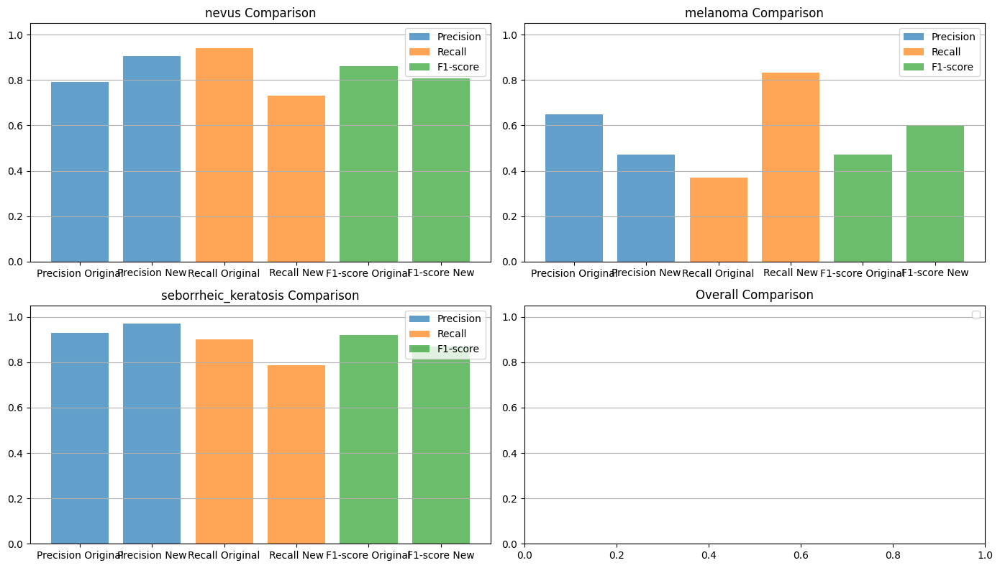


Сравнительная таблица метрик:
                                    Original   New
Class                Metric                       
nevus                Precision         0.790 0.905
                     Recall            0.940 0.731
                     F1-score          0.860 0.809
melanoma             Precision         0.650 0.472
                     Recall            0.370 0.833
                     F1-score          0.470 0.602
seborrheic_keratosis Precision         0.930 0.971
                     Recall            0.900 0.786
                     F1-score          0.920 0.868
Overall              ROC AUC Macro     0.939 0.939
                     ROC AUC Micro     0.955 0.955
                     Accuracy          0.800 0.767


In [8]:
import torch
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import classification_report, roc_auc_score
# Функция для загрузки модели
def load_custom_model(path, device='cpu'):
    """Загрузка модели с метаданными"""
    data = torch.load(path, map_location=device)
    model = HybridDenseNet()
    model.load_state_dict(data['model_state'])
    model.to(device)
    model.eval()
    return model, data
# Функция для определения метрик загруженной модели с измененным порогом для диагностики меланомы
def evaluate_with_threshold(model, loader, device, threshold):
    """Вычисление метрик с применением порога"""
    model.eval()
    y_true, y_pred, y_probs = [], [], []
    
    with torch.no_grad():
        for (images, tabs), labels in loader:
            images, tabs = images.to(device), tabs.to(device)
            outputs = model(images, tabs)
            probs = torch.softmax(outputs, dim=1).cpu().numpy()
            
            for i in range(len(labels)):
                true = labels[i].item()
                if probs[i][1] > threshold:  # Применяем порог только к классу 1
                    pred = 1
                else:
                    pred = np.argmax(probs[i])
                
                y_true.append(true)
                y_pred.append(pred)
                y_probs.append(probs[i])
    
    return y_true, y_pred, np.array(y_probs)

# Конфигурация
save_path = '/home/jupyter/datasphere/project/skin_cancer_model.pth'
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# 1. Загрузка модели и данных
model, model_info = load_custom_model(save_path, device)
loaders = create_loaders()  # Ваша функция создания DataLoader

# 2. Получение метрик с порогом
threshold = model_info['threshold']
y_true_new, y_pred_new, y_probs_new = evaluate_with_threshold(
    model, 
    loaders['valid'], 
    device,
    threshold
)

# 3. Расчет новых метрик
report_new = classification_report(y_true_new, y_pred_new, target_names=model_info['class_names'], output_dict=True)
roc_auc_macro_new = roc_auc_score(y_true_new, y_probs_new, multi_class='ovr', average='macro')
roc_auc_micro_new = roc_auc_score(y_true_new, y_probs_new, multi_class='ovr', average='micro')

# 4. Оригинальные метрики (без порога)
original_metrics = {
    '0': {'precision': 0.79, 'recall': 0.94, 'f1-score': 0.86},
    '1': {'precision': 0.65, 'recall': 0.37, 'f1-score': 0.47},
    '2': {'precision': 0.93, 'recall': 0.90, 'f1-score': 0.92},
    'macro avg': {'precision': 0.79, 'recall': 0.74, 'f1-score': 0.75},
    'weighted avg': {'precision': 0.80, 'recall': 0.81, 'f1-score': 0.80},
    'roc_auc_macro': 0.9392,
    'roc_auc_micro': 0.9552
}

# 5. Создание сравнительной таблицы 
comparison_data = []
for class_name in model_info['class_names']:
    idx = model_info['class_names'].index(class_name)
    original = original_metrics[str(idx)]
    new = report_new[class_name]
    
    comparison_data.extend([
        {'Class': class_name, 'Metric': 'Precision', 'Original': original['precision'], 'New': new['precision']},
        {'Class': class_name, 'Metric': 'Recall', 'Original': original['recall'], 'New': new['recall']},
        {'Class': class_name, 'Metric': 'F1-score', 'Original': original['f1-score'], 'New': new['f1-score']}
    ])

comparison_data.extend([
    {'Class': 'Overall', 'Metric': 'ROC AUC Macro', 'Original': original_metrics['roc_auc_macro'], 'New': roc_auc_macro_new},
    {'Class': 'Overall', 'Metric': 'ROC AUC Micro', 'Original': original_metrics['roc_auc_micro'], 'New': roc_auc_micro_new},
    {'Class': 'Overall', 'Metric': 'Accuracy', 'Original': original_metrics['weighted avg']['precision'], 'New': report_new['accuracy']}
])

df_comparison = pd.DataFrame(comparison_data)

# 6. Визуализация сравнения
plt.figure(figsize=(14, 8))
metrics = ['Precision', 'Recall', 'F1-score']

for i, class_name in enumerate(model_info['class_names'] + ['Overall']):
    plt.subplot(2, 2, i+1)
    subset = df_comparison[df_comparison['Class'] == class_name]
    
    for metric in metrics:
        if class_name == 'Overall' and metric != 'Accuracy': 
            continue
            
        data = subset[subset['Metric'] == metric]
        if not data.empty:
            plt.bar([f"{metric} Original", f"{metric} New"], 
                    [data['Original'].values[0], data['New'].values[0]],
                    alpha=0.7,
                    label=metric)

    plt.title(f'{class_name} Comparison')
    plt.ylim(0, 1.05)
    plt.legend()
    plt.grid(True, axis='y')

plt.tight_layout()
plt.show()

print("\nСравнительная таблица метрик:")
print(df_comparison.pivot(index=['Class', 'Metric'], columns=[], values=['Original', 'New']).to_string(float_format="%.3f"))

Видим, что точность новой модели упала на 3,7%, но при этом полнота диагностики меланомы увеличилась почти на 0,5 - что очень даже приемлемо по возможному количеству спасенных от смерти пациентов. Улучшим визуализацию сравниваемых параметров. 


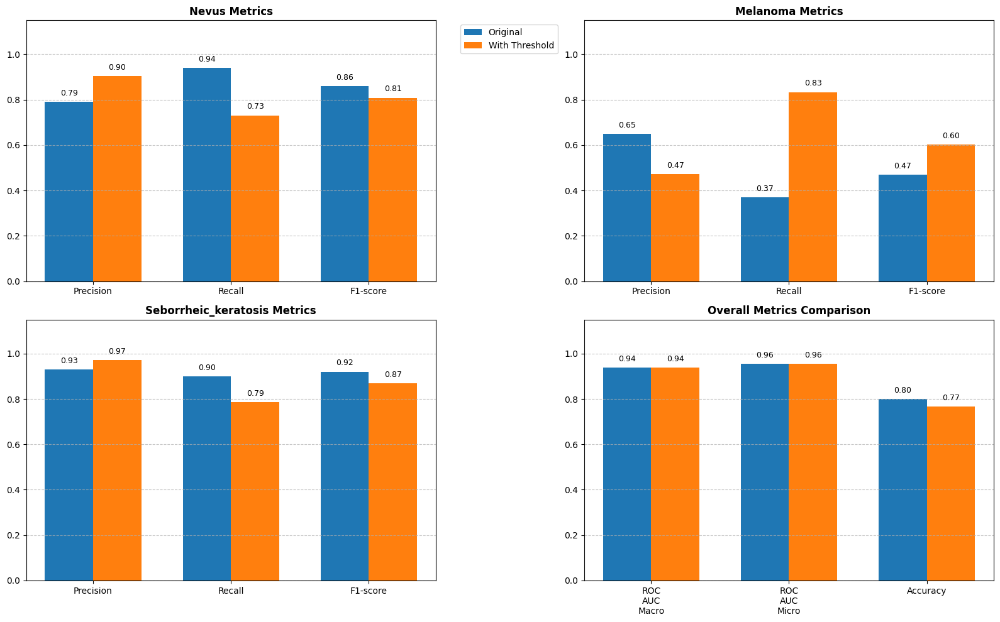

In [9]:
def plot_improved_comparison(df_comparison, class_names):
    plt.figure(figsize=(16, 10))
    
    # 1. Метрики по классам
    for idx, class_name in enumerate(class_names, 1):
        plt.subplot(2, 2, idx)
        class_df = df_comparison[df_comparison['Class'] == class_name]
        
        metrics = ['Precision', 'Recall', 'F1-score']
        original = [class_df[class_df['Metric'] == m]['Original'].values[0] for m in metrics]
        new = [class_df[class_df['Metric'] == m]['New'].values[0] for m in metrics]
        
        x = np.arange(len(metrics))
        width = 0.35
        
        bars1 = plt.bar(x - width/2, original, width, label='Original', color='#1f77b4')
        bars2 = plt.bar(x + width/2, new, width, label='With Threshold', color='#ff7f0e')
        
        plt.title(f'{class_name.capitalize()} Metrics', fontsize=12, fontweight='bold')
        plt.xticks(x, metrics)
        plt.ylim(0, 1.15)
        plt.grid(axis='y', linestyle='--', alpha=0.7)
        
        # Добавляем значения на столбцы
        for bar, val in zip(bars1 + bars2, original + new):
            height = bar.get_height()
            plt.text(bar.get_x() + bar.get_width()/2., height + 0.02,
                     f'{val:.2f}', ha='center', va='bottom', fontsize=9)
        
        if idx == 1:
            plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')

    # 2. Общие метрики
    plt.subplot(2, 2, 4)
    overall_metrics = ['ROC AUC Macro', 'ROC AUC Micro', 'Accuracy']
    original = [df_comparison[(df_comparison['Metric'] == m) & 
                            (df_comparison['Class'] == 'Overall')]['Original'].values[0] 
              for m in overall_metrics]
    new = [df_comparison[(df_comparison['Metric'] == m) & 
                       (df_comparison['Class'] == 'Overall')]['New'].values[0] 
         for m in overall_metrics]
    
    x = np.arange(len(overall_metrics))
    width = 0.35
    
    bars1 = plt.bar(x - width/2, original, width, color='#1f77b4')
    bars2 = plt.bar(x + width/2, new, width, color='#ff7f0e')
    
    plt.title('Overall Metrics Comparison', fontsize=12, fontweight='bold')
    plt.xticks(x, [m.replace(' ', '\n') for m in overall_metrics])
    plt.ylim(0, 1.15)
    plt.grid(axis='y', linestyle='--', alpha=0.7)
    
    # Добавляем значения на столбцы
    for bar, val in zip(bars1 + bars2, original + new):
        height = bar.get_height()
        plt.text(bar.get_x() + bar.get_width()/2., height + 0.02,
                 f'{val:.2f}', ha='center', va='bottom', fontsize=9)

    plt.tight_layout()
    plt.show()

# Вызов функции с данными
plot_improved_comparison(df_comparison, model_info['class_names'])

## 8.2 Выводы


### А. Классическая модель ResNet18 дает низкие метрики на существующем наборе данных (ISIC 2017) фотографий кожных образований - рекомендуется применение предобученных моделей на датасетах с фотографиями кожных заболеваний. Отмечается выраженный underfitting

### Б. Предобученная модель DenseNet 121, использованная в рамках файн-тюнинга, дает метрики существенно выше на существующем наборе данных (ISIC 2017) фотографий кожных образований - рекомендуется применение предобученных моделей на датасетах с фотографиями кожных заболеваний. 
### В. Меланома имеет вариабельную картину на кожных покровах и часто схожа с другими кожными заболеваниями, но несет важную значимость для ее распознавания (жизненно необходимо ее распознавать). Поэтому изменение порога диагностики меланомы для повышения recall обязательно. 

### Г. Повышение порога для меланомы ожидаемо снижает общую точность модели, однако несущественно по сравнению с повышением полноты охвата меланомы, которую мы достигаем.

#### Применение EarlyStopping обязательно для обучения таких моделей из-за высокого риска переобучения - в данном ноутбуке заметно, что при обучении модели (происходило несколько раз) - сначала обучение было остановлено на 14 эпохе из-за возросшего переобучения, затем на 20 эпохе из 20. Увеличение дальнейшего количества эпох нецелесообразно. 